# **ANÁLISIS DESCRIPTIVO Y PREDICTIVO SOBRE LOS TIROTEOS FATALES POR POLICÍAS EN ESTADOS UNIDOS**

---


En los últimos años, los tiroteos fatales realizados por policías en Estados Unidos han generado una atención significativa, debido a su impacto en la sociedad y sus implicaciones en la seguridad pública. La creciente preocupación por los incidentes relacionados con el uso excesivo de la fuerza ha resaltado la necesidad de una comprensión más profunda y detallada de los patrones subyacentes en estos eventos trágicos.

Este proyecto tiene como objetivo identificar qué departamentos de policía en EE.UU. presentan mayores índices de tiroteos fatales. La propuesta se basa en la premisa de que un análisis exhaustivo de datos históricos puede ofrecer insights cruciales para abordar y mitigar estos incidentes. Para ello, se emplearán modelos avanzados de machine learning (ML) que permitirán examinar y entender las variables y factores que contribuyen a la ocurrencia de tiroteos fatales.

Además del análisis descriptivo, se desarrollará un modelo predictivo con el fin de anticipar los departamentos con mayor riesgo de futuros tiroteos fatales. Este enfoque proactivo no solo busca comprender los eventos pasados, sino también prever y prevenir futuros incidentes, ofreciendo una herramienta valiosa para las autoridades y responsables de políticas en la formulación de estrategias de intervención y prevención efectivas.

In [ ]:
#Importación de clases
from google.colab import files
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from mlxtend.frequent_patterns import apriori, association_rules
from imblearn.over_sampling import SMOTE
from sklearn.model_selection import train_test_split
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error

# Cargar las bases de datos
uploaded = files.upload()
data1 = pd.read_excel('fatal-police-shootings-agencies.xlsx')
data2 = pd.read_excel('fatal-police-shootings-data.xlsx')
data3 = pd.read_excel('cities-of-USA-info.xlsx', usecols=['State (full name)','State',' !!Total:'])

Saving cities-of-USA-info.xlsx to cities-of-USA-info.xlsx
Saving fatal-police-shootings-agencies.xlsx to fatal-police-shootings-agencies.xlsx
Saving fatal-police-shootings-data.xlsx to fatal-police-shootings-data.xlsx


## 1. **ANÁLISIS EXPLORATORIO DE LA DATA**

Se realiza un **ajuste entre los conjuntos de datos** que se utilizarán, lo cual implica renombrar algunos atributos para asegurar que los nombres coincidan y así permitir un cruce adecuado. Este paso es clave para que los datos queden correctamente integrados y evitar problemas en los análisis posteriores.  

Luego de integrar los datos, se lleva a cabo una **exploración inicial** para conocer sus características principales. Posteriormente, se generan **gráficos** que ayudan a visualizar la información de manera más clara. Por ejemplo, los *gráficos de dispersión* sirven para detectar patrones o posibles relaciones entre variables, mientras que los *gráficos de barras* permiten observar cómo se distribuyen las categorías de las variables.  

También se crean matrices de correlación para las variables (tanto numéricas como categóricas). Estas matrices ayudan a evaluar la intensidad y dirección de las relaciones entre estas variables, proporcionando información clave para entender cómo interactúan dentro del conjunto de datos y guiar los siguientes pasos del análisis.

In [ ]:
# Renombrar variables de la data
data1.rename(columns={'id': 'agency_id', 'name': 'agency_name'}, inplace=True)
data2.rename(columns={'agency_ids': 'agency_id'}, inplace=True)
data3.rename(columns={'State': 'state', ' !!Total:': 'county population'}, inplace=True)

# Unir los datos
Data = pd.merge(data1, data2, on=["agency_id","state"])
data = pd.merge(Data, data3, on=["state"])

# Eliminar posibles duplicados que tengan los mismos valores en columnas clave
data = data.drop_duplicates(subset=['agency_id', 'state', 'date', 'gender', 'name'])

# Eliminar variables innecesarias
data = data.drop('id', axis=1)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
# Mostrar data por pantalla
print(data)

       agency_id                         agency_name          type state  \
0           3145   Abbeville County Sheriff's Office       sheriff    SC   
46          2576          Aberdeen Police Department  local_police    WA   
85          2114           Abilene Police Department  local_police    TX   
339         2114           Abilene Police Department  local_police    TX   
593         2114           Abilene Police Department  local_police    TX   
...          ...                                 ...           ...   ...   
815880      1360              Yuma Police Department  local_police    AZ   
815895      3077  Zapata County Sheriff's Department       sheriff    TX   
816149        75              Zion Police Department  local_police    IL   
816251        75              Zion Police Department  local_police    IL   
816353        75              Zion Police Department  local_police    IL   

       oricodes  total_shootings       date   threat_type flee_status  \
0       SC0010

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


### **CLASIFICACIÓN DE LAS VARIABLES Y ANÁLISIS UNIVARIADO**

In [ ]:
#1. Clasificación de variables
variable_types = {
    'agency_id': 'Nominal', #Identificador único de la agencia
    'agency_name': 'Nominal', #Nombre de la agencia
    'type': 'Nominal', #Tipo de agencia (sheriff, local_police, etc.)
    'state': 'Nominal', #Estado en el que se encuentra la agencia
    'oricodes': 'Nominal', #Código relacionado con la agencia
    'total_shootings': 'Razón', #Número total de tiroteos
    'date': 'Intervalo', #Fecha del tiroteo
    'threat_type': 'Nominal', #Tipo de amenaza (e.g., point, move)
    'flee_status': 'Nominal', #Estado de fuga (e.g., not, fled)
    'armed_with': 'Nominal', #Tipo de arma con la que estaba armado (e.g., gun, replica)
    'city': 'Nominal', #Ciudad donde ocurrió el tiroteo
    'county': 'Nominal', #Condado donde ocurrió el tiroteo
    'latitude': 'Razón', #Latitud del lugar del tiroteo
    'longitude': 'Razón', #Longitud del lugar del tiroteo
    'location_precision': 'Nominal', #Precisión de la ubicación
    'name': 'Nominal', #Nombre de la persona involucrada
    'age': 'Razón', #Edad de la persona involucrada
    'gender': 'Nominal', #Género de la persona involucrada
    'race': 'Nominal', #Raza de la persona involucrada
    'race_source': 'Nominal', #Fuente de la información sobre la raza
    'was_mental_illness_related': 'Nominal', #Relación del tiroteo con alguna enfermedad mental
    'body_camera': 'Nominal', #Existencia de cámara corporal
    'agency_id': 'Nominal', #Identificador de la agencia
    'state': 'Nominal', #Estado de la agencia
    'State (full name)': 'Nominal', #Nombre completo del estado
    'county population': 'Razón' #Población total del condado
}

print("Clasificación de Variables:")
for var, tipo in variable_types.items():
    print(f"{var}: {tipo}")

#2. Análisis univariado: resumen descriptivo de las variables numéricas
print("")
summary = data.describe()
print(summary)

Clasificación de Variables:
agency_id: Nominal
agency_name: Nominal
type: Nominal
state: Nominal
oricodes: Nominal
total_shootings: Razón
date: Intervalo
threat_type: Nominal
flee_status: Nominal
armed_with: Nominal
city: Nominal
county: Nominal
latitude: Razón
longitude: Razón
location_precision: Nominal
name: Nominal
age: Razón
gender: Nominal
race: Nominal
race_source: Nominal
was_mental_illness_related: Nominal
body_camera: Nominal
State (full name): Nominal
county population: Razón

       total_shootings                           date     latitude  \
count      9386.000000                           9386  8384.000000   
mean         19.308758  2020-01-18 22:35:27.935222528    36.509600   
min           1.000000            2015-01-02 00:00:00    19.497503   
25%           2.000000            2017-08-11 00:00:00    33.414812   
50%           6.000000            2020-02-10 00:00:00    35.881957   
75%          23.000000            2022-07-15 00:00:00    39.988472   
max         142.0

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
# Definición de variables a eliminar
data = data.drop(['type','oricodes','city','latitude','longitude','location_precision','race_source','body_camera', 'name'], axis=1)

# Eliminación de datos nulos
data = data.dropna()

# Frecuencia de variables categóricas
categorical_columns = ['agency_name', 'state', 'threat_type', 'flee_status',
                       'armed_with', 'county', 'gender', 'race',
                       'was_mental_illness_related', 'State (full name)']

print("")
for col in categorical_columns:
    print(f"\nFrecuencia de {col}:\n", data[col].value_counts())

#Convertir fecha a formato fecha (aseguramiento de los datos)
data['date'] = pd.to_datetime(data['date'], errors='coerce')

#Crear una nueva columna con el año, para generar las gráficas
data['year'] = data['date'].dt.year

# Eliminar variable 'date'
data = data.drop('date', axis=1)

# Frecuencia de variables numéricas
numerical_columns = ['agency_id','year','age', 'county population','total_shootings']

print("")
for col in numerical_columns:
    print(f"\nFrecuencia de {col}:\n", data[col].value_counts())



Frecuencia de agency_name:
 agency_name
Los Angeles Police Department              85
Phoenix Police Department                  56
Los Angeles County Sheriff's Department    50
New York Police Department                 43
Houston Police Department                  43
                                           ..
Millbrook Police Department                 1
Mille Lacs County Sheriff's Office          1
Milton Police Department                    1
Milwaukee County Sheriff's Department       1
Logan County Sheriff's Department           1
Name: count, Length: 1634, dtype: int64

Frecuencia de state:
 state
CA    587
TX    499
FL    257
AZ    174
GA    149
CO    136
NC    135
OH    127
TN     99
OK     99
VA     96
MO     94
IL     86
NY     86
PA     84
IN     81
AL     77
WA     75
LA     75
SC     72
NM     70
NV     66
KY     64
MI     62
WI     60
MS     51
OR     48
MD     45
UT     42
MN     41
NJ     38
AR     37
KS     31
ID     28
IA     24
MA     24
AK     21
MT     20
ME 

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


<class 'pandas.core.frame.DataFrame'>
Index: 3967 entries, 593 to 816251
Data columns (total 15 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   agency_id                   3967 non-null   object 
 1   agency_name                 3967 non-null   object 
 2   state                       3967 non-null   object 
 3   total_shootings             3967 non-null   int64  
 4   threat_type                 3967 non-null   object 
 5   flee_status                 3967 non-null   object 
 6   armed_with                  3967 non-null   object 
 7   county                      3967 non-null   object 
 8   age                         3967 non-null   float64
 9   gender                      3967 non-null   object 
 10  race                        3967 non-null   object 
 11  was_mental_illness_related  3967 non-null   bool   
 12  State (full name)           3967 non-null   object 
 13  county population           3967 n

<ipython-input-6-68e3f2c794ea>:14: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x=column, data=data, palette='Set2')


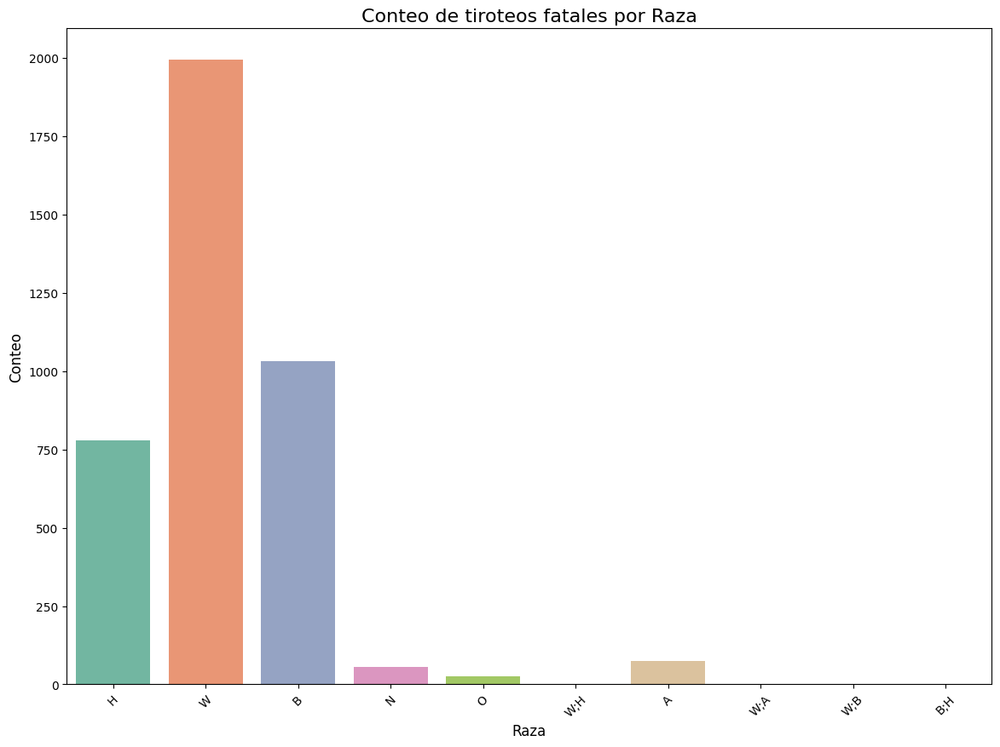

<ipython-input-6-68e3f2c794ea>:14: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x=column, data=data, palette='Set2')


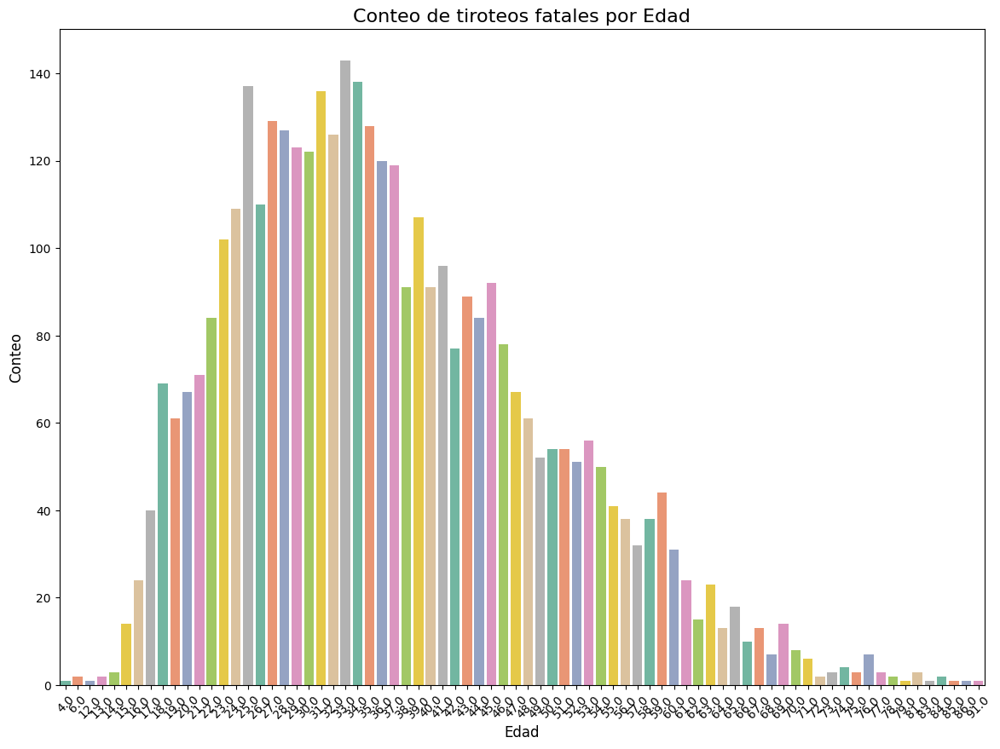

<ipython-input-6-68e3f2c794ea>:14: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x=column, data=data, palette='Set2')


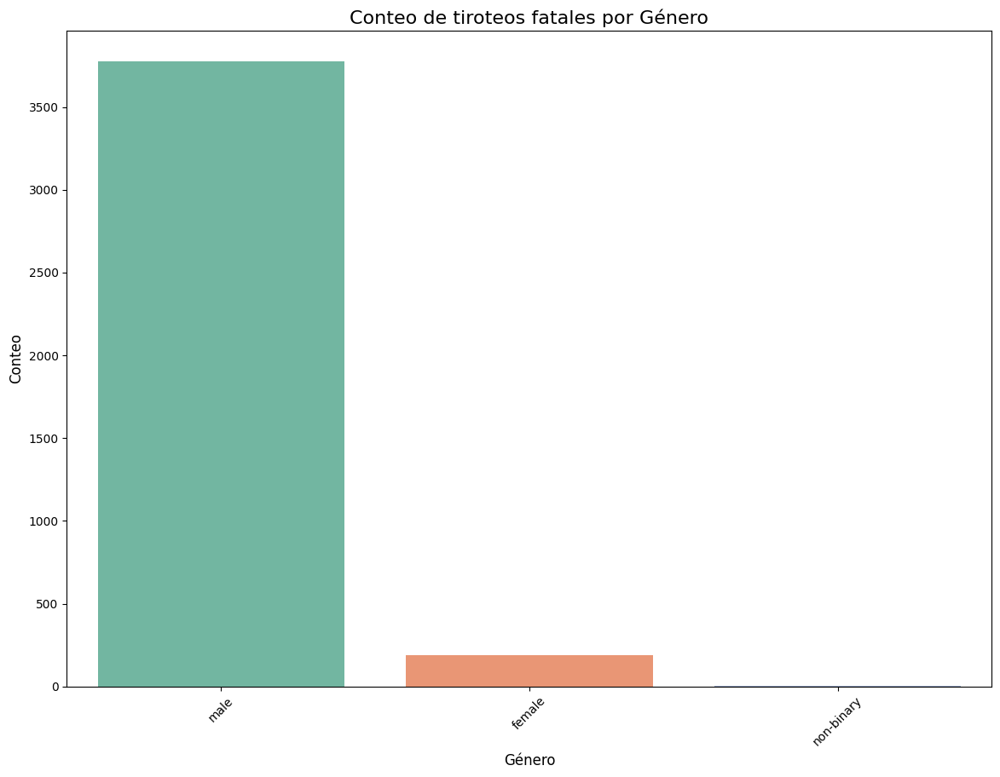

<ipython-input-6-68e3f2c794ea>:14: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x=column, data=data, palette='Set2')


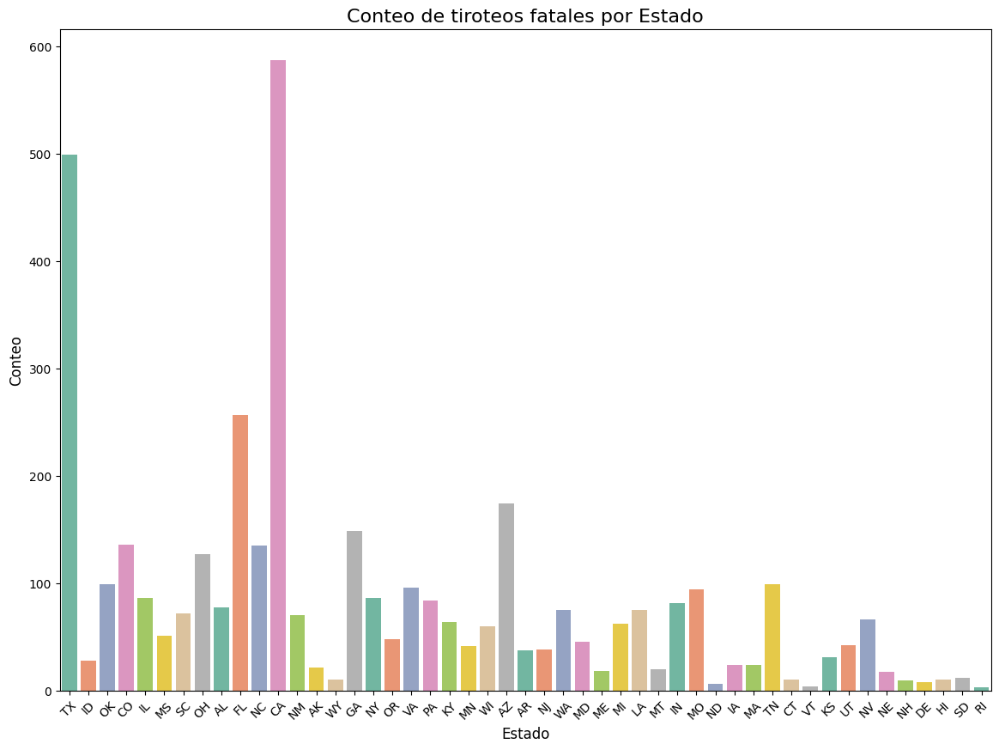

<ipython-input-6-68e3f2c794ea>:27: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=shootings_per_year.index, y=shootings_per_year.values, palette='Set2')


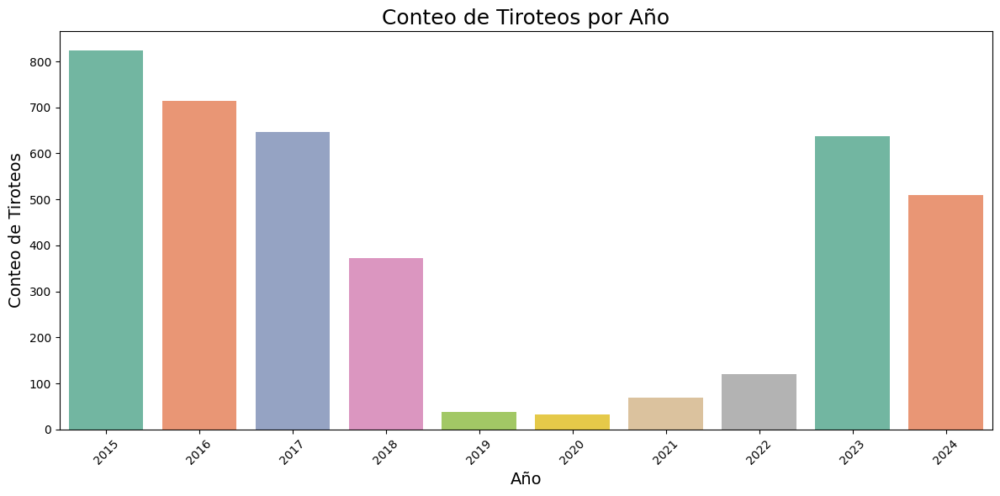

In [ ]:
#GRÁFICAS DE BARRAS (considerando el estado de la data actual)
data_info = data.info()
print(data_info)
print(data.head(20))

# Verificar los valores únicos en la columna 'state'
print("Valores únicos en la columna 'state':")
print(data['state'].value_counts())

# Función para crear gráficos de barras para cualquier columna categórica
def plot_category_count(data, column, title):
    if column in data.columns:
        plt.figure(figsize=(14, 10))
        sns.countplot(x=column, data=data, palette='Set2')
        plt.title(f'Conteo de tiroteos fatales por {title}', fontsize=16)
        plt.xlabel(title, fontsize=12)
        plt.ylabel('Conteo', fontsize=12)
        plt.xticks(rotation=45)
        plt.show()
    else:
        print(f"La columna '{column}' no se encuentra en el DataFrame.")

#Función para agregar una variable de 'año' en el dataframe
def plot_shootings_per_year(data):
    shootings_per_year = data['year'].value_counts().sort_index()
    plt.figure(figsize=(12, 6))
    sns.barplot(x=shootings_per_year.index, y=shootings_per_year.values, palette='Set2')
    plt.title('Conteo de Tiroteos por Año', fontsize=18)
    plt.xlabel('Año', fontsize=14)
    plt.ylabel('Conteo de Tiroteos', fontsize=14)
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

numerical_columns = ['agency_id','year','age','county population']

#Gráfico 1: Conteo de tiroteos fatales por raza
plot_category_count(data, 'race', 'Raza')

#Gráfico 2: Conteo de tiroteos fatales por edad
plot_category_count(data, 'age', 'Edad')

#Gráfico 3: Conteo de tiroteos fatales por género
plot_category_count(data, 'gender', 'Género')

#Gráfico 4: Conteo de tiroteos fatales por estados
plot_category_count(data, 'state', 'Estado')

#Gráfico 5: Conteo de tiroteos fatales por año
plot_shootings_per_year(data)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
<ipython-input-7-d5c37375e023>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x=category_column, y=value_column, data=data, palette='Set2')


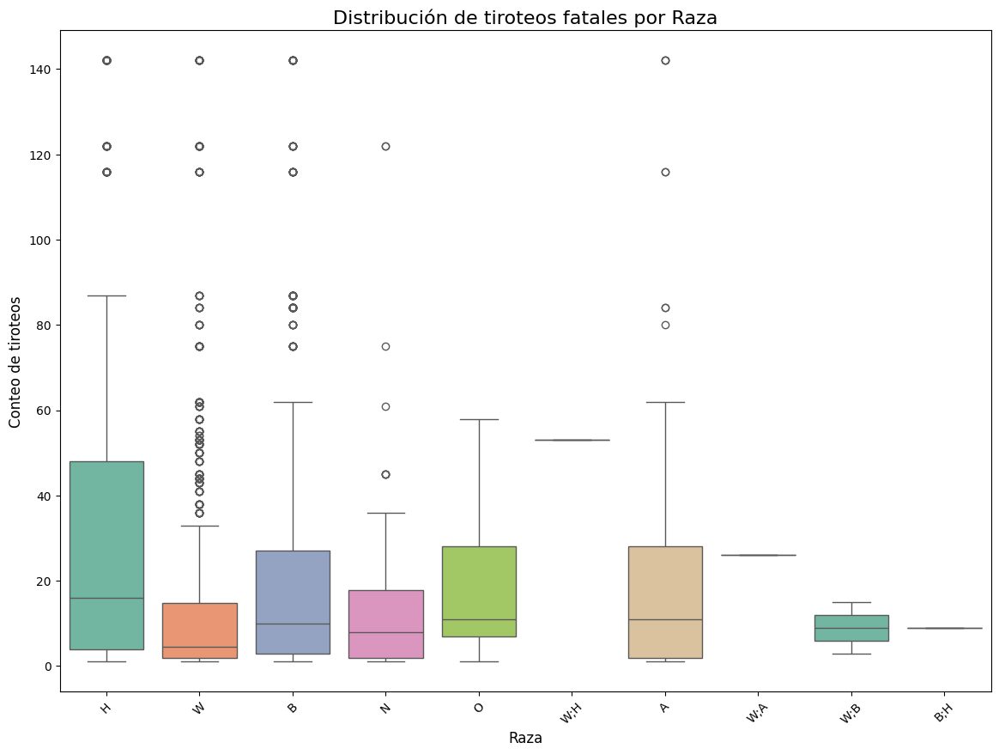

<ipython-input-7-d5c37375e023>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x=category_column, y=value_column, data=data, palette='Set2')


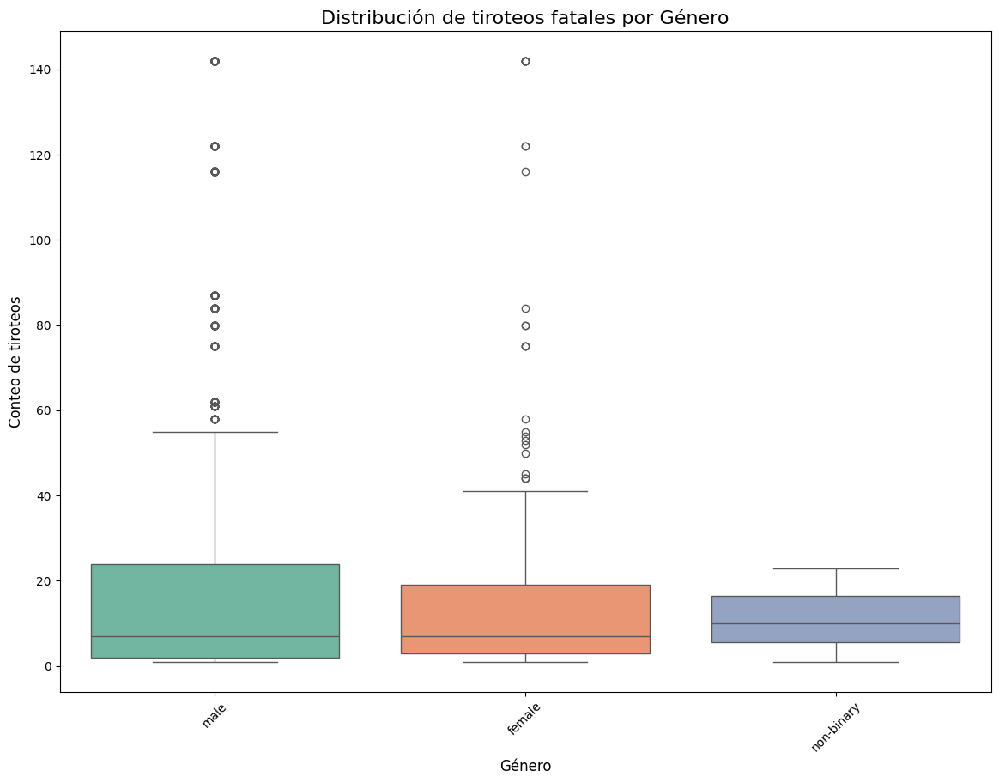

<ipython-input-7-d5c37375e023>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x=category_column, y=value_column, data=data, palette='Set2')


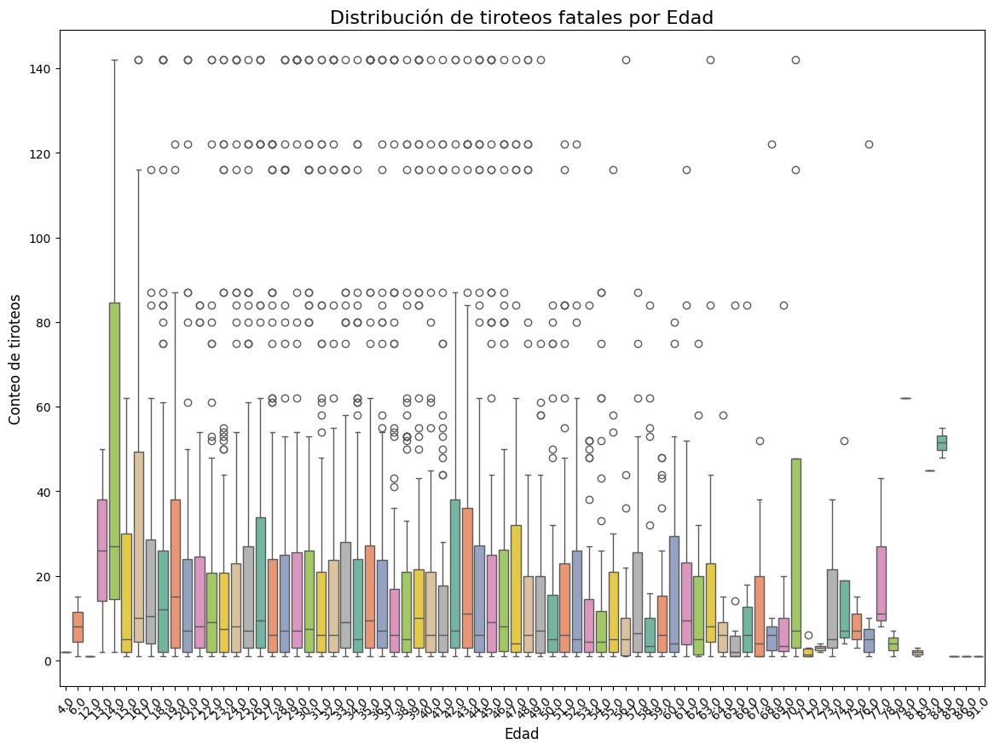

<ipython-input-7-d5c37375e023>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x=category_column, y=value_column, data=data, palette='Set2')


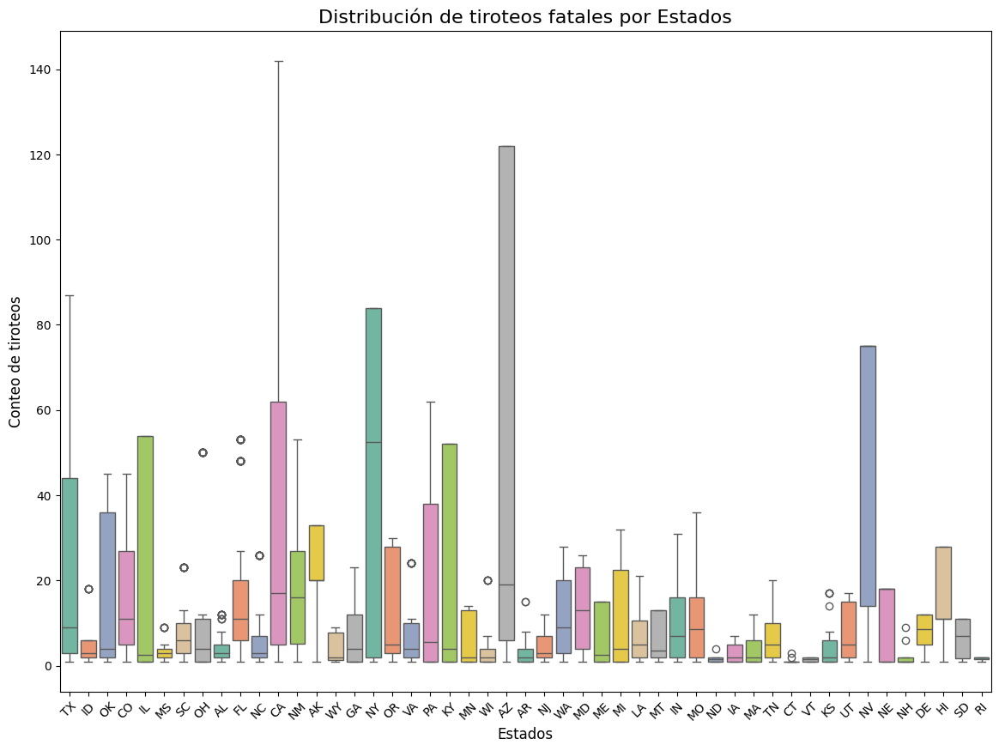

In [ ]:
#GRÁFICAS BOXPLOT (considerando el estado de la data actual)
def boxplot_category_count(data, category_column, value_column, title):
    if category_column in data.columns and value_column in data.columns:
        plt.figure(figsize=(14, 10))
        sns.boxplot(x=category_column, y=value_column, data=data, palette='Set2')
        plt.title(f'Distribución de tiroteos fatales por {title}', fontsize=16)
        plt.xlabel(title, fontsize=12)
        plt.ylabel(f'Conteo de tiroteos', fontsize=12)
        plt.xticks(rotation=45)
        plt.show()
    else:
        print(f"Una de las columnas '{category_column}' o '{value_column}' no se encuentra en el DataFrame.")

#GRÁFICA 1: Conteo de tiroteos por raza
boxplot_category_count(data,'race','total_shootings','Raza')

#GRÁFICA 2: Conteo de tiroteos por género
boxplot_category_count(data,'gender','total_shootings','Género')

#GRÁFICA 3: Conteo de tiroteos por edad
boxplot_category_count(data,'age','total_shootings','Edad')

#GRÁFICA 4: Conteo de tiroteos por estado
boxplot_category_count(data,'state','total_shootings','Estados')

### **AGRUPACIÓN DE DATOS**

In [ ]:
# Definir los rangos de edad y las etiquetas correspondientes
bins = [0, 12, 18, 30, 65, 100]  # Rangos: 0-12 (niños), 13-18 (adolescentes), 19-30 (adulto joven), 31-65 (adulto), 66-100 (adulto mayor)
labels = ['child', 'adolescent', 'young adult', 'adult', 'major adult']

# Crear una nueva columna en el DataFrame con las categorías de edad
data['etary group'] = pd.cut(data['age'], bins=bins, labels=labels, right=False)

# Eliminar la variable 'age'
data = data.drop('age', axis=1)

# Mostrar data por pantalla
print(data)

       agency_id                       agency_name state  total_shootings  \
593         2114         Abilene Police Department    TX                8   
1101        2114         Abilene Police Department    TX                8   
1355        2114         Abilene Police Department    TX                8   
1609        2114         Abilene Police Department    TX                8   
1863        2114         Abilene Police Department    TX                8   
...          ...                               ...   ...              ...   
815790      1874  Yuma County Sheriff's Department    AZ                3   
815835      1360            Yuma Police Department    AZ                4   
815850      1360            Yuma Police Department    AZ                4   
816149        75            Zion Police Department    IL                3   
816251        75            Zion Police Department    IL                3   

       threat_type flee_status armed_with  county  gender race  \
593      

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
<ipython-input-6-68e3f2c794ea>:14: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x=column, data=data, palette='Set2')


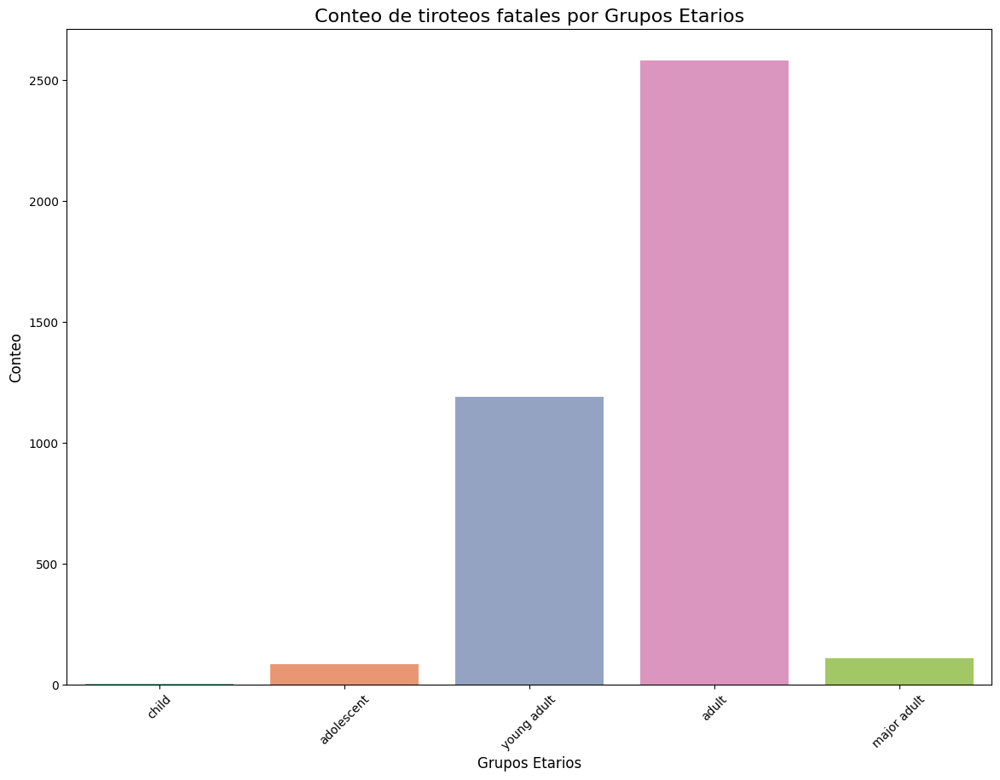

<ipython-input-7-d5c37375e023>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x=category_column, y=value_column, data=data, palette='Set2')


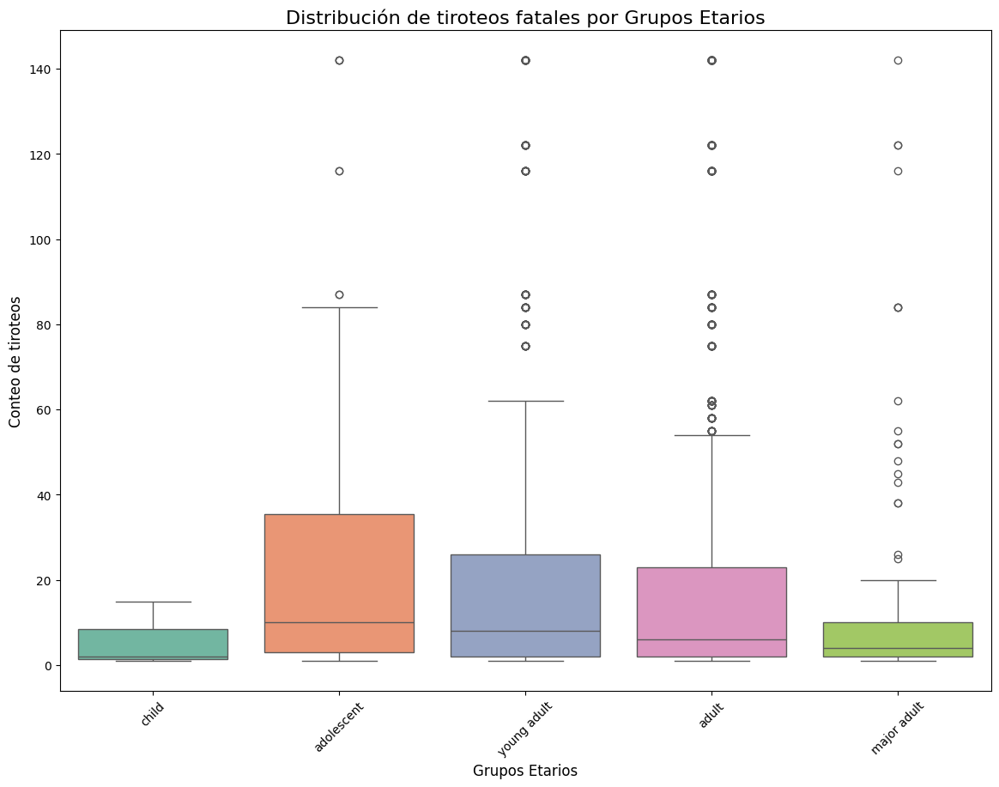

In [ ]:
# Gráficos de barras de los grupos etarios
plot_category_count(data,'etary group','Grupos Etarios')

# Boxplot de los grupos etarios
boxplot_category_count(data, 'etary group', 'total_shootings','Grupos Etarios')

### **ANÁLISIS DE FACTORES CONTRIBUTIVOS: Causas subyacentes**

En Estados Unidos, la violencia y la pobreza se han manifestado como desafíos persistentes, exhibiendo amplias disparidades geográficas y afectando de manera diversa a la población. La capital, Washington D.C., se posicionó en 2020 como el territorio con la mayor tasa de delitos violentos, alcanzando cifras que superan por mucho el promedio nacional. Este fenómeno de concentración de criminalidad resalta la necesidad de enfoques específicos en políticas de seguridad, adaptados a las particularidades de cada región.

Simultáneamente, los datos de la Oficina de Censos (CB) evidencian una desigualdad económica profunda en el país. Estados como Mississippi, Louisiana y West Virginia presentan tasas de pobreza considerablemente elevadas, acompañadas de ingresos familiares bajos y limitaciones en el acceso a servicios básicos. En contraste, estados como Maine y New Hampshire muestran menores niveles de pobreza, revelando una disparidad socioeconómica que refuerza la importancia de estrategias de inversión social y programas focalizados.

Por lo tanto, estos factores serían importantes en el análisis porque contribuirían en un aumento de los tiroteos policiales fatales en un departamento de policía, un condado o un estado.

#### ***DELITOS VIOLENTOS EN EE.UU***
En 2020, Washington D.C. fue el territorio con la mayor tasa de delitos violentos en Estados Unidos, con 999,8 incidentes por cada 100,000 habitantes, según el FBI. Esto representa una tasa casi 10 veces mayor que la de Maine, el estado con la menor incidencia de delitos (108,6 por cada 100,000 habitantes). Los delitos violentos incluyen homicidios, violaciones, robos y asaltos agravados, crímenes definidos por el FBI como aquellos que implican el uso o la amenaza de fuerza.

La tasa promedio nacional de delitos violentos en 2020 fue de 398,5 por cada 100,000 habitantes, ligeramente superior a la de 2019 (380,8). Veintitrés estados y Washington D.C. superaron esta media, destacando la capital con una incidencia de delitos violentos que supera el doble del promedio nacional. Tras Washington, los estados con mayor tasa de delitos fueron Alaska (837,8), Nuevo México, Tennessee y Arkansas. Sin embargo, estos estados presentan cifras significativamente menores en comparación con la capital.

En el extremo opuesto, Maine, Nueva Hampshire, Vermont, Connecticut y Nueva Jersey tuvieron las tasas más bajas de delitos violentos, reflejando una gran disparidad regional en cuanto a la incidencia de este tipo de crímenes.

La significativa diferencia en las tasas de delitos violentos entre Washington D.C. y otros estados revela una concentración de criminalidad en la capital que supera ampliamente el promedio nacional. Este fenómeno subraya la necesidad de políticas de seguridad adaptadas a los contextos específicos de cada región, en especial en áreas con altos índices de criminalidad.

Fuente: (CNN, 2022)

#### ***NIVEL DE POBREZA EN LOS ESTADOS***
La pobreza en Estados Unidos es una problemática compleja, impulsada por factores económicos, sociales y políticos. De acuerdo con el último reporte de la Oficina de Censos (CB), la tasa de pobreza en el país alcanza un 12.8%, con un ingreso familiar promedio de $74,755. Sin embargo, existen grandes disparidades entre los estados, destacándose algunos con índices de pobreza y desigualdad mucho más elevados que el promedio nacional.

El estado más pobre del país es Mississippi, con una tasa de pobreza del 19.1% y un ingreso medio de $52,719, lo que impacta gravemente en la calidad de vida, especialmente en educación y salud. Le siguen Louisiana y West Virginia, con tasas de pobreza de 18.6% y 17.9% respectivamente. En el otro extremo, Maine y New Hampshire figuran entre los estados con menos pobreza. En general, los estados más pobres también registran altos índices de pobreza infantil, desempleo, y falta de acceso a servicios básicos.

Estos datos revelan una fuerte desigualdad económica en Estados Unidos, con ciertas regiones enfrentando desafíos estructurales en educación, salud y empleo. Las elevadas tasas de pobreza en estos estados subrayan la necesidad de políticas focalizadas y esfuerzos de inversión en infraestructura social para promover una mayor equidad en la distribución de los recursos y oportunidades.

Fuente: (Créditos en USA, 2024)

#### ***RACISMO: Discriminación y estereotipos***

El análisis de factores contributivos revela desigualdades significativas en varios aspectos socioeconómicos entre las comunidades afroamericanas y blancas en Estados Unidos. En 2016, la brecha patrimonial era alarmante, con un patrimonio promedio de las familias blancas que era casi siete veces superior al de las familias negras. Esta disparidad no solo es un reflejo de las diferencias en la acumulación de activos, como propiedades y ahorros, sino también de la herencia, que representa un porcentaje considerable de los ingresos familiares.

A pesar de las mejoras económicas desde la década de 1960, como una reducción en la tasa de pobreza entre los afroamericanos—que en 2018 fue del 20,8%—la pobreza sigue afectando a millones de personas. La educación superior ha visto progresos, con un aumento en la tasa de graduación entre afroamericanos, alcanzando un 26% en 2019, pero la disparidad en los salarios persiste. El ingreso promedio de los hogares negros es aproximadamente el 60% del ingreso de los hogares blancos, una brecha que se ha mantenido constante durante décadas.

La representación política también ha evolucionado, con un aumento en el número de afroamericanos en el Congreso, que alcanzó su cifra más alta en la historia reciente. A medida que se ha ampliado el acceso al voto y se han promovido los derechos civiles, el número de legisladores afroamericanos ha crecido significativamente.

### **ANÁLISIS DE FACTORES CRÍTICOS**

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


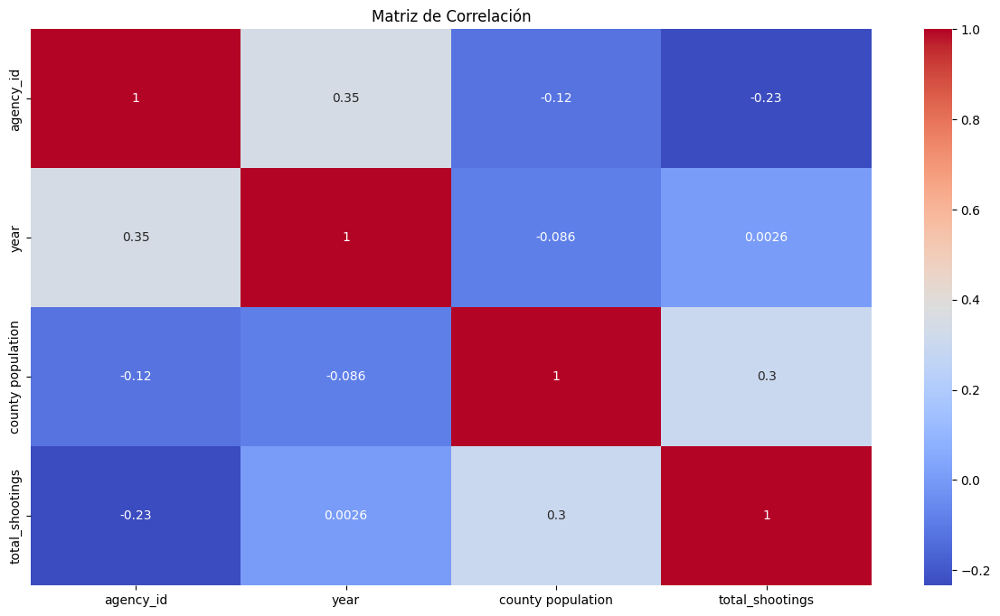

In [ ]:
# Exploración de correlación para variables numéricas
numerical_columns = ['agency_id','year','county population','total_shootings']

plt.figure(figsize=(15,8))
sns.heatmap(data[numerical_columns].corr(), annot=True, cmap='coolwarm')
plt.title("Matriz de Correlación")
plt.show()

La matriz de correlación indica las relaciones entre distintas variables y `total_shootings`. Observando específicamente esta variable, se observa una correlación negativa moderada con `agency_id` (-0.23). Esto sugiere que diferentes agencias pueden presentar variabilidad en el número de tiroteos registrados, posiblemente debido a factores específicos de cada agencia, como prácticas internas o contextos locales, que influyen en la frecuencia de estos incidentes.

En cuanto a la variable `year`, la correlación es casi nula (-0.0026) con `total_shootings`. Esto indica que la fecha de registro no tiene un impacto significativo en la cantidad de tiroteos, sugiriendo que los incidentes de tiroteos no siguen un patrón temporal claro en este conjunto de datos.

Por último, la `county population` tiene una correlación positiva débil con `total_shootings` (0.3). Aunque la relación no es fuerte, sugiere que los condados con poblaciones más grandes tienden a registrar más incidentes de tiroteos, lo cual podría explicarse por una mayor densidad de población y, posiblemente, un mayor número de interacciones que pueden resultar en incidentes de este tipo.

Por lo anterior, podemos establecer que ninguna de las variables analizadas muestra una correlación fuerte con el total de tiroteos fatales (`total_shootings`). Sin embargo, se observa una leve asociación positiva con la población del condado y una moderada asociación negativa con el ID de la agencia, lo que podría reflejar patrones específicos en ciertos contextos geográficos y administrativos (presencia de sesgos en algunos departamentos de policía).

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


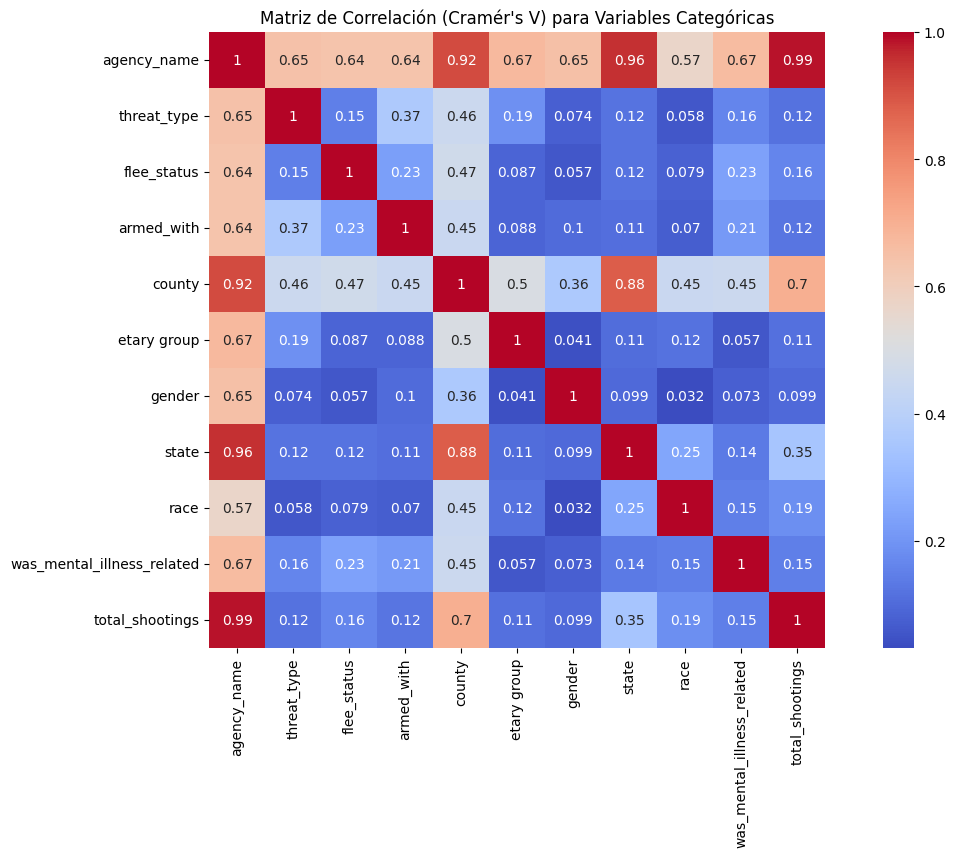

In [ ]:
from scipy.stats import chi2_contingency

# Función para calcular el coeficiente de Cramér entre dos variables categóricas
def cramers_v(x, y):
    contingency_table = pd.crosstab(x, y)
    chi2 = chi2_contingency(contingency_table)[0]
    n = contingency_table.sum().sum()
    r, k = contingency_table.shape
    return np.sqrt(chi2 / (n * (min(r, k) - 1)))

# Definir las columnas a analizar
columns = ['agency_name', 'threat_type', 'flee_status', 'armed_with', 'county',
                'etary group','gender', 'state', 'race','was_mental_illness_related']
columns = columns + ['total_shootings']

# Crear una matriz vacía para almacenar los valores de Cramér's V
correlation_matrix = pd.DataFrame(np.zeros((len(columns), len(columns))),
                                  index=columns, columns=columns)

# Rellenar la matriz con los valores de Cramér's V
for i in range(len(columns)):
    for j in range(i, len(columns)):
        if i == j:
            correlation_matrix.iloc[i, j] = 1.0  # Diagonal principal con 1's
        else:
            v = cramers_v(data[columns[i]], data[columns[j]])
            correlation_matrix.iloc[i, j] = v
            correlation_matrix.iloc[j, i] = v

# Visualizar la matriz de correlación con un mapa de calor
plt.figure(figsize=(15,8))
sns.heatmap(correlation_matrix, annot=True, cmap="coolwarm", square=True)
plt.title("Matriz de Correlación (Cramér's V) para Variables Categóricas")
plt.show()

La matriz de correlación muestra relaciones interesantes entre las variables categóricas y la variable numérica `"total_shootings"` en tu conjunto de datos. Las asociaciones más fuertes se observan entre `"agency_name"`, `"county"`, y `"state"`. Estas variables, relacionadas con la ubicación y jurisdicción, muestran una alta correlación entre sí, casi llegando a 1. Esto es esperable, ya que el nombre de la agencia policial y el estado están directamente vinculados a la región geográfica, y podría indicar redundancia en la información proporcionada por estas variables.

La correlación entre `"total_shootings"` y `"agency_name"` es particularmente alta, alcanzando un valor de 0.99. Esto sugiere que el número total de tiroteos está estrechamente asociado con la agencia, posiblemente porque algunas agencias se encuentran en áreas con mayores índices de violencia o en regiones más pobladas, lo cual influye en la cantidad de incidentes reportados. De manera similar, la variable `"county"` también presenta una correlación significativa de 0.7 con `"total_shootings"`, lo que resalta que el número de tiroteos también depende del condado donde ocurren, una relación lógica dada la influencia directa de la jurisdicción local en estos eventos.

En contraste, variables como `"gender"`, `"threat_type"`, `"armed_with"`, y `"race"` presentan correlaciones bajas con `"total_shootings"` (valores menores a 0.2). Esto sugiere que estas características individuales no tienen una relación fuerte con la variación en el número de tiroteos. Estos factores específicos, por tanto, parecen ser menos determinantes en la variación de `"total_shootings"` en este conjunto de datos, lo que puede indicar que la ubicación tiene mayor peso que las características personales en el número de incidentes.

La baja correlación entre `"etary group"` y `"total_shootings"` (0,11) sugiere una relación débil entre los grupos etarios y la cantidad de incidentes de disparos, lo cual indica que esta variable podría tener una influencia limitada en las predicciones de `"total_shootings"` en comparación con otras variables más correlacionadas. Sin embargo, una correlación baja no necesariamente implica que `"etary group"` no aporte valor; en algunos casos, una variable puede resultar útil cuando interactúa con otras o en modelos no lineales.

Además, se observa que la variable `"was_mental_illness_related"` tiene correlaciones bajas tanto con `"total_shootings"` (0.15) como con la mayoría de las demás variables. Esto podría implicar que los casos relacionados con enfermedades mentales no tienen asociaciones fuertes con otros factores en los datos, representando un subconjunto específico que no depende de las características principales asociadas a los tiroteos.

Finalmente, las correlaciones entre otras variables, como `"flee_status"`, `"gender"`, y `"armed_with"`, son también bajas entre sí y con otras variables en el conjunto de datos. Esto sugiere que estos factores tienen menor relación entre sí y podrían representar características independientes de cada caso.

Por todo lo anterior, podemos establecer que los resultados indican que las variables geográficas (como el nombre de la agencia, el condado y el estado) tienen una mayor asociación con `"total_shootings"`, sugiriendo que la ubicación geográfica es un factor clave en la cantidad de tiroteos. Las características individuales de los incidentes, en cambio, muestran correlaciones bajas, lo que sugiere que tienen un efecto menos predecible sobre el número total de tiroteos.

### **CONCLUSIONES: Análisis de factores contributivos y críticos del país**

La relación entre los delitos violentos y las tasas de pobreza en Estados Unidos es un factor clave que también se refleja en los resultados obtenidos de las matrices de correlación en el análisis de tiroteos policiales fatales. Las tasas de pobreza elevadas en ciertos estados y la concentración de delitos violentos en regiones específicas sugieren un contexto estructural que puede predisponer a un incremento en los incidentes de violencia y, potencialmente, en la frecuencia de tiroteos policiales.

El análisis de factores contribuye a evidenciar las desigualdades marcadas que existen en diversos aspectos socioeconómicos entre las comunidades afroamericanas y blancas en Estados Unidos. A pesar de los avances económicos logrados desde la década de 1960, como la reducción de la tasa de pobreza entre los afroamericanos, la pobreza continúa afectando a millones de personas. Aunque se han registrado progresos en la educación superior, la disparidad salarial sigue siendo un problema persistente, con el ingreso promedio de los hogares negros representando apenas el 60% del ingreso de los hogares blancos.

Por otro lado, la representación política ha mostrado avances significativos, con un incremento en el número de afroamericanos en el Congreso, alcanzando niveles históricos. Este crecimiento es resultado de la ampliación del acceso al voto y la promoción de los derechos civiles, lo que ha facilitado una mayor participación de legisladores afroamericanos en la política. Sin embargo, a pesar de estos logros, las desigualdades estructurales persisten, afectando la capacidad de las comunidades afroamericanas para alcanzar la igualdad económica y social.

En el análisis de correlación, se observa que las variables geográficas y de jurisdicción, como `"agency_name"` y `"county"` muestran correlaciones significativas con la variable "total_shootings." Esto indica que ciertas agencias y condados registran un mayor número de incidentes, probablemente porque operan en áreas donde la violencia y la pobreza son predominantes. Por ejemplo, Washington D.C., que lidera en tasas de delitos violentos, y estados como Mississippi y Louisiana, con altos índices de pobreza, representan contextos de alta vulnerabilidad que pueden incrementar la frecuencia de interacciones policiales y, consecuentemente, los tiroteos.

En el análisis de correlación, se observa que las variables geográficas y de jurisdicción, como `"agency_name"` y `"county"`, tienen correlaciones significativas con la variable `"total_shootings"`. Esto indica que ciertas agencias y condados registran un mayor número de incidentes, probablemente porque operan en áreas donde la violencia y la pobreza son predominantes. Este patrón se refleja en estados con altos números de tiroteos reportados, como California (1.333), Texas (923), y Florida (627), donde las grandes poblaciones y las disparidades socioeconómicas podrían influir en el número elevado de interacciones policiales que resultan en incidentes fatales. Además, estados como Arizona y Georgia, con 435 y 359 incidentes respectivamente, también reflejan cómo la ubicación puede impactar la frecuencia

Además, la correlación alta entre `"agency_name"` y `"total_shootings"` (0.98) sugiere que algunas agencias en áreas específicas están más expuestas a contextos de mayor violencia o desigualdad socioeconómica, lo cual se relaciona con los datos socioeconómicos generales de pobreza y criminalidad. La relación positiva moderada entre `"county"` y `"total_shootings"` (0.68) también reafirma la importancia de la ubicación geográfica: en condados más pobres y violentos, es probable que existan más incidentes de tiroteos, subrayando la conexión entre estos factores estructurales y la incidencia de estos eventos.

Por otro lado, las bajas correlaciones entre `"total_shootings"` y variables demográficas como `"gender"`, `"threat_type"`, `"armed_with"` y `"race"` reflejan que, a pesar de las características personales, el entorno en el que se sitúan los departamentos de policía parece tener una mayor influencia en la frecuencia de incidentes violentos. Esto coincide con el hecho de que las áreas con alta pobreza y violencia, debido a desafíos estructurales, pueden llevar a interacciones más frecuentes y tensas con las fuerzas del orden, contribuyendo así a un mayor número de incidentes registrados en dichos contextos.

Por consiguiente, establecemos que las matrices de correlación respaldan la relación entre los factores de pobreza, violencia y la incidencia de tiroteos policiales, sugiriendo que las políticas deben enfocarse no solo en las prácticas policiales, sino también en la reducción de las desigualdades estructurales que amplifican estos problemas en ciertas regiones.

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


              year  county population  total_shootings
count  3967.000000       3.967000e+03      3967.000000
mean   2018.628687       3.472954e+05        20.837409
std       3.418899       5.749301e+05        31.616549
min    2015.000000       2.200000e+03         1.000000
25%    2016.000000       2.551600e+04         2.000000
50%    2017.000000       5.792200e+04         7.000000
75%    2023.000000       2.784680e+05        24.000000
max    2024.000000       1.682353e+06       142.000000


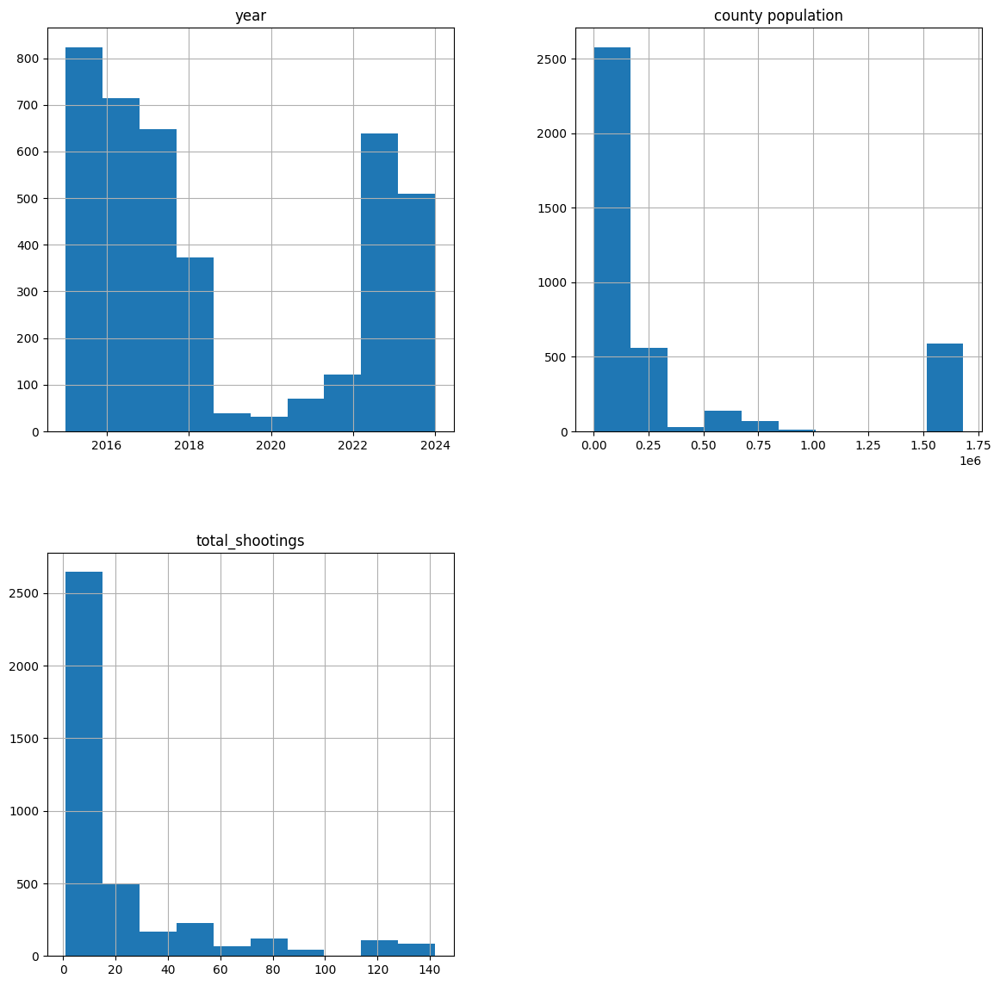

In [ ]:
#Revisar datos estadísticos
print(data[numerical_columns].describe())

# Crear histogramas de la data
data[numerical_columns].hist(figsize=(14,14))
plt.show()

In [ ]:
#Mostrar por pantalla los porcentajes de cada variable categórica
for i in categorical_columns:
    print(data[i].value_counts(normalize=True))
    print('*'*40)

agency_name
Los Angeles Police Department              0.021427
Phoenix Police Department                  0.014116
Los Angeles County Sheriff's Department    0.012604
New York Police Department                 0.010839
Houston Police Department                  0.010839
                                             ...   
Millbrook Police Department                0.000252
Mille Lacs County Sheriff's Office         0.000252
Milton Police Department                   0.000252
Milwaukee County Sheriff's Department      0.000252
Logan County Sheriff's Department          0.000252
Name: proportion, Length: 1634, dtype: float64
****************************************
state
CA    0.147971
TX    0.125788
FL    0.064784
AZ    0.043862
GA    0.037560
CO    0.034283
NC    0.034031
OH    0.032014
TN    0.024956
OK    0.024956
VA    0.024200
MO    0.023695
IL    0.021679
NY    0.021679
PA    0.021175
IN    0.020418
AL    0.019410
WA    0.018906
LA    0.018906
SC    0.018150
NM    0.017646
NV    0

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


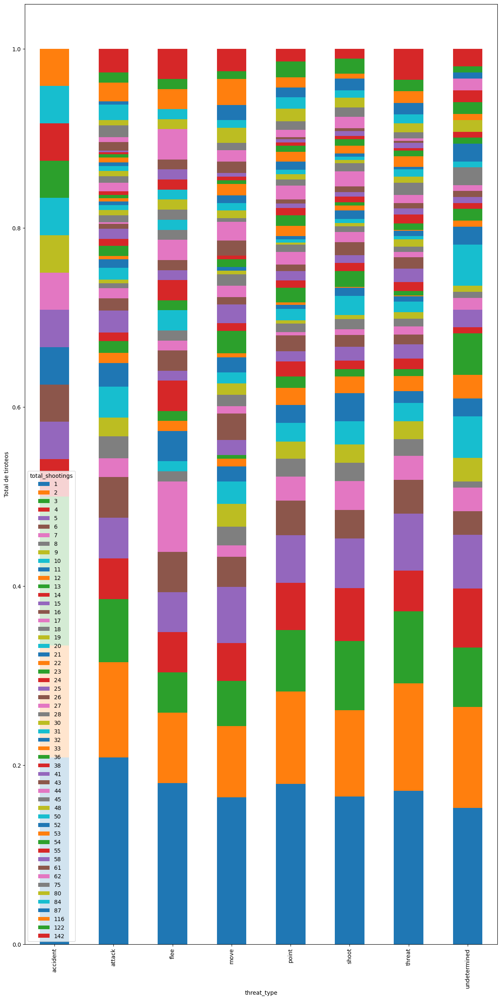

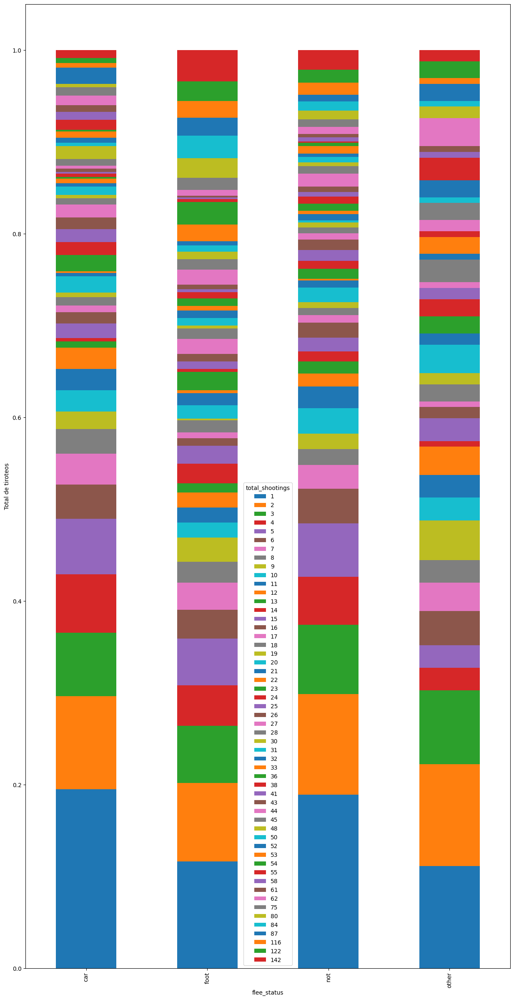

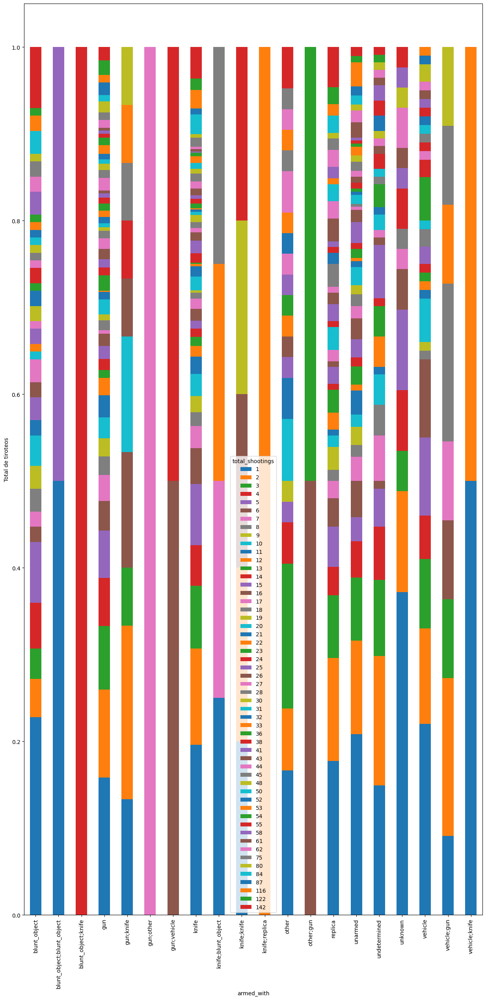

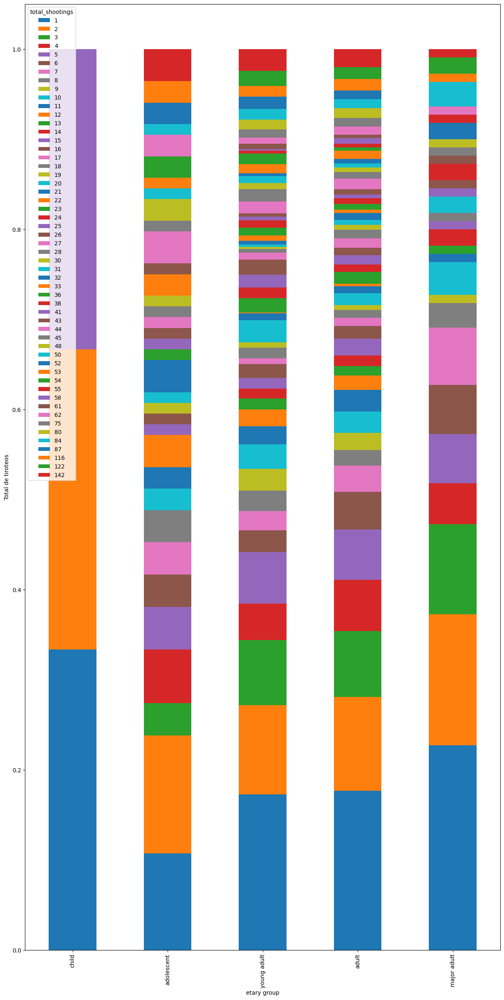

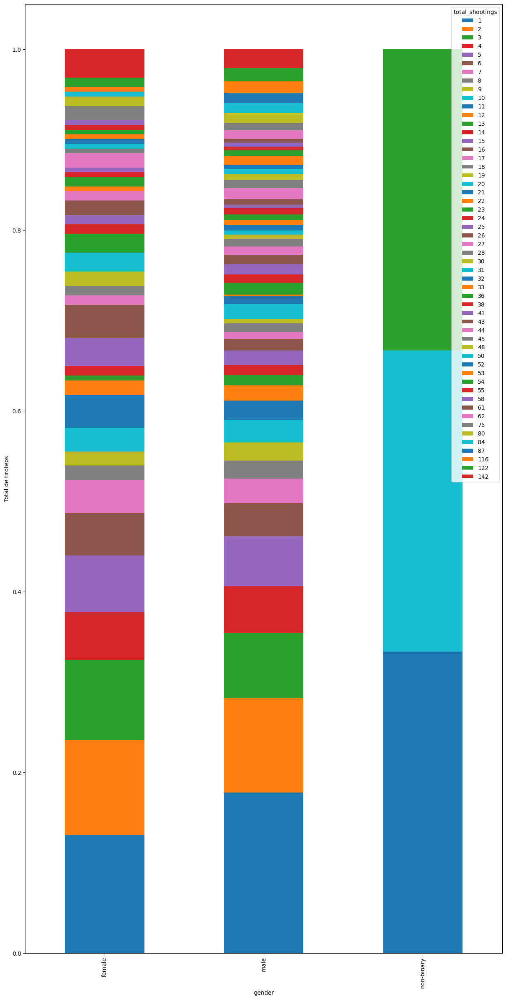

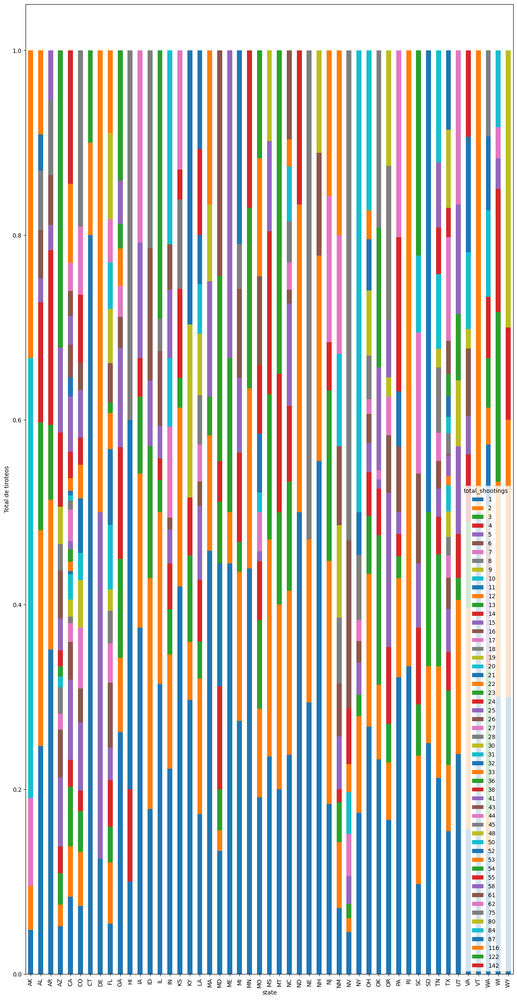

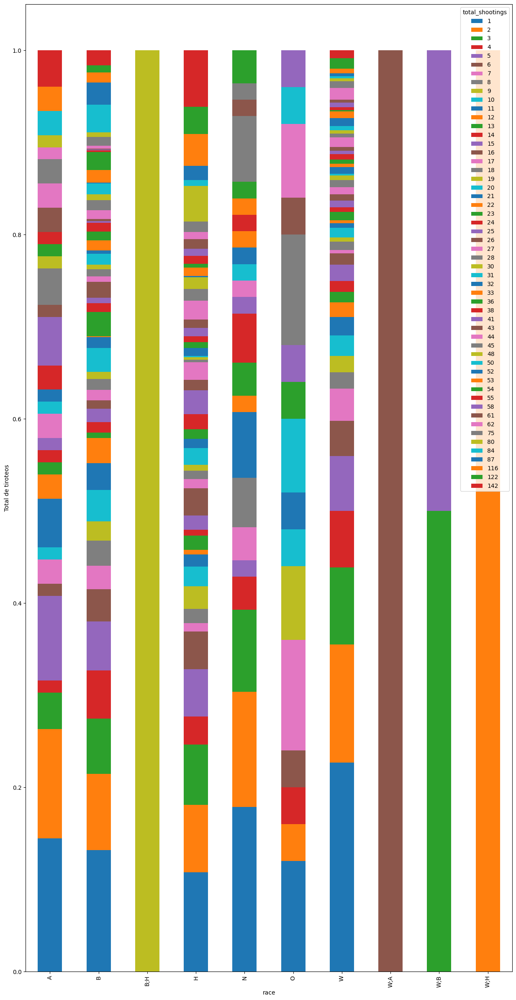

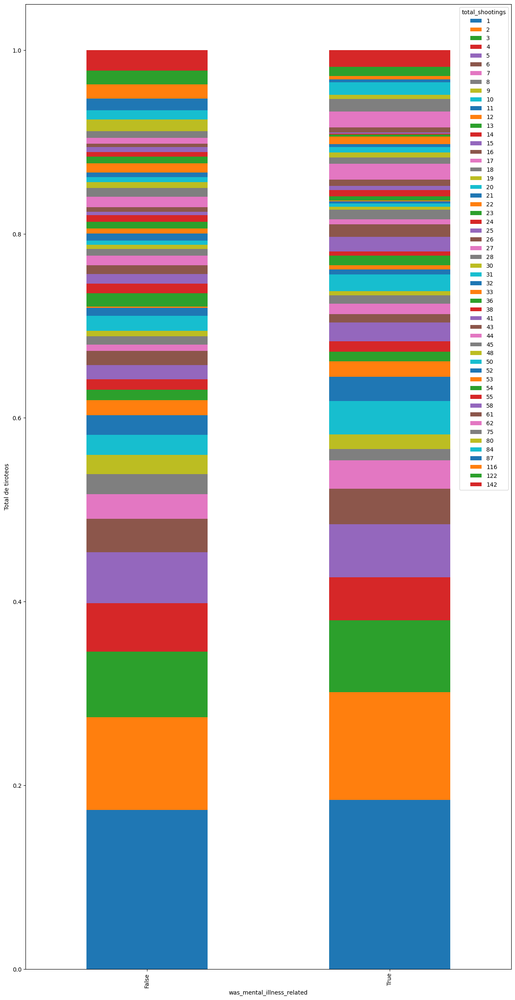

In [ ]:
columns = ['agency_name', 'threat_type', 'flee_status', 'armed_with', 'county',
           'etary group','gender', 'state', 'race','was_mental_illness_related']

for i in columns:
    if i!='total_shootings' and i != 'agency_name' and i!= 'county':
        (pd.crosstab(data[i],data['total_shootings'],normalize='index')).plot(kind='bar',figsize=(15,30),stacked=True)
        plt.ylabel('Total de tiroteos')

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


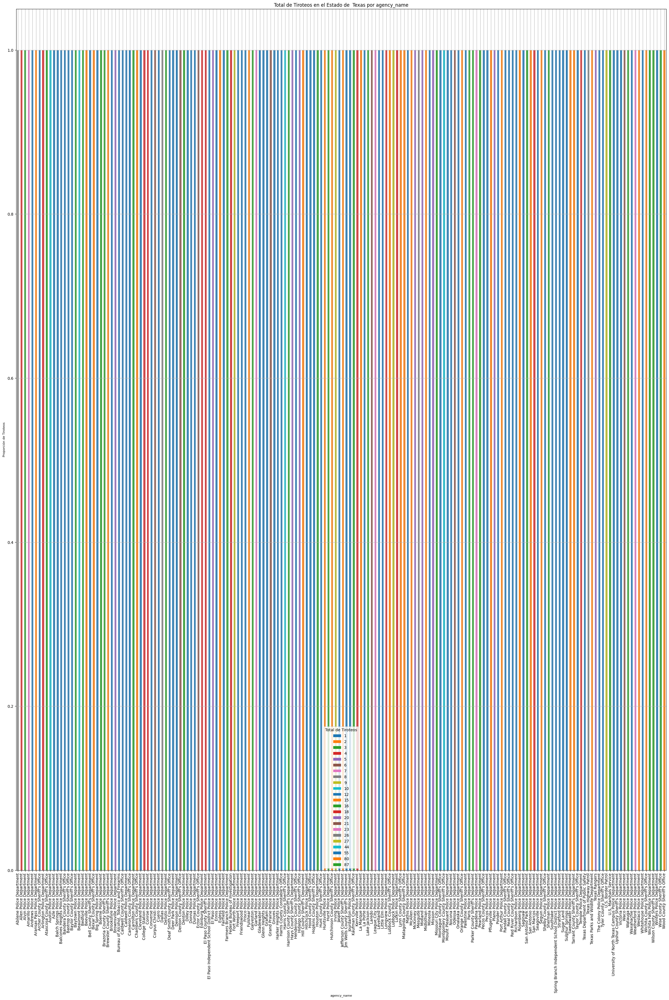

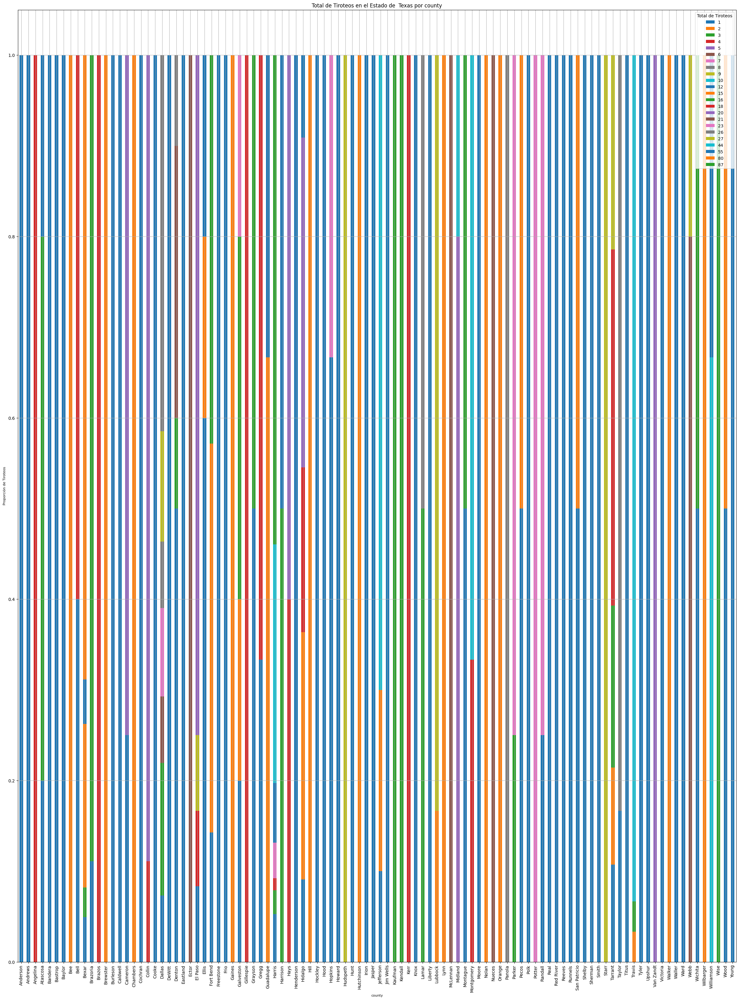

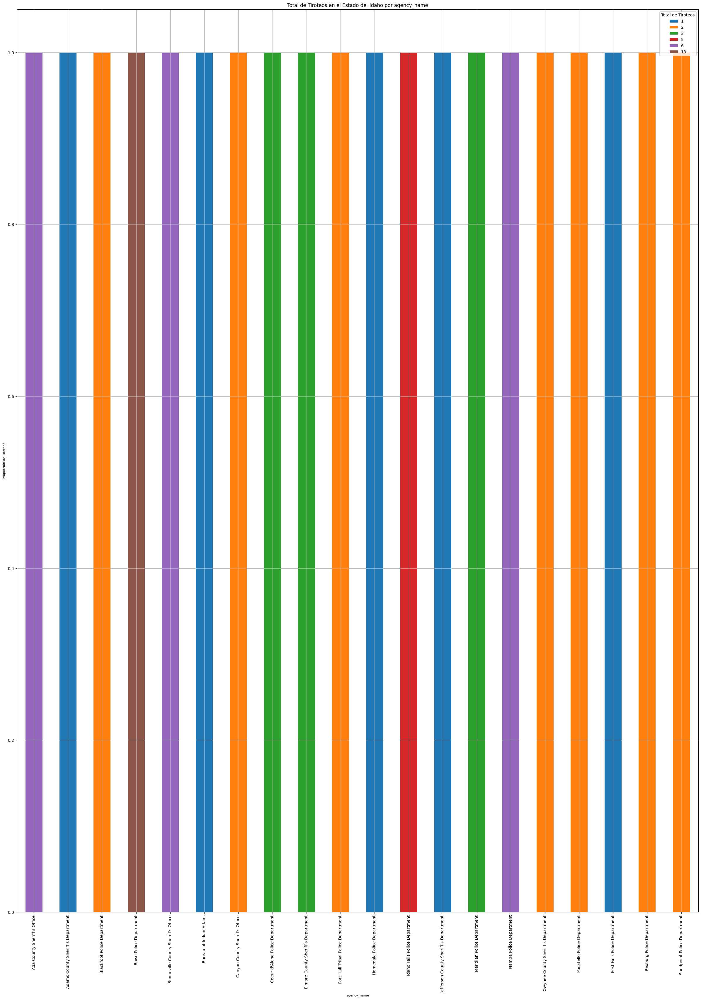

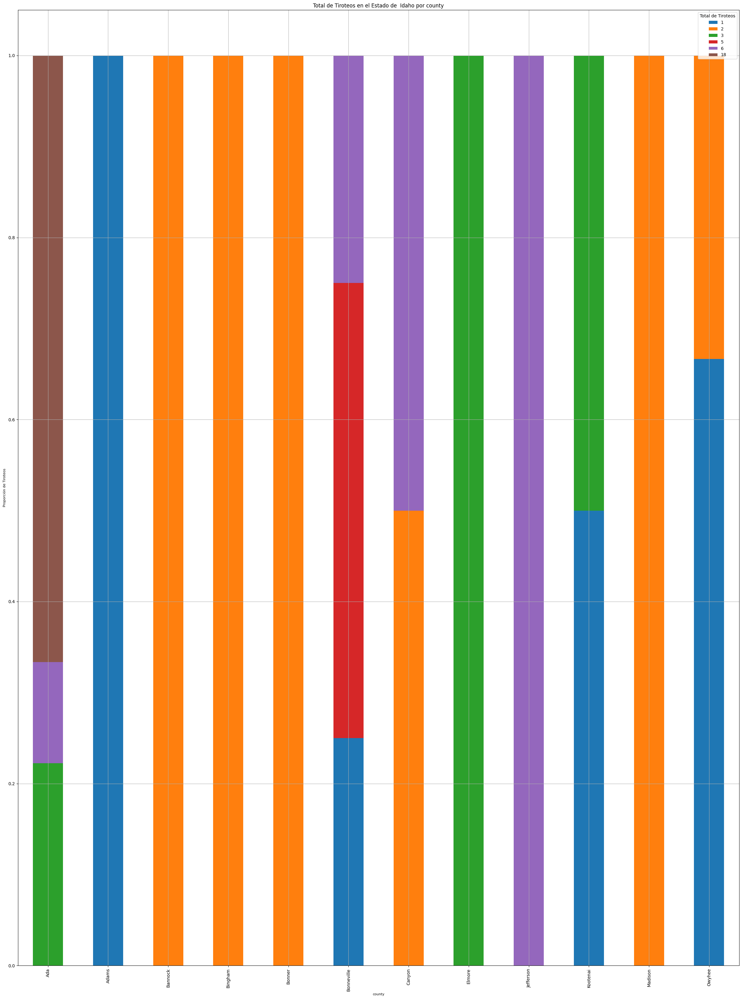

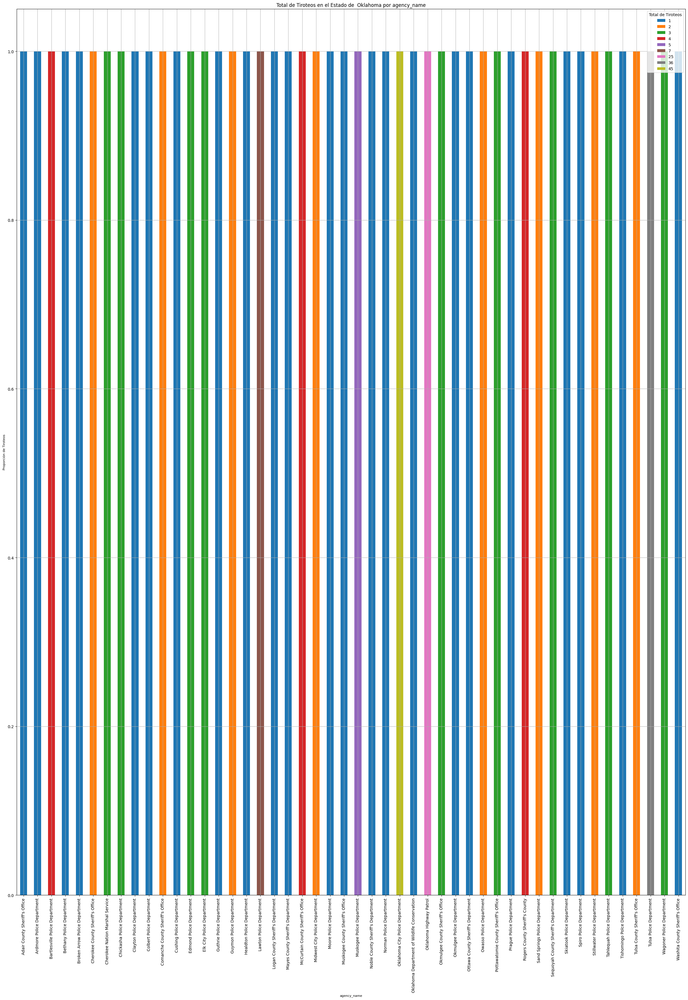

...

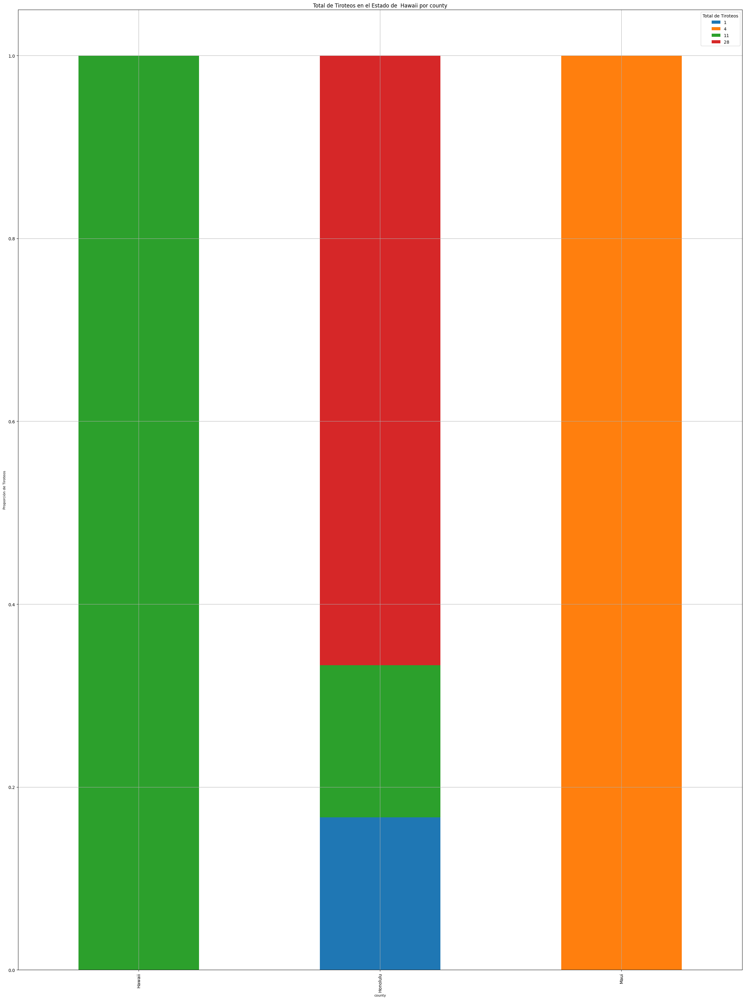

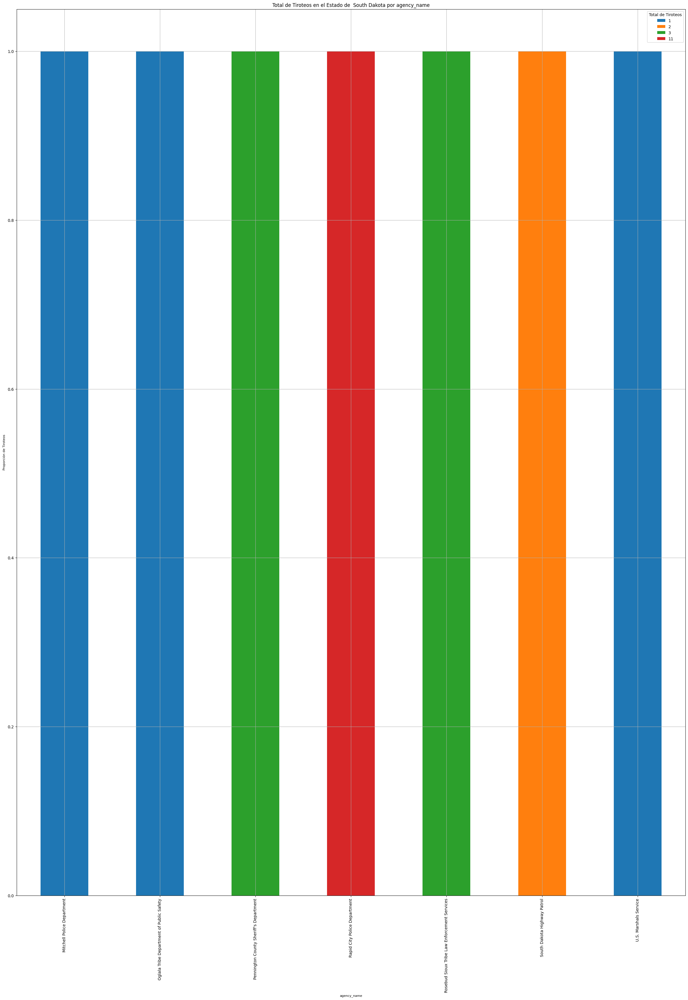

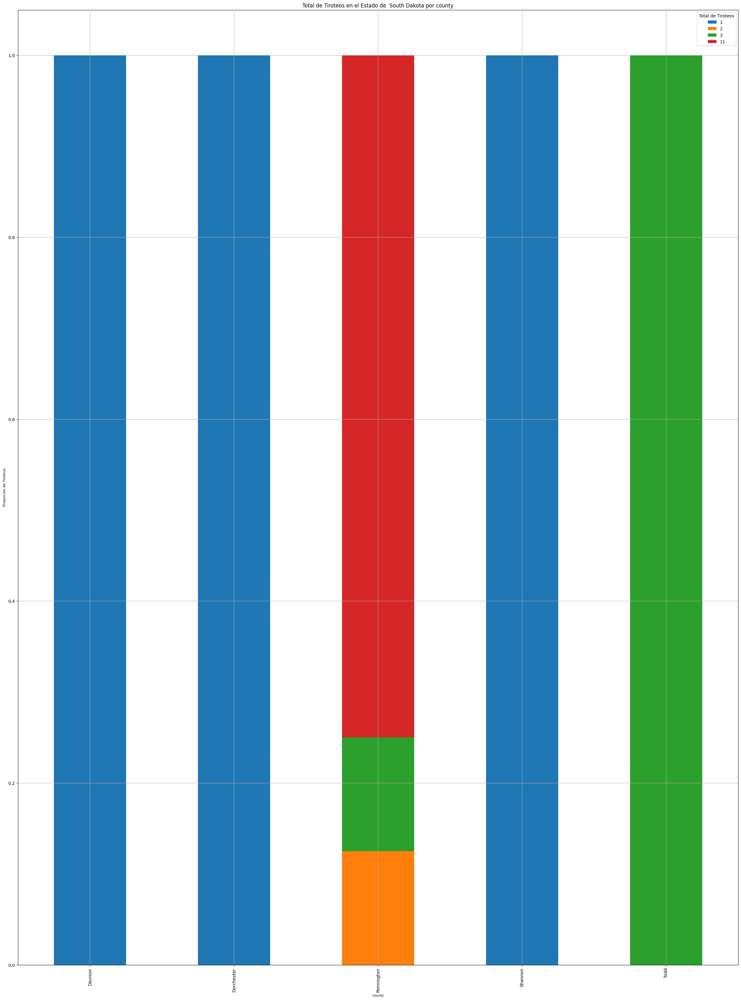

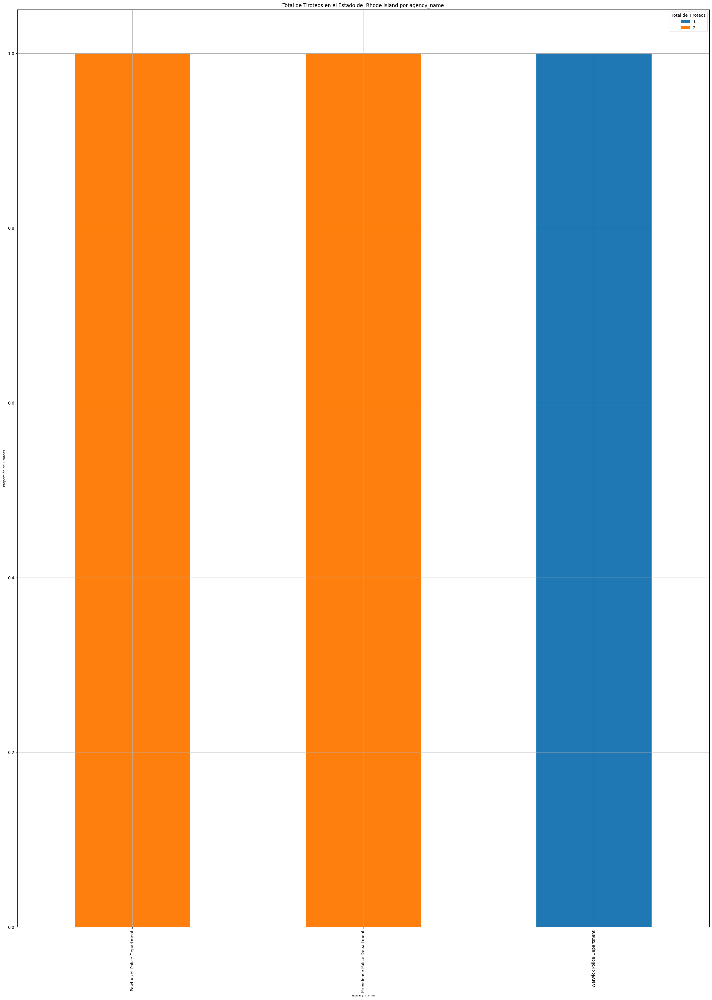

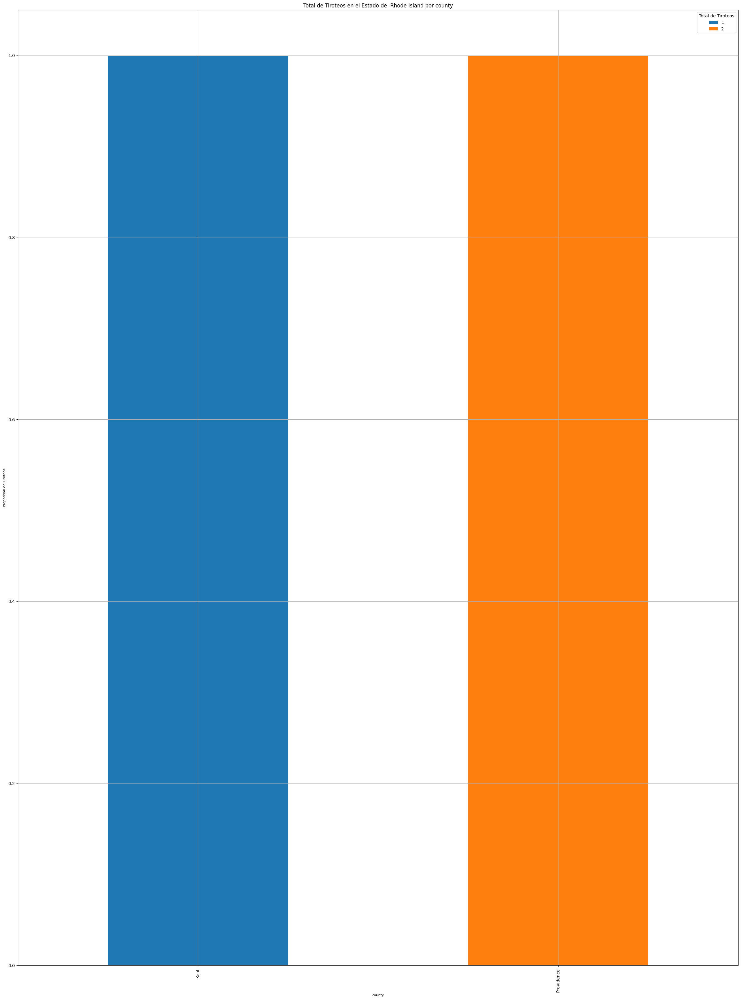

In [ ]:
# Obtener la lista de estados únicos
estados = data['State (full name)'].unique()

# Iterar sobre cada estado
for estado in estados:
    # Filtrar datos para el estado actual
    data_estado = data[data['State (full name)'] == estado]

    # Crear una gráfica para cada variable en columns dentro del estado
    for i in columns:
        if i in ['agency_name', 'county']:  # Solo graficar para 'agency_name' y 'county'
            # Crear la tabla cruzada y graficar
            crosstab = pd.crosstab(data_estado[i], data_estado['total_shootings'], normalize='index')
            ax = crosstab.plot(kind='bar', figsize=(30,40), stacked=True)

            # Personalizar la gráfica
            plt.title(f'Total de Tiroteos en el Estado de {estado} por {i}')
            plt.ylabel('Proporción de Tiroteos')
            ax.set_xlabel(i, fontsize=8)
            ax.set_ylabel('Proporción de Tiroteos', fontsize=8)
            ax.legend(title='Total de Tiroteos', fontsize=10)
            plt.xlabel(i)
            plt.legend(title='Total de Tiroteos')
            plt.grid()

            # Mostrar la gráfica
            plt.show()

In [ ]:
#Mediana de las variables numéricas, agrupadas por estatus
data.groupby(['total_shootings'])[numerical_columns].mean()

##2. **CLASIFICACIÓN DE LA DATA, SEGÚN CANTIDAD DE TIROTEOS FATALES**

Se realiza un resampleo de los datos mediante *UnderSampling* para equilibrar las clases en el dataset, lo que implica reducir la cantidad de registros de la clase mayoritaria, buscando una representación más equitativa entre las clases.

Tras el resampleo, se lleva a cabo un análisis comparativo entre los datos originales y los datos resampleados, el que se enfoca en evaluar cómo el resampleo afecta las características generales del dataset, como la distribución de las clases y las estadísticas descriptivas. Además, se examina el impacto del balanceo en el desempeño de los modelos de ML, observando si el ajuste mejora la capacidad de los modelos para predecir ambas clases de manera más precisa y equitativa.

### ***UNDERSAMPLING* DE LA DATA: Revisión de datos sesgados**

In [ ]:
from imblearn.under_sampling import RandomUnderSampler

#Separar las características y la variable objetivo
X = data.drop(['total_shootings'], axis=1)
y = data['total_shootings']

categorical_columns = ['agency_name', 'threat_type', 'flee_status', 'armed_with', 'county','gender',
                       'etary group','race', 'was_mental_illness_related', 'State (full name)']
numerical_columns = ['agency_id', 'year', 'county population']

# Dividir en conjunto de entrenamiento (80%) y de prueba (20%)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)  # 80% entrenamiento, 20% prueba

# Inicializar el submuestreador
under_sampler = RandomUnderSampler(random_state=42)

# Aplicar el submuestreo solo al conjunto de entrenamiento
X_train_resampled, y_train_resampled = under_sampler.fit_resample(X_train, y_train)

# Crear un nuevo DataFrame con los datos submuestreados
resampled_data = pd.DataFrame(X_train_resampled, columns=X.columns)
resampled_data['total_shootings'] = y_train_resampled

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


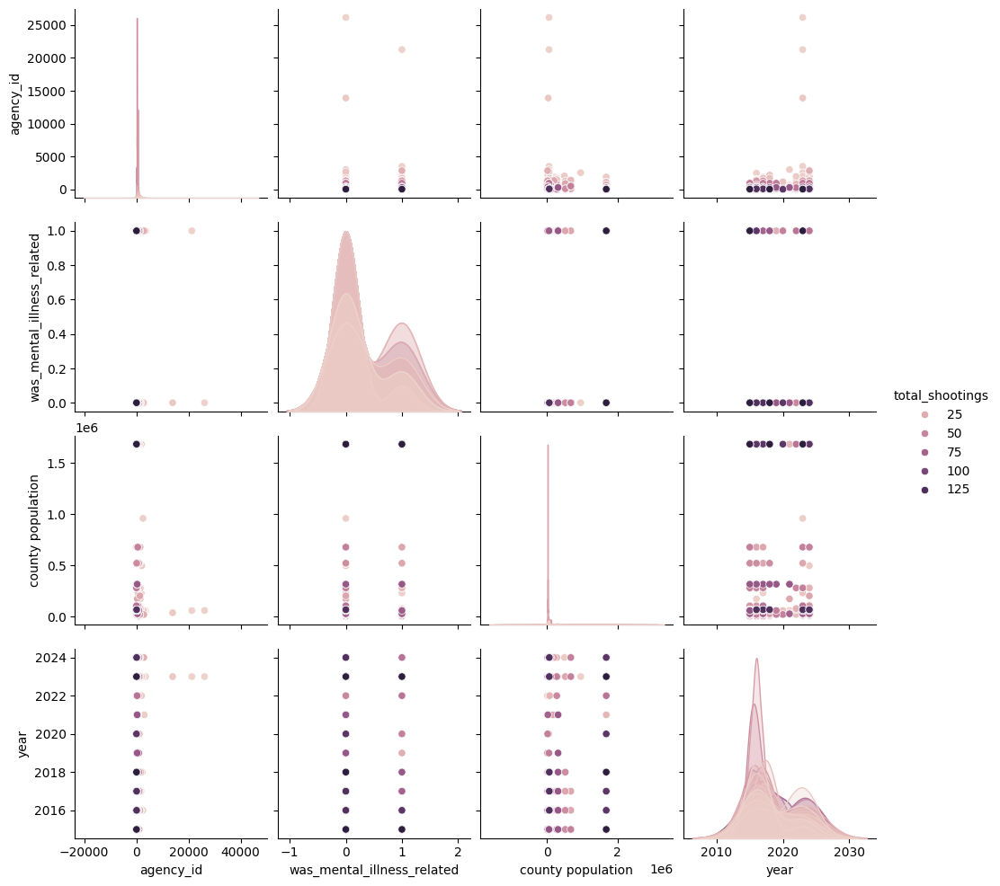

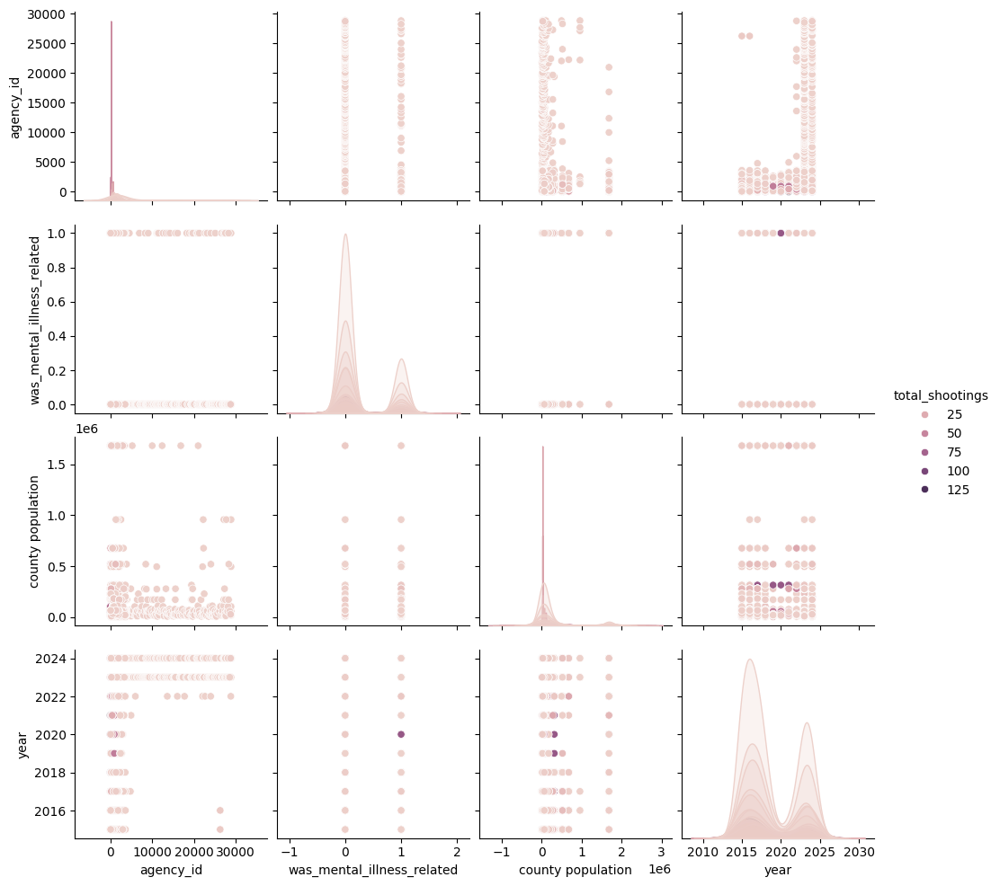

In [ ]:
# Mostrar gráficas de la data resampleada y la original
sns.pairplot(resampled_data, hue='total_shootings')
sns.pairplot(data, hue='total_shootings')
plt.show()

### **DATA RESAMPLEADA**

#### **DEFINICIÓN DE DEPARTAMENTOS DE POLICÍA CON ALTO RIESGO**

In [ ]:
agency_shootings = resampled_data.groupby(['state','State (full name)','county','agency_id','agency_name'])['total_shootings'].sum()
county_population = resampled_data.groupby(['state','State (full name)','county','agency_id','agency_name'])['county population'].sum()

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
print(agency_shootings)
print(county_population)

state  State (full name)  county                agency_id  agency_name                       
AK     Alaska             Fairbanks North Star  775        Alaska State Troopers                 33
                          Kenai Peninsula       775        Alaska State Troopers                 33
                          Matanuska-Susitna     775        Alaska State Troopers                 33
AL     Alabama            Lawrence              548        Lawrence County Sheriff's Office       2
                          Madison               531        Huntsville Police Department          12
                                                                                                 ..
WA     Washington         Pierce                475        Tacoma Police Department              28
                                                1116       Pierce County Sheriff's Department    56
                          Spokane               708        Spokane Police Department             63
WI    

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
agency_risk = agency_shootings / county_population
agency_risk_per_100k = agency_risk * 100000
print(agency_risk)
print(agency_risk_per_100k)

state  State (full name)  county                agency_id  agency_name                       
AK     Alaska             Fairbanks North Star  775        Alaska State Troopers                 0.009649
                          Kenai Peninsula       775        Alaska State Troopers                 0.009649
                          Matanuska-Susitna     775        Alaska State Troopers                 0.009649
AL     Alabama            Lawrence              548        Lawrence County Sheriff's Office      0.000034
                          Madison               531        Huntsville Police Department          0.000204
                                                                                                   ...   
WA     Washington         Pierce                475        Tacoma Police Department              0.000679
                                                1116       Pierce County Sheriff's Department    0.001358
                          Spokane               708       

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


                                                                                           total_shootings  \
state State (full name) county               agency_id agency_name                                           
AK    Alaska            Fairbanks North Star 775       Alaska State Troopers                            33   
                        Kenai Peninsula      775       Alaska State Troopers                            33   
                        Matanuska-Susitna    775       Alaska State Troopers                            33   
AL    Alabama           Lawrence             548       Lawrence County Sheriff's Office                  2   
                        Madison              531       Huntsville Police Department                     12   
...                                                                                                    ...   
WA    Washington        Pierce               475       Tacoma Police Department                         28   
          

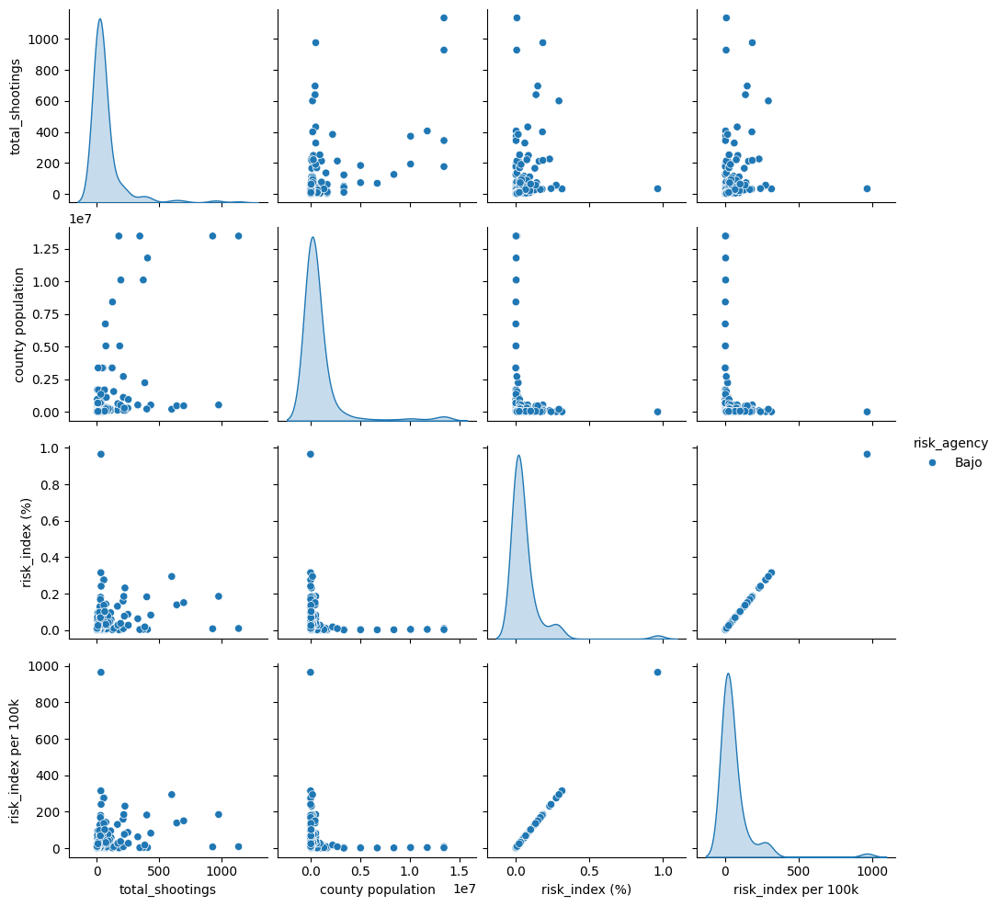

In [ ]:
agency_risk_data = pd.DataFrame({'total_shootings': agency_shootings, 'county population': county_population, 'risk_index (%)': agency_risk*100, 'risk_index per 100k': agency_risk_per_100k})
agency_risk_data['risk_agency'] = agency_risk_data.apply(
    lambda row: 'Alto' if row['risk_index per 100k'] > row['county population'] / 2 else 'Bajo',
    axis=1
)

print(agency_risk_data)
sns.pairplot(agency_risk_data, hue='risk_agency')
plt.show()

Al analizar los departamentos de policía de diferentes condados y estados, se observa que cada uno tiene un índice de riesgo generalmente bajo, tal como se muestra en la columna `risk_agency`. Por ejemplo, los *Alaska State Troopers* en los condados de Fairbanks North Star, Kenai Peninsula, y Matanuska-Susitna tienen un índice de riesgo de aproximadamente 0.96%, lo cual se traduce en 964.91 incidentes por cada 100,000 habitantes. Sin embargo, pese a este índice relativamente alto en comparación con otras agencias, el riesgo general sigue siendo clasificado como “Bajo”.

Por otro lado, en Alabama, la *Lawrence County Sheriff's Office* y el *Huntsville Police Department* muestran índices de riesgo mucho menores (0.003% y 0.02%, respectivamente), lo cual se traduce en 3.40 y 20.41 incidentes por cada 100,000 habitantes. Esta considerable variación en el índice de riesgo entre agencias sugiere que factores locales, como la población y la distribución de los recursos, podrían estar influyendo en estos resultados.

En conclusión, aunque los índices de riesgo pueden variar significativamente entre agencias y localidades, el riesgo general se mantiene bajo. Este análisis resalta la importancia de considerar el contexto local y las características específicas de cada departamento para evaluar el riesgo de manera precisa. Esto no solo permite una mejor interpretación de los datos, sino también una planificación más informada para la gestión de riesgos en cada jurisdicción.

#### **DEFINICIÓN DE CONDADOS CON ALTO RIESGO**

In [ ]:
county_shootings = resampled_data.groupby(['state','State (full name)','county'])['total_shootings'].sum()
county_population = resampled_data.groupby(['state','State (full name)','county'])['county population'].sum()

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
print(county_shootings)
print(county_population)

state  State (full name)  county              
AK     Alaska             Fairbanks North Star    33
                          Kenai Peninsula         33
                          Matanuska-Susitna       33
AL     Alabama            Lawrence                 2
                          Madison                 12
                                                  ..
WA     Washington         King                    20
                          Pierce                  84
                          Spokane                 63
WI     Wisconsin          Langlade                 2
WY     Wyoming            Natrona                  9
Name: total_shootings, Length: 172, dtype: int64
state  State (full name)  county              
AK     Alaska             Fairbanks North Star     3420
                          Kenai Peninsula          3420
                          Matanuska-Susitna        3420
AL     Alabama            Lawrence                58805
                          Madison                 

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
# Calcular índice de riesgo del condado
county_risk_index = county_shootings / county_population
county_risk_per_100k = county_risk_index * 100000
print(county_risk_index)
print(county_risk_per_100k)

state  State (full name)  county              
AK     Alaska             Fairbanks North Star    0.009649
                          Kenai Peninsula         0.009649
                          Matanuska-Susitna       0.009649
AL     Alabama            Lawrence                0.000034
                          Madison                 0.000204
                                                    ...   
WA     Washington         King                    0.000970
                          Pierce                  0.001019
                          Spokane                 0.001019
WI     Wisconsin          Langlade                0.000097
WY     Wyoming            Natrona                 0.000243
Length: 172, dtype: float64
state  State (full name)  county              
AK     Alaska             Fairbanks North Star    964.912281
                          Kenai Peninsula         964.912281
                          Matanuska-Susitna       964.912281
AL     Alabama            Lawrence            

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


                                              total_shootings  \
state State (full name) county                                  
AK    Alaska            Fairbanks North Star               33   
                        Kenai Peninsula                    33   
                        Matanuska-Susitna                  33   
AL    Alabama           Lawrence                            2   
                        Madison                            12   
...                                                       ...   
WA    Washington        King                               20   
                        Pierce                             84   
                        Spokane                            63   
WI    Wisconsin         Langlade                            2   
WY    Wyoming           Natrona                             9   

                                              county population  \
state State (full name) county                                    
AK    Alaska        

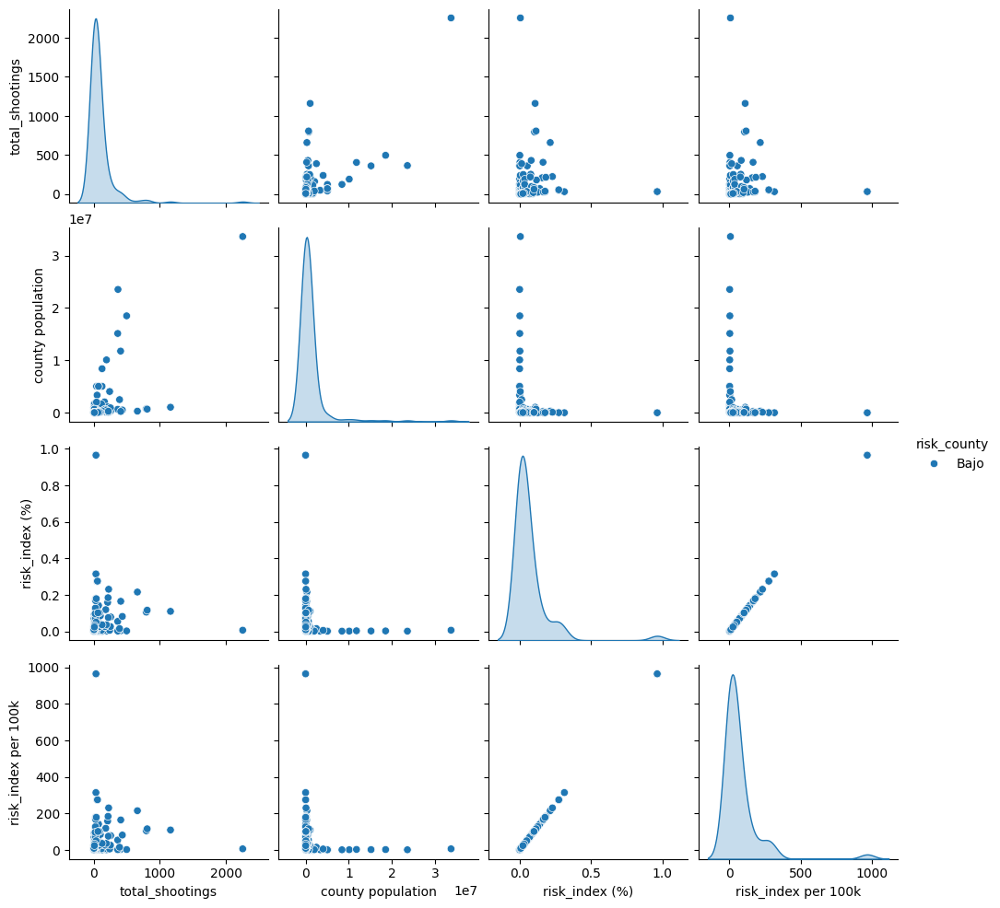

In [ ]:
risk_counties_data = pd.DataFrame({'total_shootings': county_shootings, 'county population': county_population, 'risk_index (%)': county_risk_index*100, 'risk_index per 100k': county_risk_per_100k})
risk_counties_data['risk_county'] = risk_counties_data.apply(
    lambda row: 'Alto' if row['risk_index per 100k'] > row['county population'] / 2 else 'Bajo',
    axis=1
)

print(risk_counties_data)
sns.pairplot(risk_counties_data, hue='risk_county')
plt.show()

A partir del análisis de estos datos, se observa una variabilidad considerable en el índice de riesgo por cada 100,000 habitantes entre diferentes condados. Por ejemplo, en Alaska, los condados muestran índices elevados comparados con los de Alabama, aunque todos permanecen en la categoría de "Bajo" riesgo. Esto indica que los criterios de clasificación de riesgo agrupan una amplia gama de valores dentro de una misma categoría, lo que podría limitar la precisión en la identificación de áreas con necesidades específicas de atención. Si esta tendencia persiste en un conjunto de datos más amplio, podría ser útil reevaluar la segmentación de riesgo para destacar mejor los condados con índices significativamente mayores. En conclusión, aunque los datos actuales sugieren un riesgo bajo en general, una revisión de la clasificación permitiría una comprensión más detallada y efectiva de los factores de riesgo en distintas regiones.

#### **DEFINICIÓN DE ESTADOS CON ALTO RIESGO**

In [ ]:
state_population = resampled_data.groupby(['state','State (full name)'])['county population'].sum()
state_shootings = resampled_data.groupby(['state','State (full name)'])['total_shootings'].sum()

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
print(state_population)
print(state_shootings)

state  State (full name)
AK     Alaska                   10260
AL     Alabama                 176415
AR     Arkansas                 34298
AZ     Arizona                1716546
CA     California           154776476
CO     Colorado               7274008
CT     Connecticut             957419
FL     Florida                8632508
GA     Georgia                  73776
HI     Hawaii                  200629
IA     Iowa                     14992
ID     Idaho                   494967
IL     Illinois                591633
IN     Indiana                 393899
KS     Kansas                   25052
KY     Kentucky                283545
LA     Louisiana               230304
MA     Massachusetts           457992
MD     Maryland                612954
ME     Maine                   111139
MI     Michigan                 40668
MN     Minnesota                31394
MO     Missouri                253140
MS     Mississippi              29538
NC     North Carolina          342830
NE     Nebraska          

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
state_risk_index = state_shootings / state_population
state_risk_per_100k = state_risk_index * 100000
print(state_risk_index)
print(state_risk_per_100k)

state  State (full name)
AK     Alaska               0.009649
AL     Alabama              0.000102
AR     Arkansas             0.000350
AZ     Arizona              0.000887
CA     California           0.000030
CO     Colorado             0.000049
CT     Connecticut          0.000003
FL     Florida              0.000100
GA     Georgia              0.000664
HI     Hawaii               0.000140
IA     Iowa                 0.000600
ID     Idaho                0.000010
IL     Illinois             0.000744
IN     Indiana              0.000691
KS     Kansas               0.000120
KY     Kentucky             0.002208
LA     Louisiana            0.000230
MA     Massachusetts        0.000024
MD     Maryland             0.000272
ME     Maine                0.000135
MI     Michigan             0.002951
MN     Minnesota            0.000828
MO     Missouri             0.001110
MS     Mississippi          0.000305
NC     North Carolina       0.000085
NE     Nebraska             0.000577
NJ     New Je

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


                         total_shootings  state population  risk_index (%)  \
state State (full name)                                                      
AK    Alaska                          99             10260        0.964912   
AL    Alabama                         18            176415        0.010203   
AR    Arkansas                        12             34298        0.034987   
AZ    Arizona                       1523           1716546        0.088725   
CA    California                    4618         154776476        0.002984   
CO    Colorado                       357           7274008        0.004908   
CT    Connecticut                      3            957419        0.000313   
FL    Florida                        864           8632508        0.010009   
GA    Georgia                         49             73776        0.066417   
HI    Hawaii                          28            200629        0.013956   
IA    Iowa                             9             14992      

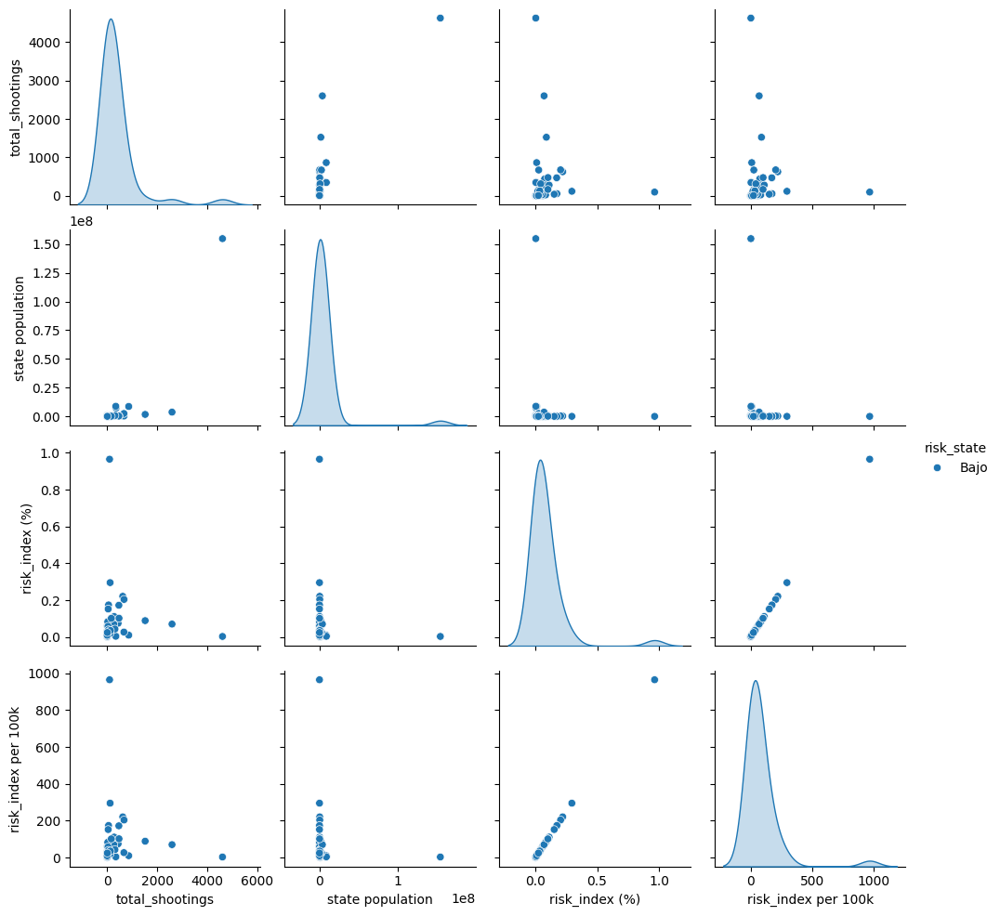

In [ ]:
risk_states_data = pd.DataFrame({'total_shootings': state_shootings, 'state population': state_population, 'risk_index (%)': state_risk_index*100, 'risk_index per 100k': state_risk_per_100k})
risk_states_data['risk_state'] = risk_states_data.apply(
    lambda row: 'Alto' if row['risk_index per 100k'] > row['state population'] / 2 else 'Bajo',
    axis=1
)

print(risk_states_data)
sns.pairplot(risk_states_data, hue='risk_state')
plt.show()

#### **CONCLUSIONES**

En este análisis se utilizan datos **resampleados** a través de la técnica de **undersampling**, que busca equilibrar la representación de incidentes de tiroteos fatales en diferentes agencias, condados y estados, por datos sesgados (como el género). Esta técnica es particularmente útil en contextos donde hay una alta disparidad en la cantidad de incidentes reportados, permitiendo así un análisis más equitativo y representativo de los patrones subyacentes.

- #### ***AGENCIAS DE POLICÍA***
En el nivel de las **agencias de policía**, los datos resampleados revelan que, a pesar de las diferencias en el número total de tiroteos, el índice de riesgo por cada 100,000 habitantes se mantiene bajo en todas las entidades. Esta técnica ayuda a mitigar el efecto de las agencias que podrían tener un número desproporcionado de incidentes, asegurando que la evaluación del riesgo refleje de manera más justa la realidad de cada área. Por ejemplo, aunque el Pomona Police Department en California reporta 6 tiroteos, su índice de riesgo se contextualiza mejor al comparar este dato con otros condados de tamaño similar.

- #### ***CONDADOS***
Al analizar los **condados**, el undersampling permite una comparación más directa entre entidades de diversas poblaciones. En este caso, Franklin y Jackson en Florida presentan índices de riesgo relativamente altos en comparación con su población. La técnica de undersampling asegura que la información sobre estos condados no esté sesgada por un número excesivo de incidentes en áreas más pobladas, proporcionando una visión más equilibrada de los riesgos asociados a los tiroteos fatales.

- #### ***ESTADOS***
A nivel de **estados**, los datos resampleados muestran que, aunque el índice de riesgo global se clasifica como “Bajo,” el undersampling permite identificar variaciones significativas en el riesgo per cápita. Por ejemplo, Illinois presenta un índice de riesgo de 164.06 por cada 100,000 habitantes, en parte debido a la aplicación del undersampling, que evita que los estados más grandes dominen los resultados. Esto revela cómo los estados con poblaciones más pequeñas pueden tener un impacto desproporcionado en las estadísticas de tiroteos fatales, lo cual es esencial para entender la dinámica del riesgo.

El uso de datos resampleados proporciona un enfoque más equilibrado y representativo para evaluar el riesgo de tiroteos fatales, porque permite apreciar mejor los patrones y tendencias en áreas con diferentes características poblacionales, destacando la importancia de ajustar las interpretaciones según el contexto específico de cada región.

### **DATA ORIGINAL**

#### **DEFINICIÓN DE DEPARTAMENTOS DE POLICÍA CON ALTO RIESGO**

- Para determinarlo, se definió un *departamento de policía de 'alto riesgo'* como una agencia que posee asociado más de 50000 personas fallecidas por cada 100000 habitantes

In [ ]:
agency_shootings = data.groupby(['state','State (full name)','county','agency_id','agency_name'])['total_shootings'].sum()
county_population = data.groupby(['state','State (full name)','county','agency_id','agency_name'])['county population'].sum()

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
print(agency_shootings)
print(county_population)

state  State (full name)  county                agency_id  agency_name                  
AK     Alaska             Anchorage             208        Anchorage Police Department      200
                          Denali                775        Alaska State Troopers             33
                          Fairbanks North Star  775        Alaska State Troopers             66
                                                776        Fairbanks Police Department       14
                          Kenai Peninsula       775        Alaska State Troopers             33
                                                                                           ... 
WY     Wyoming            Converse              1350       U.S. Marshals Service              1
                          Hot Springs           25665      Thermopolis Police Department      2
                          Laramie               658        Cheyenne Police Department         4
                          Natrona              

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
agency_risk = agency_shootings / county_population
agency_risk_per_100k = agency_risk * 100000
print(agency_risk)
print(agency_risk_per_100k)

state  State (full name)  county                agency_id  agency_name                  
AK     Alaska             Anchorage             208        Anchorage Police Department      0.005848
                          Denali                775        Alaska State Troopers            0.009649
                          Fairbanks North Star  775        Alaska State Troopers            0.009649
                                                776        Fairbanks Police Department      0.002047
                          Kenai Peninsula       775        Alaska State Troopers            0.009649
                                                                                              ...   
WY     Wyoming            Converse              1350       U.S. Marshals Service            0.000027
                          Hot Springs           25665      Thermopolis Police Department    0.000054
                          Laramie               658        Cheyenne Police Department       0.000108
  

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


                                                                                      total_shootings  \
state State (full name) county               agency_id agency_name                                      
AK    Alaska            Anchorage            208       Anchorage Police Department                200   
                        Denali               775       Alaska State Troopers                       33   
                        Fairbanks North Star 775       Alaska State Troopers                       66   
                                             776       Fairbanks Police Department                 14   
                        Kenai Peninsula      775       Alaska State Troopers                       33   
...                                                                                               ...   
WY    Wyoming           Converse             1350      U.S. Marshals Service                        1   
                        Hot Springs          25665     

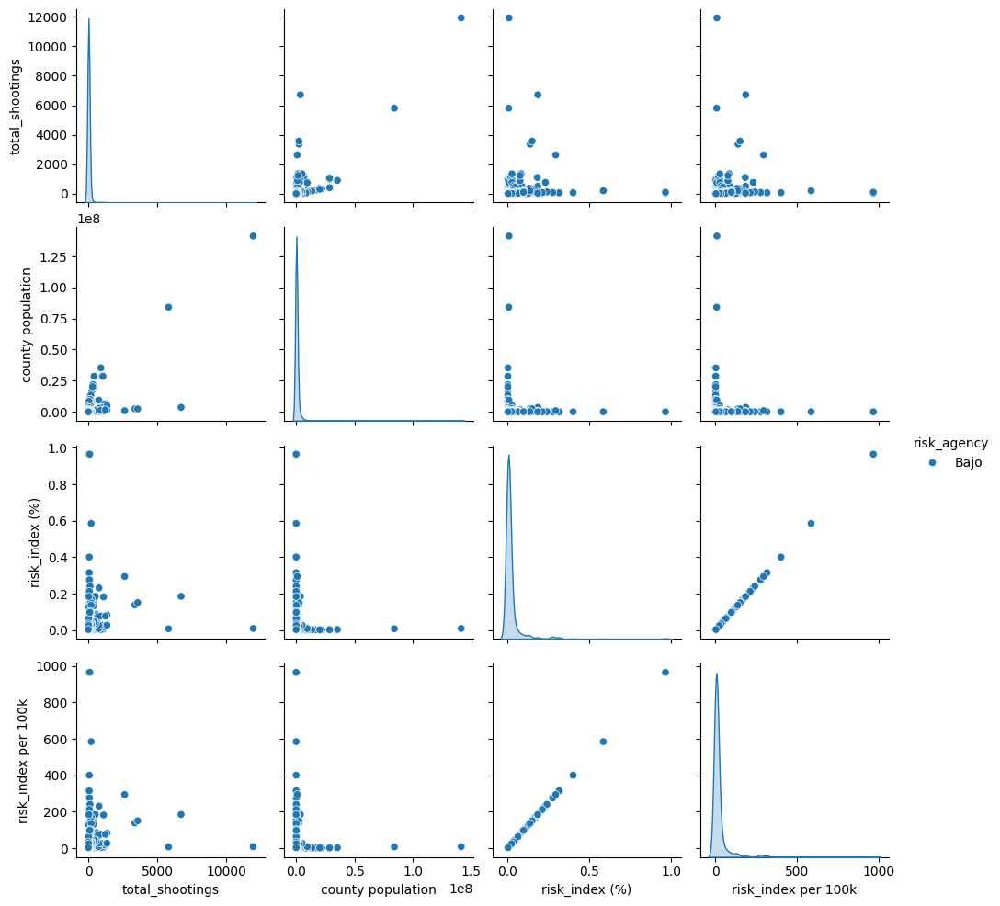

In [ ]:
agency_risk_data = pd.DataFrame({'total_shootings': agency_shootings, 'county population': county_population, 'risk_index (%)': agency_risk*100, 'risk_index per 100k': agency_risk_per_100k})
agency_risk_data['risk_agency'] = agency_risk_data.apply(
    lambda row: 'Alto' if row['risk_index per 100k'] > row['county population'] / 2 else 'Bajo',
    axis=1
)

print(agency_risk_data)
sns.pairplot(agency_risk_data, hue='risk_agency')
plt.show()

#### **DEFINICIÓN DE CONDADOS DE ALTO RIESGO**

- Para determinarlo, se definió un *condado de 'alto riesgo'* como un condado que posee asociado más de 50000 personas fallecidas por cada 100000 habitantes

In [ ]:
county_shootings = data.groupby(['state','State (full name)','county'])['total_shootings'].sum()
county_population = data.groupby(['state','State (full name)','county'])['county population'].sum()

In [ ]:
print(county_shootings)
print(county_population)

state  State (full name)  county              
AK     Alaska             Anchorage               200
                          Denali                   33
                          Fairbanks North Star     80
                          Kenai Peninsula          34
                          Matanuska-Susitna        99
                                                 ... 
WY     Wyoming            Converse                  2
                          Hot Springs               2
                          Laramie                   4
                          Natrona                  27
                          Park                      1
Name: total_shootings, Length: 1134, dtype: int64
state  State (full name)  county              
AK     Alaska             Anchorage                34200
                          Denali                    3420
                          Fairbanks North Star     13680
                          Kenai Peninsula           6840
                          Matanusk

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
# Calcular índice de riesgo del condado
county_risk_index = county_shootings / county_population
county_risk_per_100k = county_risk_index * 100000
print(county_risk_index)
print(county_risk_per_100k)

state  State (full name)  county              
AK     Alaska             Anchorage               0.005848
                          Denali                  0.009649
                          Fairbanks North Star    0.005848
                          Kenai Peninsula         0.004971
                          Matanuska-Susitna       0.009649
                                                    ...   
WY     Wyoming            Converse                0.000027
                          Hot Springs             0.000054
                          Laramie                 0.000108
                          Natrona                 0.000243
                          Park                    0.000027
Length: 1134, dtype: float64
state  State (full name)  county              
AK     Alaska             Anchorage               584.795322
                          Denali                  964.912281
                          Fairbanks North Star    584.795322
                          Kenai Peninsula    

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


                                              total_shootings  \
state State (full name) county                                  
AK    Alaska            Anchorage                         200   
                        Denali                             33   
                        Fairbanks North Star               80   
                        Kenai Peninsula                    34   
                        Matanuska-Susitna                  99   
...                                                       ...   
WY    Wyoming           Converse                            2   
                        Hot Springs                         2   
                        Laramie                             4   
                        Natrona                            27   
                        Park                                1   

                                              county population  \
state State (full name) county                                    
AK    Alaska        

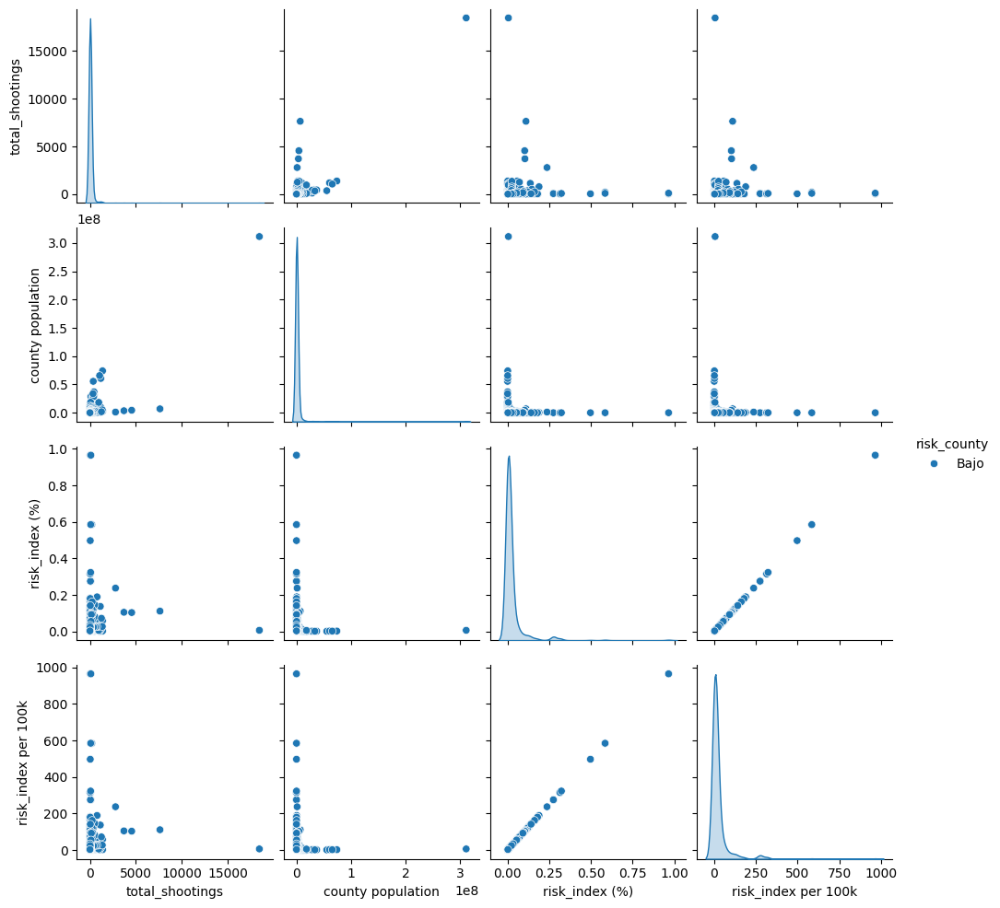

In [ ]:
risk_counties_data = pd.DataFrame({'total_shootings': county_shootings, 'county population': county_population, 'risk_index (%)': county_risk_index*100, 'risk_index per 100k': county_risk_per_100k})
risk_counties_data['risk_county'] = risk_counties_data.apply(
    lambda row: 'Alto' if row['risk_index per 100k'] > row['county population'] / 2 else 'Bajo',
    axis=1
)
print(risk_counties_data)
sns.pairplot(risk_counties_data, hue='risk_county')
plt.show()

#### **DEFINICIÓN DE ESTADOS DE ALTO RIESGO**

- Para determinarlo, se definió un *estado de 'alto riesgo'* como un estado que posee asociado más de 50000 personas fallecidas por cada 100000 habitantes

In [ ]:
state_population = data.groupby(['state','State (full name)'])['county population'].sum()
state_shootings = data.groupby(['state','State (full name)'])['total_shootings'].sum()

In [ ]:
print(state_population)
print(state_shootings)

In [ ]:
state_risk_index = state_shootings / state_population
state_risk_per_100k = state_risk_index * 100000
print(state_risk_index)
print(state_risk_per_100k)

state  State (full name)
AK     Alaska               0.006238
AL     Alabama              0.000069
AR     Arkansas             0.000210
AZ     Arizona              0.000766
CA     California           0.000026
CO     Colorado             0.000031
CT     Connecticut          0.000001
DE     Delaware             0.000044
FL     Florida              0.000062
GA     Georgia              0.000378
HI     Hawaii               0.000080
IA     Iowa                 0.000428
ID     Idaho                0.000012
IL     Illinois             0.000267
IN     Indiana              0.000305
KS     Kansas               0.000376
KY     Kentucky             0.001165
LA     Louisiana            0.000128
MA     Massachusetts        0.000018
MD     Maryland             0.000215
ME     Maine                0.000054
MI     Michigan             0.000996
MN     Minnesota            0.000336
MO     Missouri             0.000521
MS     Mississippi          0.000110
MT     Montana              0.000646
NC     North 

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


                         total_shootings  state population  risk_index (%)  \
state State (full name)                                                      
AK    Alaska                         448             71820        0.623782   
AL    Alabama                        313           4527985        0.006913   
AR    Arkansas                       133            634513        0.020961   
AZ    Arizona                       8800          11487654        0.076604   
CA    California                   25665         987541211        0.002599   
CO    Colorado                      2202          70661792        0.003116   
CT    Connecticut                     13           9574190        0.000136   
DE    Delaware                        64           1454808        0.004399   
FL    Florida                       4472          71566276        0.006249   
GA    Georgia                       1040           2748156        0.037844   
HI    Hawaii                         161           2006290      

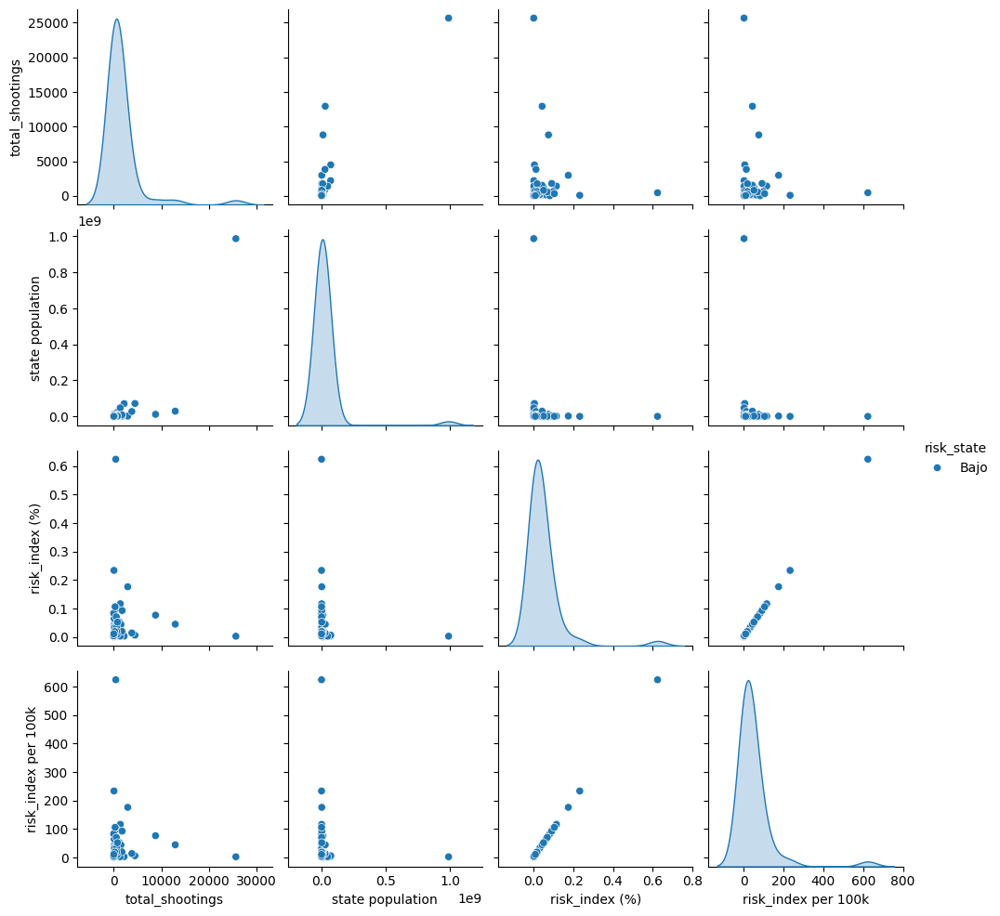

In [ ]:
risk_states_data = pd.DataFrame({'total_shootings': state_shootings, 'state population': state_population, 'risk_index (%)': state_risk_index*100, 'risk_index per 100k': state_risk_per_100k})
risk_states_data['risk_state'] = risk_states_data.apply(
    lambda row: 'Alto' if row['risk_index per 100k'] > row['state population'] / 2 else 'Bajo',
    axis=1
)

print(risk_states_data)
sns.pairplot(risk_states_data, hue='risk_state')
plt.show()

#### **CONCLUSIONES**
La información presentada se basa en datos originales, lo que significa que refleja las estadísticas de tiroteos fatales tal como fueron recopiladas y reportadas por '*The Washington Post*'.

- ##### ***DEPARTAMENTOS DE POLICÍA***
 A nivel de agencia, se observa que la mayoría de las instituciones presentan índices de riesgo clasificados como "Bajo." Esto sugiere que, en general, estas agencias no enfrentan una alta frecuencia de tiroteos fatales en comparación con la población a la que sirven. Sin embargo, el índice de riesgo por cada 100,000 habitantes varía significativamente en áreas de menor población, donde incluso unos pocos incidentes pueden generar altos índices per cápita. Este fenómeno es evidente en diversos condados a lo largo del país, donde ciertas agencias tienen índices elevados que reflejan un riesgo concentrado en áreas específicas.

- ##### ***CONDADOS***
El análisis por condado, utilizando datos originales, muestra grandes variaciones en el índice de riesgo per cápita, indicando que los tiroteos fatales no se distribuyen uniformemente en todos los condados de un estado ni entre distintos estados. Los condados menos poblados tienden a exhibir índices de riesgo mucho más altos que aquellos con mayor población. Esto sugiere que factores locales, como las políticas de seguridad y las características demográficas, influyen en la concentración de estos incidentes, destacando la complejidad del fenómeno y la necesidad de un enfoque más detallado para abordarlo.

- ##### ***ESTADOS***
A nivel estatal, los índices de riesgo también varían considerablemente en los datos originales. Algunos estados presentan índices de riesgo más altos en comparación con otros, lo cual podría estar relacionado con políticas y normativas específicas, la densidad de población o factores contextuales propios de cada estado. Los estados con poblaciones más pequeñas tienden a mostrar un impacto significativo de cada incidente en su índice de riesgo per cápita, indicando que en estos lugares, cualquier variación en los incidentes puede tener un efecto notable en la percepción del riesgo.

El análisis basado en datos originales subraya que el tamaño de la población influye claramente en el índice de riesgo en cada nivel de análisis. Los índices tienden a ser más altos en áreas de menor población, mientras que en zonas densamente pobladas, los índices por cada 100,000 habitantes son más bajos. Esta información resalta la importancia de contextualizar los datos según la población para evitar interpretaciones sesgadas sobre el riesgo de tiroteos fatales en distintas regiones del país, permitiendo así una comprensión más completa y precisa de la problemática en cuestión.

### **CONCLUSIONES SOBRE LA DATA ORIGINAL Y RESAMPLEADA: Análisis comparativo de datos originales v/s datos resampleados**

La comparación entre los datos originales y los datos resampleados (mediante la técnica de undersampling) nos revela diferencias significativas en la representación y análisis de los tiroteos fatales en Estados Unidos. En los datos originales, se observa una alta disparidad en el número de tiroteos reportados entre diferentes agencias, condados y estados.

Algunas agencias y condados con un número considerablemente mayor de incidentes pueden influir en la media y en los índices de riesgo, generando un sesgo en la interpretación de la realidad. En contraste, el uso de undersampling busca equilibrar la representación de cada agencia y condado, reduciendo la influencia desproporcionada de aquellas con un alto número de incidentes. Esto permite un análisis más equitativo y menos sesgado.

Los índices de riesgo presentan otra diferencia notable. En los datos originales, los índices de riesgo pueden mostrar valores extremos en áreas con alta incidencia de tiroteos. Por ejemplo, los condados con una gran población y muchos incidentes podrían tener un índice de riesgo que no refleja adecuadamente el riesgo real para los ciudadanos, debido a este desequilibrio de los datos. Sin embargo, al aplicar undersampling, los índices de riesgo tienden a ser más uniformes entre los condados, lo que permite que las áreas con menos incidentes sean más comparables. Esto destaca a la vez los riesgos en condados con una población pequeña que podrían tener una tasa de incidentes relativamente alta.

El análisis comparativo entre estados también ilustra las diferencias en la percepción del riesgo. Los estados más poblados, como California y Florida, suelen mostrar un alto número de tiroteos, lo que podría dar la impresión de un riesgo generalizado más elevado. Con los datos resampleados, el undersampling permite que estados menos poblados o con menos incidentes, como Georgia o Missouri, se comparen de manera más justa con estados más poblados. Por ejemplo, mientras que California presenta un índice de riesgo de 142.69 por cada 100,000 habitantes, Missouri muestra un índice más bajo de 14.11, lo que podría no ser evidente en los datos originales debido a la disparidad poblacional.

Finalmente, el uso de datos resampleados mediante undersampling proporciona una visión más equilibrada y representativa del fenómeno de los tiroteos fatales en EE.UU. Al mitigar el sesgo que pueden introducir las áreas con un alto número de incidentes, los resultados resampleados permiten una comparación más justa y efectiva entre diferentes condados y estados. Esto mejora la capacidad para identificar patrones de riesgo y áreas que requieren atención adicional, lo cual es esencial para el desarrollo de políticas y estrategias efectivas para abordar la violencia armada en el país.

## 3. **MODELOS PREDICTIVOS**

Se generan tres modelos de Machine Learning (ML): *Regresión de Poisson* (PR), *Random Forest* (RF) y *Decision Tree* (DT), con el objetivo de analizar y predecir los datos trabajados. Después de entrenar los modelos, se generan diversas gráficas para evaluar sus resultados predictivos, las que incluyen matrices de confusión para analizar la precisión de las clasificaciones, curvas ROC para medir la capacidad de los modelos de diferenciar entre clases, y gráficos de importancia de variables para identificar qué factores son más relevantes en las predicciones. También se usan gráficos de dispersión o de líneas para comparar las predicciones con los datos reales, lo que facilita la visualización y comparación del rendimiento de cada modelo.

Para finalizar, se generaron conclusiones basadas en los resultados de los modelos. Se observó que tanto *Random Forest* como *Regresión de Poisson* mostraron un buen desempeño en términos de precisión, gracias al balanceo de los datos mediante *undersampling*, lo que permitió que los modelos aprendieran de manera más equilibrada entre las clases. El *Árbol de Decisión* también mostró ser útil al identificar variables clave, como la agencia de policía, para realizar predicciones. En general, los modelos mostraron que, con los ajustes adecuados, pueden realizar predicciones efectivas, destacando la importancia de las variables relevantes para cada tipo de modelo y el impacto del balanceo de los datos en el rendimiento predictivo.

### 3.1. **REGRESIÓN POISSON**

In [ ]:
# Transformar variables categóricas a variables dummies
print(categorical_columns)

# One-Hot Encoding en la data resampleada (resampled_data)
resampled_data = pd.get_dummies(data=resampled_data, columns=categorical_columns, drop_first=True)
resampled_data.head()
resampled_data.shape

In [ ]:
# REGRESIÓN DE POISSON
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import PoissonRegressor
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.impute import SimpleImputer
from sklearn.metrics import precision_recall_curve, confusion_matrix, mean_squared_error, r2_score
from sklearn.preprocessing import OneHotEncoder

# Crear una función de métricas para poisson regression
def metrics_score(actual, predicted):
    mse = mean_squared_error(actual, predicted)
    r2 = r2_score(actual, predicted)
    print(f"Mean Squared Error: {mse}")
    print(f"R-squared: {r2}")
    plt.figure(figsize=(15,8))
    sns.scatterplot(x=actual, y=predicted)
    plt.plot([min(actual), max(actual)], [min(actual), max(actual)], linestyle='--', color='red')
    plt.xlabel('Actual')
    plt.ylabel('Predecido')
    plt.title('Matriz de Confusión - PR')
    plt.show()

# Pipeline de preprocesamiento
preprocessor = ColumnTransformer(
    transformers=[
        ('num', StandardScaler(), numerical_columns),
        ('cat', OneHotEncoder(drop='first', handle_unknown='ignore'), categorical_columns)
    ]
)

sc = StandardScaler()

# Aplicar el preprocessor a la data transformada
X_train_transformed = preprocessor.fit_transform(X_train_resampled)
X_test_transformed = preprocessor.transform(X_test)

lg=PoissonRegressor()

# Hacer el calce del modelo
lg.fit(X_train_transformed,y_train_resampled)

lg_model = Pipeline(steps=[('preprocessor', preprocessor),
                        ('regressor', PoissonRegressor())])

# Entrenar el modelo con el conjunto de entrenamiento
lg_model.fit(X_train_resampled, y_train_resampled)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [0, 3, 4, 5, 9] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num', StandardScaler(),
                                                  ['agency_id', 'year',
                                                   'county population']),
                                                 ('cat',
                                                  OneHotEncoder(drop='first',
                                                                handle_unknown='ignore'),
                                                  ['agency_name', 'threat_type',
                                                   'flee_status', 'armed_with',
                                                   'county', 'gender',
                                                   'etary group', 'race',
                                                   'was_mental_illness_related',
                                                   'State (full name)'])])),
                ('regressor', PoissonRegressor())])

In [ ]:
# Mostrar por pantalla el conjunto resampleado de entrenamiento
X_train_resampled.head(50)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,agency_id,agency_name,state,threat_type,flee_status,armed_with,county,gender,race,was_mental_illness_related,State (full name),county population,year,etary group
576438,21244,Pecos Police Department,TX,attack,not,knife;knife,Reeves,male,H,True,Texas,57922,2023,adult
410302,1388,Lake City Police Department,SC,shoot,car,gun,Florence,male,W,False,South Carolina,24295,2016,young adult
636601,1747,Sabine Parish Sheriff's Office,LA,attack,not,unarmed,Sabine,male,B,False,Louisiana,57576,2017,young adult
269180,429,Gardner Police Department,KS,shoot,not,gun,Johnson,female,W,False,Kansas,12526,2015,adult
553615,2138,Okmulgee Police Department,OK,threat,not,knife,Okmulgee,male,B,True,Oklahoma,19495,2018,young adult
278190,1518,Gladewater Police Department,TX,threat,other,gun,Gregg,male,W,False,Texas,57922,2016,adult
756294,26118,Tyler County Sheriff's Office,TX,threat,car,gun,Tyler,male,B,False,Texas,57922,2023,adult
756134,758,Twinsburg Police Department,OH,shoot,not,gun,Summit,male,W,False,Ohio,27477,2015,major adult
71031,3506,Beeville Police Department,TX,attack,not,knife,Bee,male,H,True,Texas,57922,2023,adult
359061,604,Hutchinson Police Department,KS,point,not,gun,Reno,male,W,False,Kansas,12526,2016,adult


#### **MÉTRICAS PARA LA PRIMERA PREDICCIÓN REALIZADA**

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


************** DATA DE ENTRENAMIENTO **************
Mean Squared Error: 159.04118860330308
R-squared: 0.8342252644925672


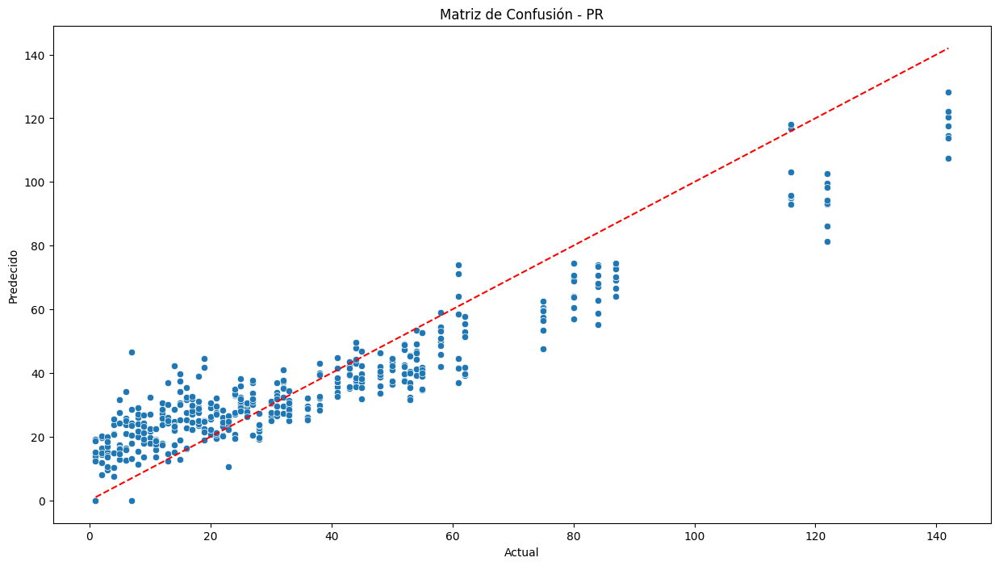

In [ ]:
# Revisar el rendimiento del conjunto de entrenamiento
y_pred = lg_model.predict(X_train_resampled)
print("************** DATA DE ENTRENAMIENTO **************")
metrics_score(y_train_resampled, y_pred)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [0, 3, 4, 5, 9] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


************** DATA DE TESTEO **************
Mean Squared Error: 258.69580170645213
R-squared: 0.7337751183942585


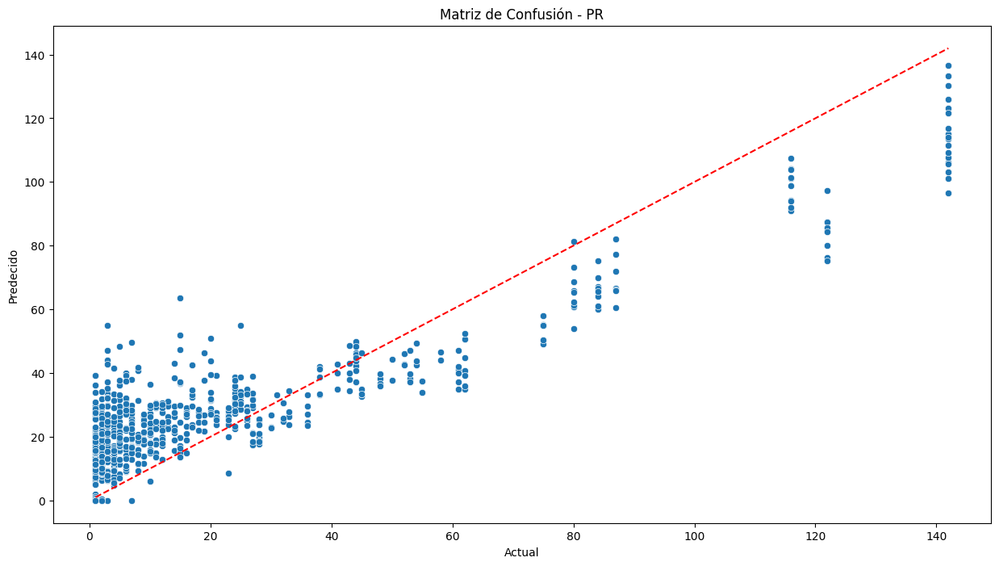

In [ ]:
# Revisar el rendimiento del conjunto de testeo
y_pred = lg_model.predict(X_test)
print("************** DATA DE TESTEO **************")
metrics_score(y_test, y_pred)

In [ ]:
# Encontrar los odds
odds = np.exp(lg.coef_[0])
feature_names = preprocessor.get_feature_names_out()

# Agregar los odds al dataframe y ordenar los valores
pd.DataFrame(odds, feature_names, columns = ['odds']).sort_values(by ='odds', ascending = False)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,odds
num__agency_id,0.428646
cat__county_Gwinnett,0.428646
cat__county_Lee,0.428646
cat__county_Lawrence,0.428646
cat__county_Larimer,0.428646
...,...
cat__agency_name_Polk County Sheriff's Department,0.428646
cat__agency_name_Pittsfield Police Department,0.428646
cat__agency_name_Pima County Sheriff's Department,0.428646
cat__agency_name_Pierce County Sheriff's Department,0.428646


In [ ]:
# Mostrar por pantalla los coeficientes de la regresión Poisson
print("****************** COEFICIENTES DE POISSON REGRESSION ******************")
for feature, coef in zip(preprocessor.get_feature_names_out(), lg.coef_):
    print(f"{feature}: {coef}")

print("")

# Mostrar por pantalla el intercepto de la regresión Poisson
print("****************** INTERCEPTO DE POISSON REGRESSION ******************")
print(f"Intercepto: {lg.intercept_}")

****************** COEFICIENTES DE POISSON REGRESSION ******************
num__agency_id: -0.847122896990688
num__year: 0.04222376016514172
num__county population: 0.09037037321430172
cat__agency_name_Alaska State Troopers: 0.042881463621702406
cat__agency_name_Albuquerque Police Department: 0.16633432640845267
cat__agency_name_Amarillo Police Department: -0.018774474304885186
cat__agency_name_Anaheim Police Department: -0.03455621467932622
cat__agency_name_Antigo Police Department: -0.02859216629415435
cat__agency_name_Arizona Department of Public Safety: -0.026301843477693158
cat__agency_name_Arlington Police Department: -0.07622173805783813
cat__agency_name_Aurora Police Department: -0.04512716378705973
cat__agency_name_Austin Police Department: 0.05189821528824005
cat__agency_name_Azusa Police Department: -0.09149958479541788
cat__agency_name_Bakersfield Police Department: -0.06299000678954494
cat__agency_name_Baltimore County Police Department: -0.01737329090537189
cat__agency_name

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
# Mostrar por pantalla los coeficientes de la regresión Poisson
print("****************** COEFICIENTES DE POISSON REGRESSION ******************")
for feature, coef in zip(preprocessor.get_feature_names_out(), lg.coef_):
    print(f"{feature}: {coef}")

print("")

# Mostrar por pantalla el intercepto de la regresión Poisson
print("****************** INTERCEPTO DE POISSON REGRESSION ******************")
print(f"Intercepto: {lg.intercept_}")

****************** COEFICIENTES DE POISSON REGRESSION ******************
num__agency_id: -0.847122896990688
num__year: 0.04222376016514172
num__county population: 0.09037037321430172
cat__agency_name_Alaska State Troopers: 0.042881463621702406
cat__agency_name_Albuquerque Police Department: 0.16633432640845267
cat__agency_name_Amarillo Police Department: -0.018774474304885186
cat__agency_name_Anaheim Police Department: -0.03455621467932622
cat__agency_name_Antigo Police Department: -0.02859216629415435
cat__agency_name_Arizona Department of Public Safety: -0.026301843477693158
cat__agency_name_Arlington Police Department: -0.07622173805783813
cat__agency_name_Aurora Police Department: -0.04512716378705973
cat__agency_name_Austin Police Department: 0.05189821528824005
cat__agency_name_Azusa Police Department: -0.09149958479541788
cat__agency_name_Bakersfield Police Department: -0.06299000678954494
cat__agency_name_Baltimore County Police Department: -0.01737329090537189
cat__agency_name

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
# Mostrar por pantalla los coeficientes de la regresión Poisson
print("****************** COEFICIENTES DE POISSON REGRESSION ******************")
for feature, coef in zip(preprocessor.get_feature_names_out(), lg.coef_):
    print(f"{feature}: {coef}")

print("")

# Mostrar por pantalla el intercepto de la regresión Poisson
print("****************** INTERCEPTO DE POISSON REGRESSION ******************")
print(f"Intercepto: {lg.intercept_}")

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


****************** COEFICIENTES DE POISSON REGRESSION ******************
num__agency_id: -0.847122896990688
num__year: 0.04222376016514172
num__county population: 0.09037037321430172
cat__agency_name_Alaska State Troopers: 0.042881463621702406
cat__agency_name_Albuquerque Police Department: 0.16633432640845267
cat__agency_name_Amarillo Police Department: -0.018774474304885186
cat__agency_name_Anaheim Police Department: -0.03455621467932622
cat__agency_name_Antigo Police Department: -0.02859216629415435
cat__agency_name_Arizona Department of Public Safety: -0.026301843477693158
cat__agency_name_Arlington Police Department: -0.07622173805783813
cat__agency_name_Aurora Police Department: -0.04512716378705973
cat__agency_name_Austin Police Department: 0.05189821528824005
cat__agency_name_Azusa Police Department: -0.09149958479541788
cat__agency_name_Bakersfield Police Department: -0.06299000678954494
cat__agency_name_Baltimore County Police Department: -0.01737329090537189
cat__agency_name

In [ ]:
# Create a DataFrame for the coefficients
coef_df = pd.DataFrame({'feature': preprocessor.get_feature_names_out(), 'coef': lg.coef_})

# Sort the DataFrame by coefficients in descending order
coef_df = coef_df.sort_values(by=['coef'], ascending=False)

# Print the sorted coefficients
print("****************** COEFICIENTES DE POISSON REGRESSION ******************")
for index, row in coef_df.iterrows():
    print(f"{row['feature']}: {row['coef']}")

print("")

# Print the intercept
print("****************** INTERCEPTO DE POISSON REGRESSION ******************")
print(f"Intercepto: {lg.intercept_}")

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


****************** COEFICIENTES DE POISSON REGRESSION ******************
cat__county_Los Angeles: 0.5580910532201514
cat__agency_name_Phoenix Police Department: 0.5265189875575775
cat__agency_name_Los Angeles Police Department: 0.4434623387044342
cat__agency_name_Las Vegas Metropolitan Police Department: 0.3300184756368228
cat__agency_name_New York Police Department: 0.32837059531289237
cat__State (full name)_ New York: 0.32837059531289237
cat__agency_name_Houston Police Department: 0.31367306158547487
cat__agency_name_Los Angeles County Sheriff's Department: 0.267012781537135
cat__agency_name_Texas Department of Public Safety: 0.26667944266382004
cat__agency_name_San Antonio Police Department: 0.25600294225570985
cat__State (full name)_ Arizona: 0.2351361837882035
cat__county_Harris: 0.2300969387108203
cat__county_Maricopa: 0.22209389859163964
cat__State (full name)_ Texas: 0.21186336395291197
cat__State (full name)_ Kentucky: 0.1840898901654433
cat__county_Bexar: 0.1794995803584549
c

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


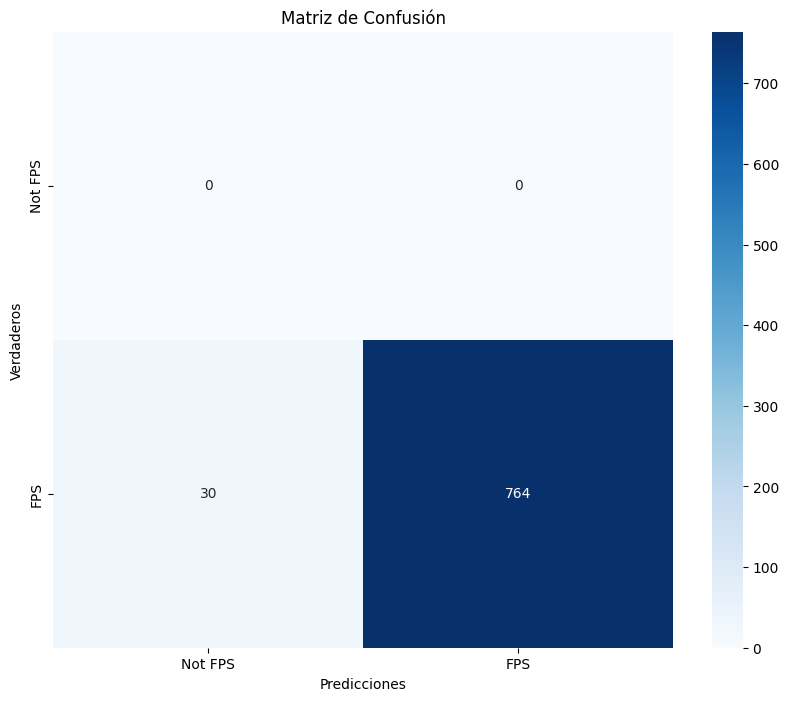


******************** MÉTRICAS DE CLASIFICACIÓN ********************
              precision    recall  f1-score   support

           0       0.00      0.00      0.00         0
           1       1.00      0.96      0.98       794

    accuracy                           0.96       794
   macro avg       0.50      0.48      0.49       794
weighted avg       1.00      0.96      0.98       794



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


In [ ]:
from sklearn.metrics import confusion_matrix, classification_report, roc_curve, auc

threshold = 0.5
y_pred_binary = (y_pred > threshold).astype(int)
y_test_binary = (y_test > threshold).astype(int)

# Generar matriz de confusión
conf_matrix = confusion_matrix(y_test_binary, y_pred_binary)
plt.figure(figsize=(10,8))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', cbar=True,xticklabels=['Not FPS', 'FPS'],yticklabels=['Not FPS', 'FPS'])
plt.xlabel("Predicciones")
plt.ylabel("Verdaderos")
plt.title("Matriz de Confusión")
plt.show()

# Calcular métricas de clasificación
print("")
print("******************** MÉTRICAS DE CLASIFICACIÓN ********************")
print(classification_report(y_test_binary, y_pred_binary))

#### **MÉTRICAS PARA LA SEGUNDA PREDICCIÓN REALIZADA**

In [ ]:
# Predecir (nuevamente) la variable de interés para la data de entrenamiento
y_pred_train = lg.predict(X_train_transformed)

# Calcular las métricas de la variable de interés para la data de entrenamiento
metrics_score(y_train_resampled, y_pred_train)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Mean Squared Error: 258.69580170645213
R-squared: 0.7337751183942585


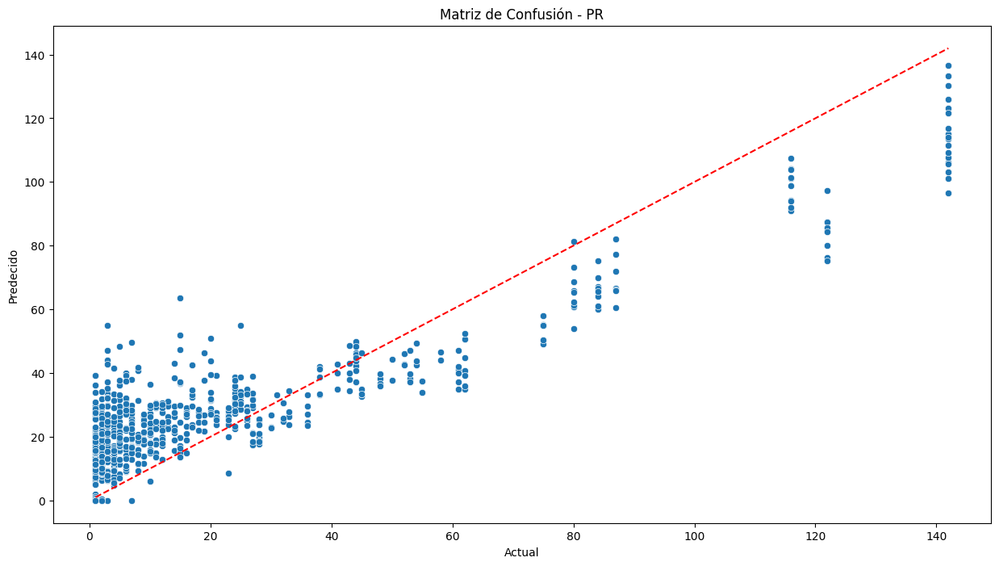

In [ ]:
# Segunda revisión de prediccción con datos de testeo
y_pred_test = lg.predict(X_test_transformed)
metrics_score(y_test, y_pred_test)



/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


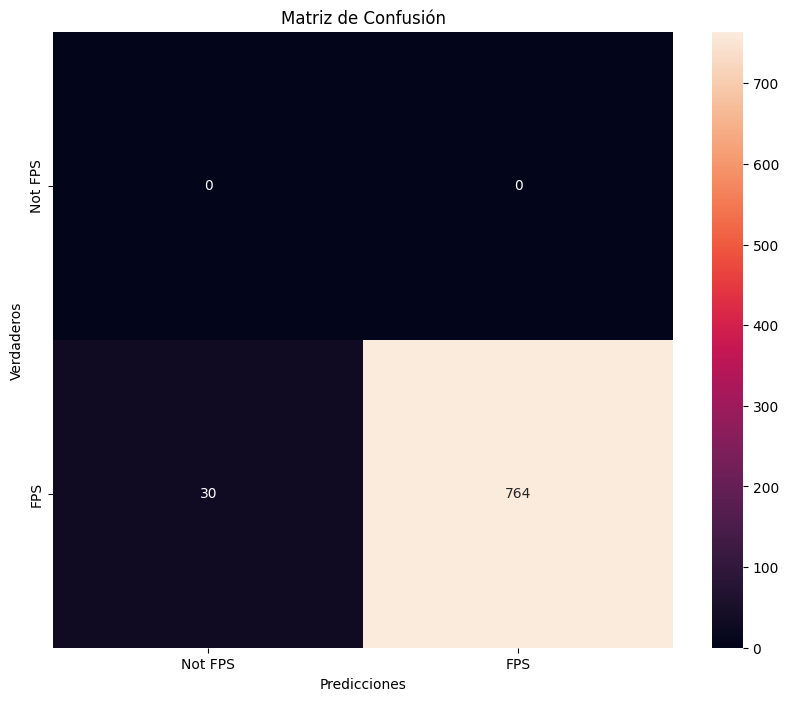


******************** MÉTRICAS DE CLASIFICACIÓN ********************
              precision    recall  f1-score   support

           0       0.00      0.00      0.00         0
           1       1.00      0.96      0.98       794

    accuracy                           0.96       794
   macro avg       0.50      0.48      0.49       794
weighted avg       1.00      0.96      0.98       794



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


In [ ]:
from sklearn.metrics import confusion_matrix, classification_report, roc_curve, auc

threshold = 0.5
y_pred_binary = (y_pred_test > threshold).astype(int)
y_test_binary = (y_test > threshold).astype(int)

# Generar matriz de confusión
conf_matrix = confusion_matrix(y_test_binary, y_pred_binary)
plt.figure(figsize=(10,8))
sns.heatmap(conf_matrix, annot=True,  fmt='d', xticklabels=['Not FPS', 'FPS'], yticklabels=['Not FPS', 'FPS'])
plt.xlabel("Predicciones")
plt.ylabel("Verdaderos")
plt.title("Matriz de Confusión")
plt.show()

# Calcular métricas de clasificación
print("")
print("******************** MÉTRICAS DE CLASIFICACIÓN ********************")
print(classification_report(y_test_binary, y_pred_binary))

#### **CONCLUSIONES: REVISIONES DE PREDICCIÓN DEL MODELO DE REGRESIÓN DE POISSON**

Al comparar las matrices de confusión obtenidas en ambas revisiones de evaluación para los "outcomes" binarizados, se observa que no existen diferencias en los resultados de las predicciones del modelo de Regresión de Poisson. Esto indica que el modelo está generando predicciones consistentes, independientemente de las variaciones en la metodología de evaluación de los resultados binarios. La estabilidad de las predicciones entre ambas revisiones es un signo positivo, ya que refleja que el modelo tiene un desempeño sólido y no se ve afectado por pequeñas diferencias en los enfoques de evaluación.

La ausencia de variaciones en las matrices de confusión sugiere que la Regresión de Poisson se ha ajustado correctamente y está capturando los patrones esenciales de los datos. Si, tras binarizar las variables, los "outcomes" mantienen la misma distribución en ambas revisiones, es posible que el modelo esté logrando una interpretación robusta de la estructura de los datos, sin necesidad de depender de métodos de evaluación específicos. Este resultado también podría señalar que no hay información adicional o relevante que los distintos enfoques de evaluación puedan aportar en este caso, lo que simplifica el análisis y respalda la estabilidad de las predicciones.


In [ ]:
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score, roc_curve, auc

y_pred_counts = np.round(y_pred_test)
epsilon = 1e-10  # Valor pequeño para evitar división por cero

# Ajuste para evitar valores cero en y_test y y_pred_counts
y_test_adjusted = np.where(y_test == 0, epsilon, y_test)
y_pred_counts_adjusted = np.where(y_pred_counts == 0, epsilon, y_pred_counts)

# Mostrar por pantalla métricas de evaluación
print("******************** MÉTRICAS DE REGRESIÓN ********************")

# Error Absoluto Medio (MAE)
mae = mean_absolute_error(y_test, y_pred_counts)
print("Error Absoluto Medio (MAE):", mae)

# Raíz del Error Cuadrático Medio (RMSE)
rmse = np.sqrt(mean_squared_error(y_test, y_pred_counts))
print("Raíz del Error Cuadrático Medio (RMSE):", rmse)

# Deviance ajustada
deviance = 2 * np.sum(y_test_adjusted * np.log(y_test_adjusted / y_pred_counts_adjusted) - (y_test_adjusted - y_pred_counts_adjusted))
print("Deviance ajustada:", deviance)
print("")

******************** MÉTRICAS DE REGRESIÓN ********************
Error Absoluto Medio (MAE): 13.30478589420655
Raíz del Error Cuadrático Medio (RMSE): 16.09879761456615
Deviance ajustada: 12146.017094977866



/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


### 3.2 **RANDOM FOREST**

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [0, 3, 4, 5, 9] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(



******************** MÉTRICAS DE REGRESIÓN ********************
Mean Squared Error (Error cuadrático medio): 83.36053929471032
R-squared (R cuadrado): 0.9142133364440622
***************************************************************



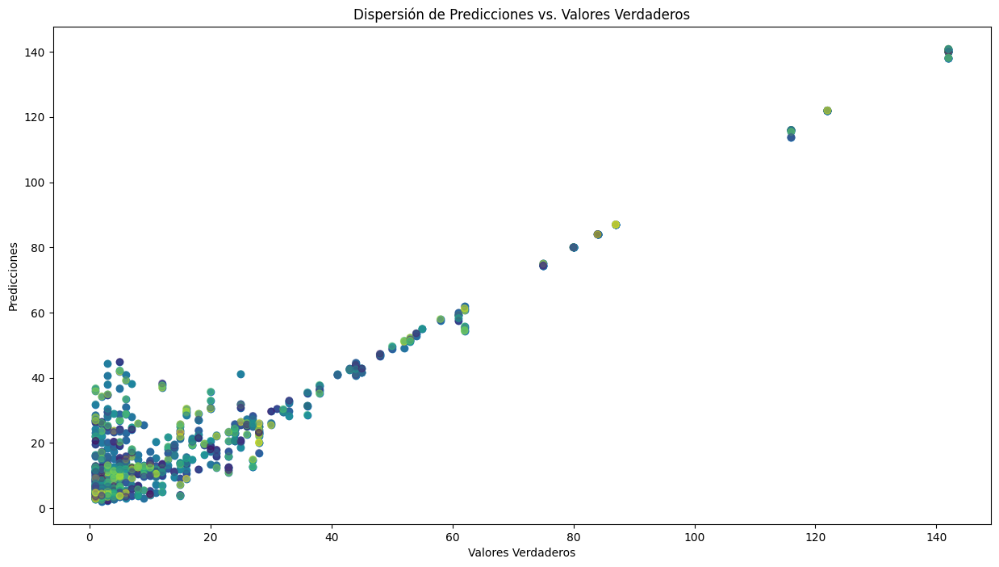

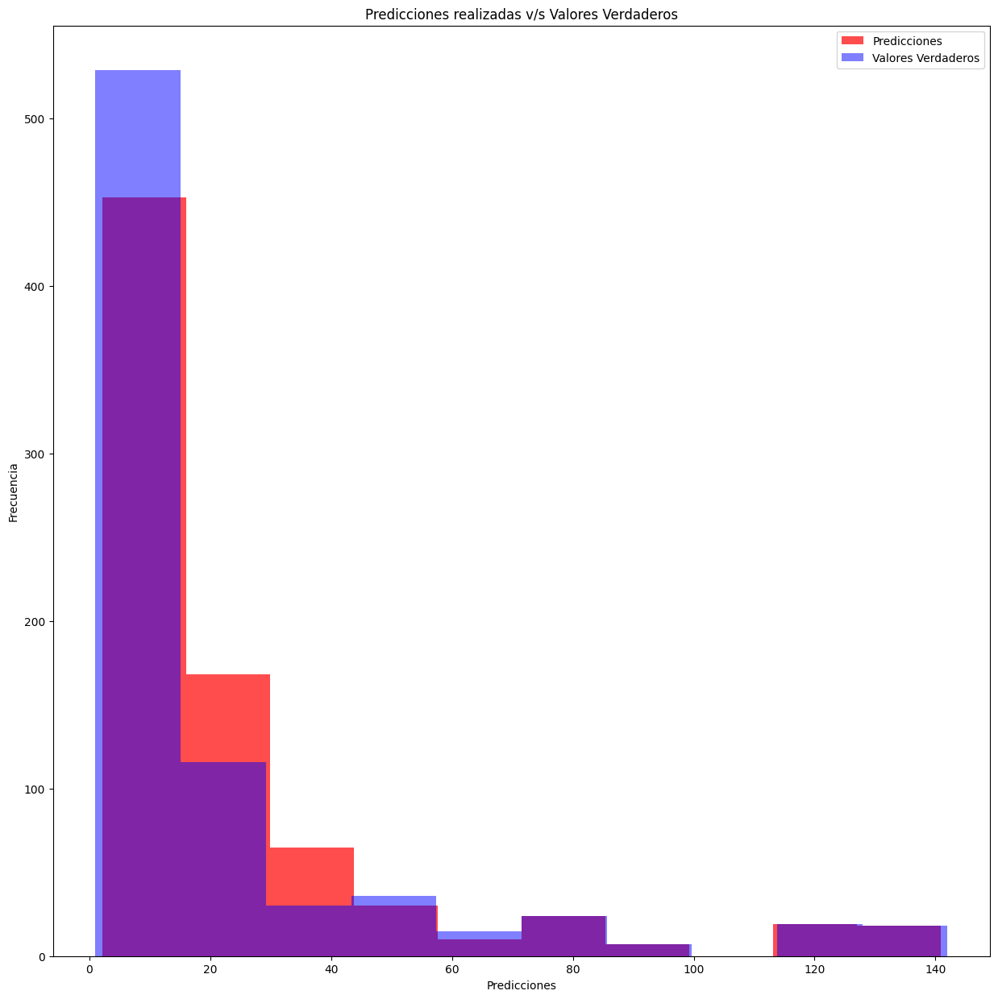

In [ ]:
#Importar bibliotecas (externas) necesarias
from imblearn.under_sampling import RandomUnderSampler
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, r2_score, roc_auc_score, confusion_matrix, classification_report
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.impute import SimpleImputer

# Inicializar y entrenar el modelo
model = Pipeline(steps=[('preprocessor', preprocessor),
                        ('regressor', RandomForestRegressor(random_state=42))])

# Entrenar el modelo con el conjunto de entrenamiento
model.fit(X_train_resampled, y_train_resampled)

# Evaluación del modelo
y_pred = model.predict(X_test)

# Usar métricas de regresión para Random Forest (RF)
print("")
print("******************** MÉTRICAS DE REGRESIÓN ********************")
print("Mean Squared Error (Error cuadrático medio):", mean_squared_error(y_test, y_pred))
print("R-squared (R cuadrado):", r2_score(y_test, y_pred))
print("***************************************************************")
print("")

# Generar gráficas para las predicciones
plt.figure(figsize=(15,8))
plt.scatter(y_test, y_pred)
plt.xlabel("Valores Verdaderos")
plt.ylabel("Predicciones")
plt.title("Dispersión de Predicciones vs. Valores Verdaderos")

# Color de la gráfica
colors = np.random.rand(len(y_test))
plt.scatter(y_test, y_pred, c=colors, alpha=0.5)

plt.figure(figsize=(15,15))
plt.hist(y_pred, color = 'red', alpha=0.7, label='Predicciones')
plt.hist(y_test, color = 'blue', alpha=0.5, label='Valores Verdaderos')
plt.xlabel("Predicciones")
plt.ylabel("Frecuencia")
plt.title("Predicciones realizadas v/s Valores Verdaderos")

# Agregar leyenda de colores
plt.legend()
plt.show()

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:409: UserWarning: A single label was found in 'y_true' and 'y_pred'. For the confusion matrix to have the correct shape, use the 'labels' parameter to pass all known labels.
  warnings.warn(


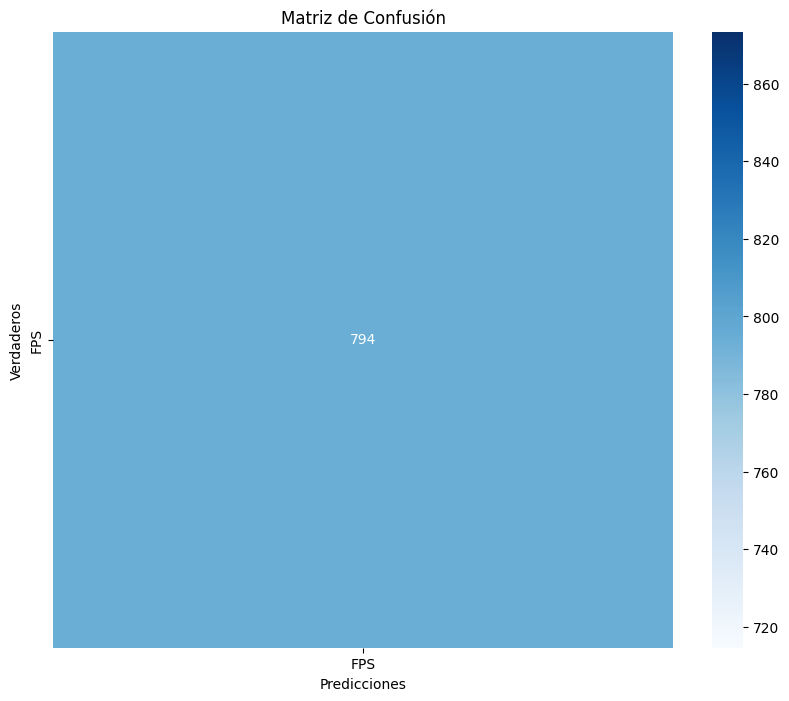


******************** MÉTRICAS DE CLASIFICACIÓN ********************
              precision    recall  f1-score   support

           1       1.00      1.00      1.00       794

    accuracy                           1.00       794
   macro avg       1.00      1.00      1.00       794
weighted avg       1.00      1.00      1.00       794



In [ ]:
from sklearn.metrics import roc_curve, auc

# Definir un umbral para convertir predicciones continuas a clasificaciones binarias
threshold = 0.5
y_pred_binary = (y_pred > threshold).astype(int)
y_test_binary = (y_test > threshold).astype(int)

# Generar la matriz de confusión
conf_matrix = confusion_matrix(y_test_binary, y_pred_binary)
plt.figure(figsize=(10, 8))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=['FPS'], yticklabels=['FPS'])
plt.xlabel("Predicciones")
plt.ylabel("Verdaderos")
plt.title("Matriz de Confusión")
plt.show()

# Calcular y mostrar métricas de clasificación
print("\n******************** MÉTRICAS DE CLASIFICACIÓN ********************")
print(classification_report(y_test_binary, y_pred_binary))

### 3.3 **ÁRBOLES DE DECISIÓN**

#### **DATA RESAMPLEADA**

In [ ]:
from sklearn.tree import DecisionTreeClassifier

# Crear árbol de decisión
dt = DecisionTreeClassifier(random_state=42)

# Entrenar el modelo
dt.fit(X_train_transformed, y_train_resampled)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


DecisionTreeClassifier(random_state=42)

Mean Squared Error: 0.0
R-squared: 1.0


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


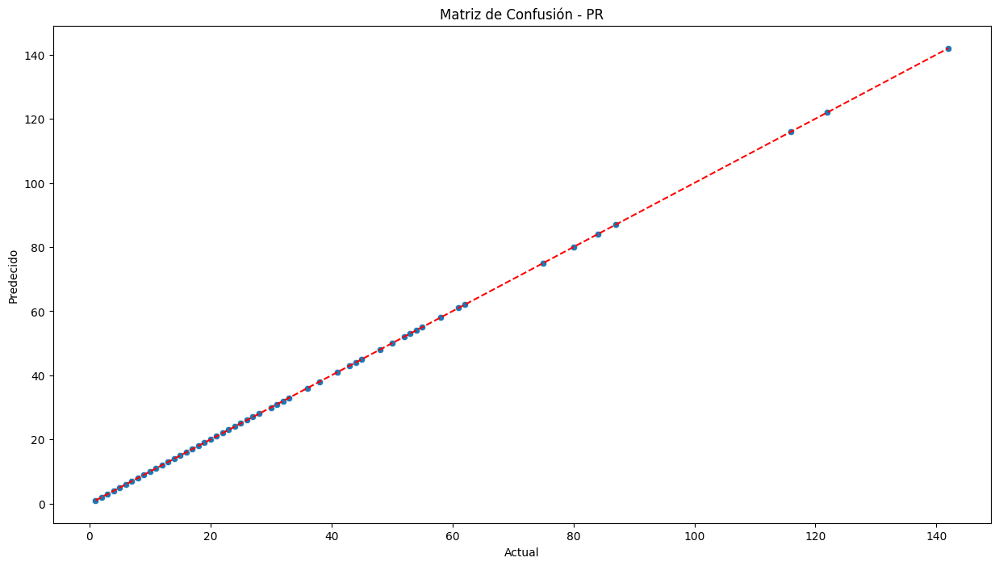

Mean Squared Error: 113.49496221662469
R-squared: 0.8832018815935218


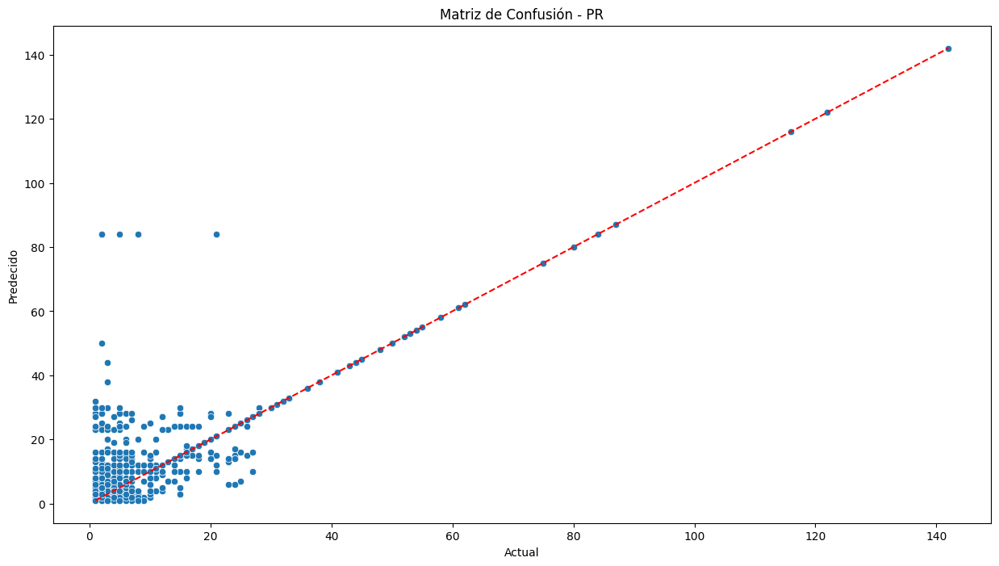

In [ ]:
# Revisión de performance en data de entrenamiento
y_train_pred_dt = dt.predict(X_train_transformed)
metrics_score(y_train_resampled, y_train_pred_dt)

# Segunda revisión de performance en data de testeo
y_test_pred_dt = dt.predict(X_test_transformed)
metrics_score(y_test, y_test_pred_dt)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


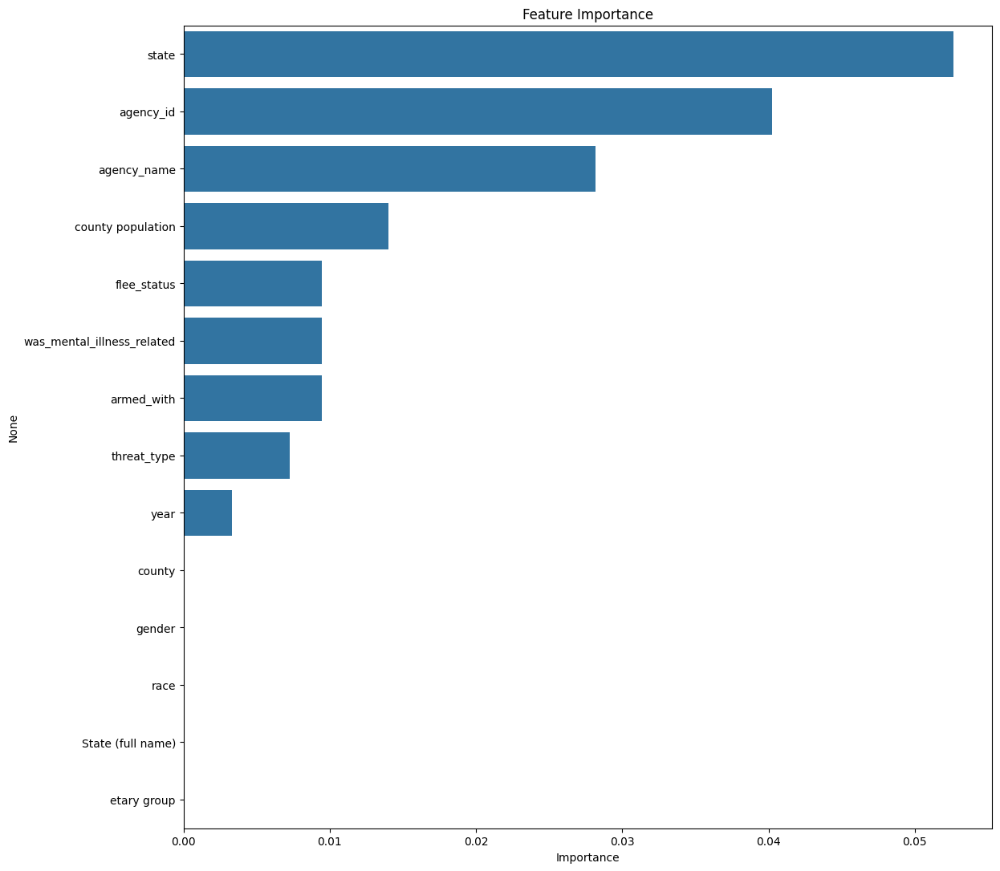

In [ ]:
# Generar importancias de la data
importances = dt.feature_importances_[:14]
columns = X.columns
importance_df = pd.DataFrame(importances, index = columns, columns = ['Importance']).sort_values(by = 'Importance', ascending = False)
plt.figure(figsize = (13,13))
sns.barplot(x=importance_df.Importance, y=importance_df.index)
plt.title('Feature Importance')
plt.show()

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


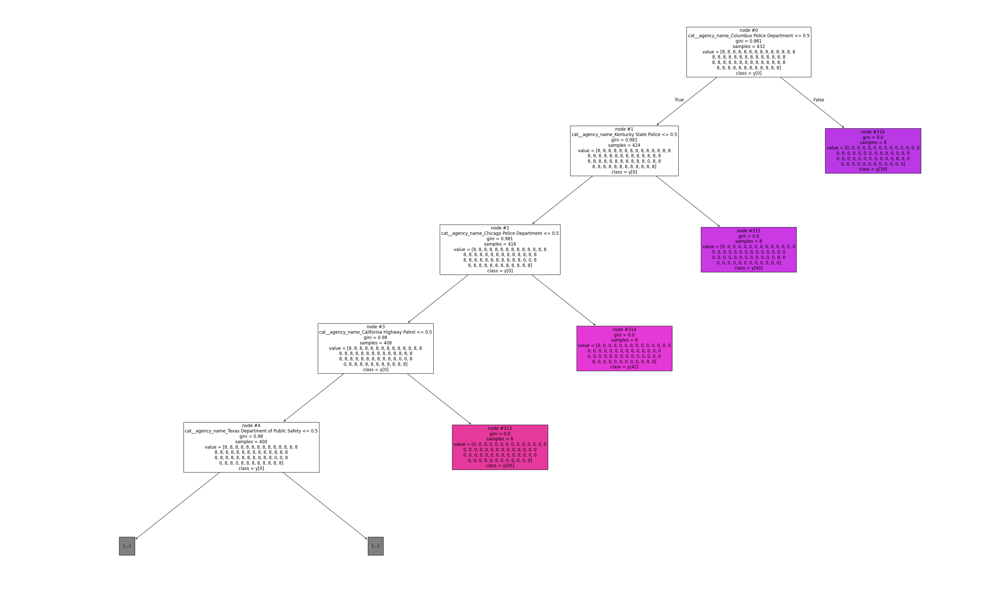

In [ ]:
from sklearn import tree

# Preparar los nombres de las variables para el plotting
features = list(feature_names)

# Realizar el árbol de decisión
plt.figure(figsize=(50,30))
tree.plot_tree(dt, max_depth=4, feature_names=features, filled=True, fontsize=12, node_ids=True, class_names=True)
plt.show()

#### **DATA ORIGINAL**

In [ ]:
dt2 = DecisionTreeClassifier(random_state=42, max_depth=3)

X_train = preprocessor.fit_transform(X_train)
X_test = preprocessor.transform(X_test)

dt2.fit(X_train, y_train)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [0, 3, 4] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


DecisionTreeClassifier(max_depth=3, random_state=42)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Mean Squared Error: 767.3343838638513
R-squared: 0.23739044828921585


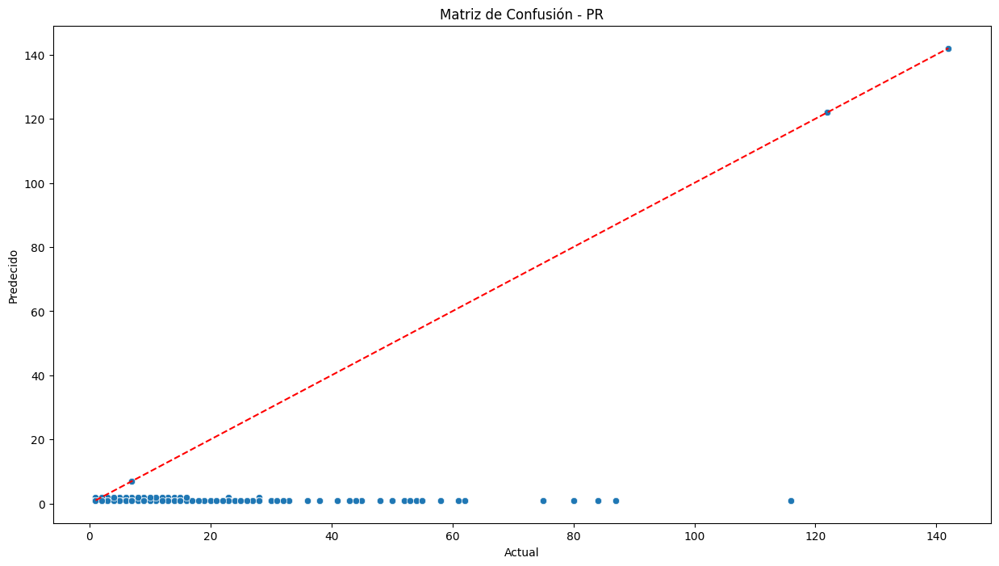

Mean Squared Error: 728.9496221662469
R-squared: 0.24983503567650323


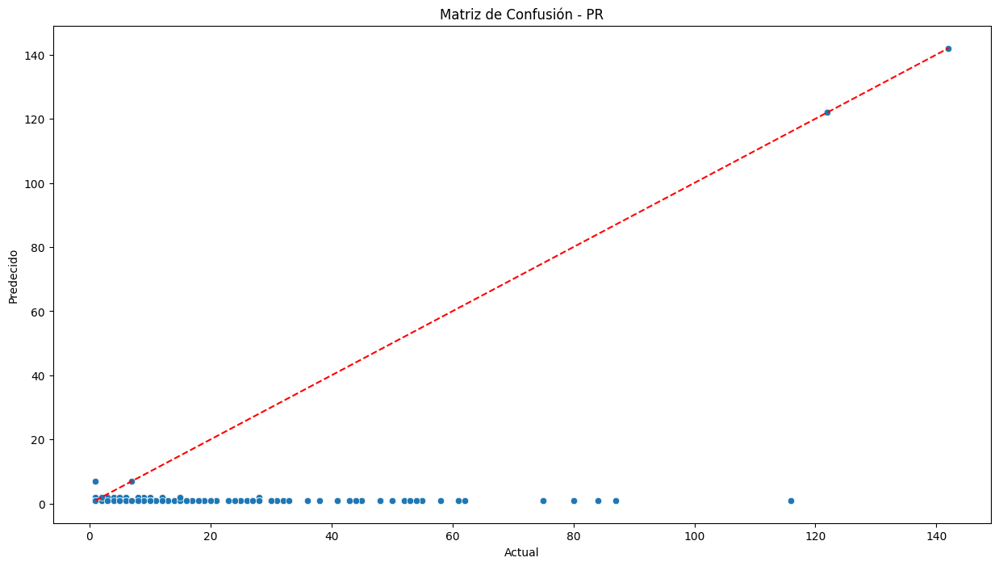

In [ ]:
# Revisión de performance en data de entrenamiento
y_train_pred_dt = dt2.predict(X_train)
metrics_score(y_train, y_train_pred_dt)

# Segunda revisión de performance en data de testeo
y_test_pred_dt = dt2.predict(X_test)
metrics_score(y_test, y_test_pred_dt)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


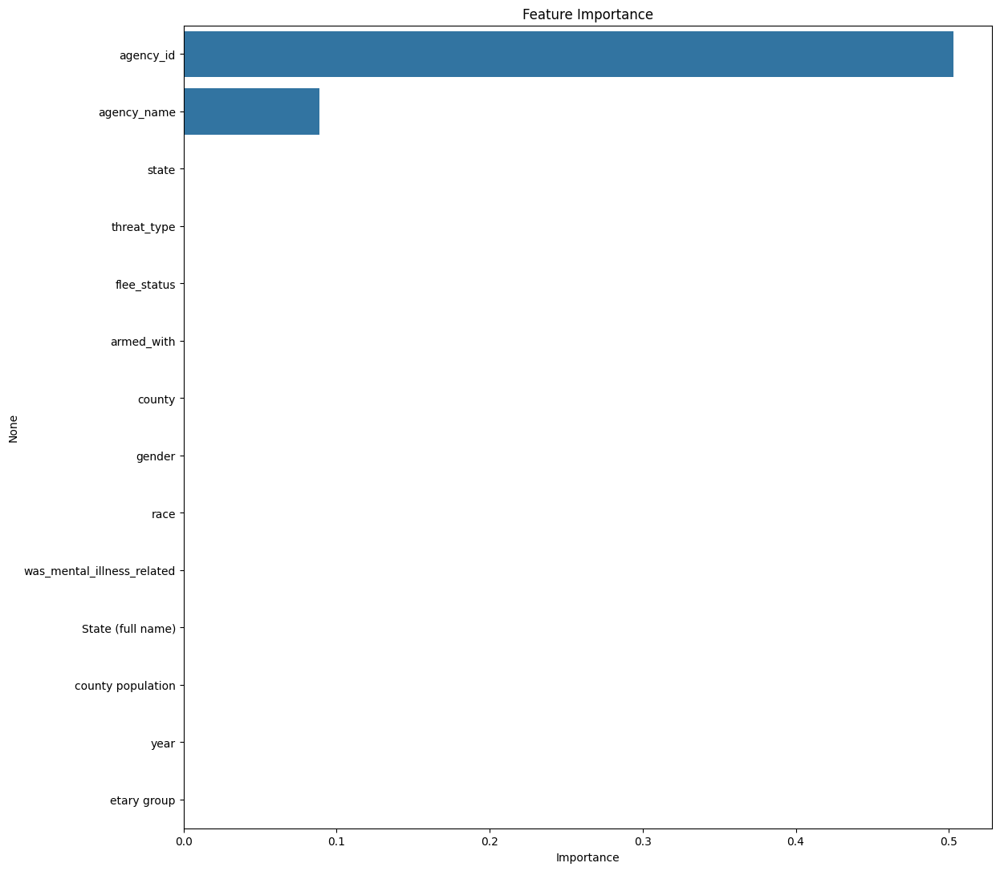

In [ ]:
# Generar árbol de decisión
importances = dt2.feature_importances_[:14]
columns = X.columns
importance_df = pd.DataFrame(importances, index = columns, columns = ['Importance']).sort_values(by = 'Importance', ascending = False)
plt.figure(figsize = (13,13))
sns.barplot(x=importance_df.Importance, y=importance_df.index)
plt.title('Feature Importance')
plt.show()

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


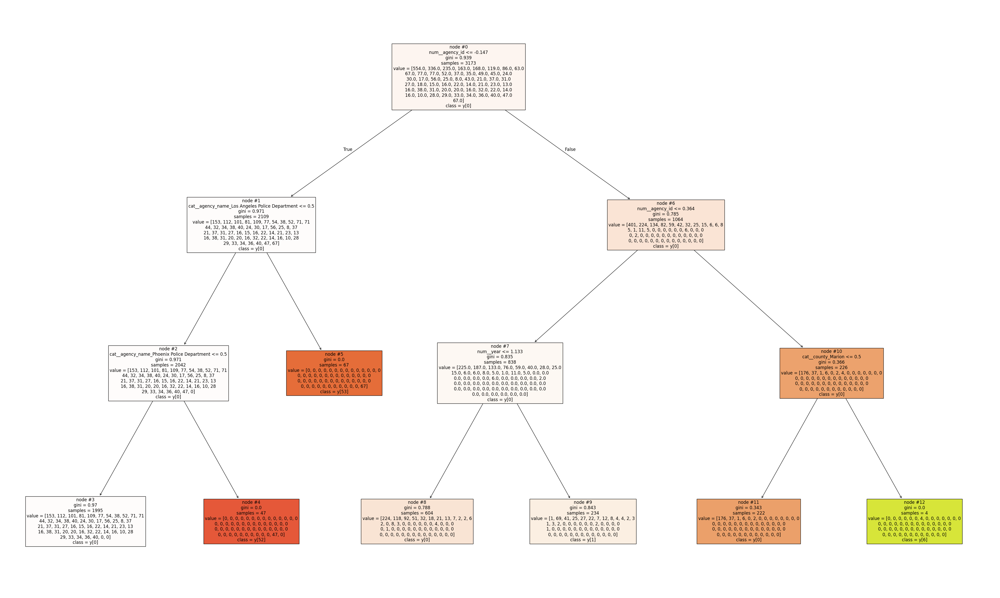

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


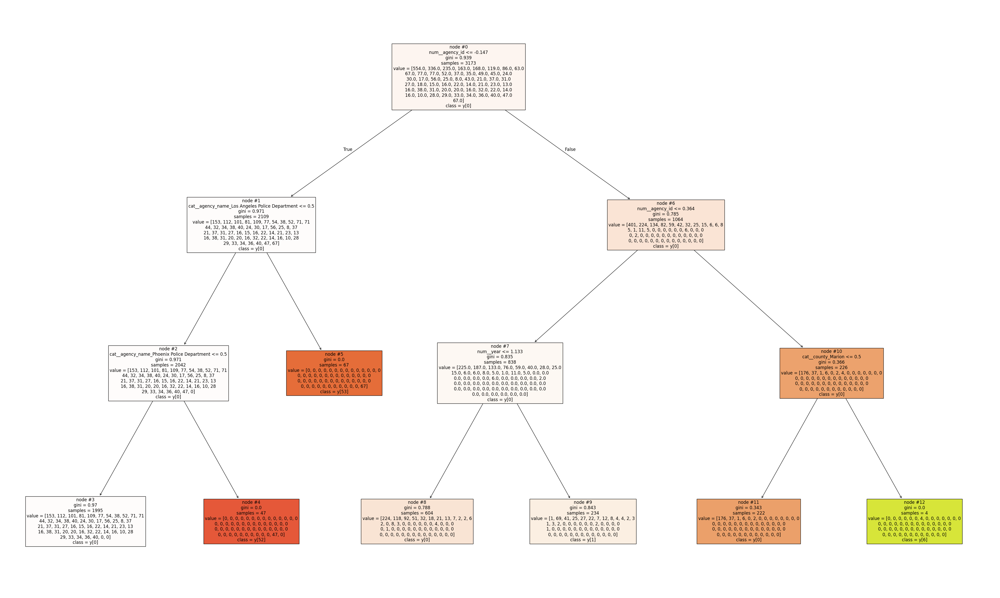

In [ ]:
# Preparar los nombre de las variables para el plotting con la data original
features = preprocessor.get_feature_names_out()

# Realizar el árbol de decisión
plt.figure(figsize=(50, 30))
tree.plot_tree(dt2, max_depth=4, feature_names=features, filled=True, fontsize=12, node_ids=True, class_names=True)
plt.show()

### **CONCLUSIONES: MODELO PREDICTIVO**
Tras realizar la matriz de confusión, que es una herramienta clave para visualizar el desempeño de un algoritmo de aprendizaje supervisado, observamos que tanto el modelo de *Random Forest* como la *Regresión de Poisson* presentan una gran precisión en la predicción de los datos. Este valor sugiere que ambos modelos tienen la capacidad de realizar predicciones correctas y precisas, algo especialmente relevante dado que la **data** ha sido balanceada mediante **undersampling**, método que ayuda a mitigar el sesgo asociado a la clase mayoritaria al reducir la cantidad de ejemplos de esta, permitiendo que el modelo se enfoque más en aprender los patrones de la clase minoritaria, que de otro modo podría ser ignorada debido a su baja representación.

Es importante recalcar que, al trabajar con datos balanceados, los resultados son más representativos de la capacidad real de los modelos para predecir ambas clases. Sin esta técnica de resampling, el modelo podría estar sesgado hacia las clases mayoritarias (como los hombres en el género, California en los estados y los blancos en la raza), dado que tendría más ejemplos para aprender, lo que podría distorsionar la evaluación.

El árbol de decisión realizado muestra cómo el modelo clasifica las instancias basándose principalmente en la variable `cat__agency_name` y filtra los datos según distintos departamentos de policía, como el **Columbus Police Department**, **Kentucky State Police**, y **Chicago Police Department**. Esto indica que el modelo considera la agencia de policía como una variable importante para predecir el resultado, y dicha variable tiene un papel significativo en las primeras etapas de decisión. Cada nodo muestra el valor de `gini`, que mide la pureza de la división en ese nodo; valores más bajos indican una mayor homogeneidad dentro de las clasificaciones resultantes. También, el valor de "samples" refleja la cantidad de instancias que se encuentran en ese nodo específico.

Los nodos terminales (en color) representan decisiones finales del modelo, donde se asignan clases específicas basadas en el filtrado progresivo de los datos. Esto permite al modelo clasificar los datos con mayor precisión según los patrones observados en los diferentes departamentos de policía, ayudando a entender qué agencias contribuyen más al comportamiento o resultado que se desea predecir. Por lo anterior, el árbol de decisión refuerza la idea de que el departamento de policía corresponde a una característica crítica en el modelo predictivo, y que su visualización ayuda a entender cómo las divisiones lógicas progresivas llevan a predicciones basadas en este tipo de variable categórica.

---
